# Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.font_manager import FontProperties
import arviz as az
import random
import sys, importlib
from PostPred import PostPred
from PostPredBivariate import PostPredBivariate
importlib.reload(sys.modules['PostPred'])
importlib.reload(sys.modules['PostPredBivariate'])

<module 'PostPredBivariate' from '/Users/beo/Desktop/Statistical Learning/Tesi/Code/tesi/Modello/PostPredBivariate.py'>

In [2]:
from cmdstanpy import CmdStanModel

In [3]:
font_properties = FontProperties(weight='bold', size=15)
plt.style.use('ggplot')
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = ['Arial'] 

# 180 - Binomial with all sensors

In [4]:
Y = pd.read_csv("../Datasets_all_sensors/Dataset_180.csv")
Y['Count_180'] = pd.to_numeric(Y['Count_180']).astype('Int64')
X = pd.read_csv("../Datasets_all_sensors/variables_to_select.csv")
X = X.drop(["Year", "Month", "Station"], axis = 1)
X = X.drop(["max_consecutive_highwind_days", "Density", "count_highwind", "Zone_A", "Zone_B", "Zone_Cities",
           "Area_S", "Area_U", "Type_T", "Quota"], axis = 1) 
# Note that the stations in Y, X and distance matrix are ordered wrt the period they start recording data

In [5]:
stations_2000_2007 = Y['idSensore'].unique()[:19]
stations_2007_2012 = Y['idSensore'].unique()[19:39] 
stations_2012_2023 = Y['idSensore'].unique()[39:51] 

# Remove from Y and X the blocks of NA between 2000-2007 and 2000-2012
rows_to_remove_2007 = Y[(Y['Year'].between(2000, 2006)) & (Y['idSensore'].isin(stations_2007_2012))].index
rows_to_remove_2012 = Y[(Y['Year'].between(2000, 2011)) & (Y['idSensore'].isin(stations_2012_2023))].index
rows_to_remove = rows_to_remove_2007.union(rows_to_remove_2012)

Y = Y.drop(rows_to_remove).reset_index(drop=True)
X = X.drop(rows_to_remove).reset_index(drop=True)

In [6]:
idx_obs = Y[Y['Count_180'].notna()].index
idx_miss = Y[Y['Count_180'].isna()].index

# take XX% of the remaining indexes for a test set
XX = 0.3 # [0, 1] change this value to change the size of the test set
random.seed(2024)

idx_test = sorted(np.random.choice(idx_obs.values, int(XX*len(idx_obs)), replace=False))
idx_miss = sorted(np.concatenate((idx_test, idx_miss.values)))
idx_obs = sorted(np.setdiff1d(idx_obs, idx_test))

Y_obs = Y.loc[idx_obs, :].reset_index(drop=True)
Y_miss = Y.loc[idx_miss, :].reset_index(drop=True)

X_obs = X.loc[idx_obs, :].reset_index(drop=True)
X_miss = X.loc[idx_miss, :].reset_index(drop=True)

In [7]:
stations = Y['idSensore']
years = pd.Series(Y['Year'] - 1999)
months = pd.Series(Y['Month'] - 3)
unique_values = list(dict.fromkeys(stations))
mapping_dict = {value: index + 1 for index, value in enumerate(unique_values)}
transformed_stations = [mapping_dict[value] for value in stations]
stations_original = pd.Series(stations)
stations = pd.Series(transformed_stations)

stations_obs = stations.loc[idx_obs].reset_index(drop=True)
stations_miss = stations.loc[idx_miss].reset_index(drop=True)
years_obs = years.loc[idx_obs].reset_index(drop=True)
years_miss = years.loc[idx_miss].reset_index(drop=True)
months_obs = months.loc[idx_obs].reset_index(drop=True)
months_miss = months.loc[idx_miss].reset_index(drop=True)

day_in_month = [31,28,31,30,31,30,31,31,30,31,30,31]
max_month = [day_in_month[Y['Month'][i]-1] for i in range(0,Y.shape[0])]
max_month = pd.Series(max_month)
max_month_obs = max_month.loc[idx_obs].reset_index(drop=True)
max_month_miss = max_month.loc[idx_miss].reset_index(drop=True)

In [8]:
phi = 66
distances = pd.read_csv("../Datasets_all_sensors/distances.csv", index_col=0)

In [9]:
data_180_all = {
    "N": len(Y_obs),
    "N_miss": len(Y_miss),

    "y": Y_obs['Count_180'],
    "P": X_obs.shape[1],

    "nyears": 24,
    "nstations": 51,
    "nmonths": 7,

    "station": stations_obs,
    "year": years_obs,
    "max_month": max_month_obs,
    "station_miss": stations_miss,
    "year_miss": years_miss,
    "max_month_miss": max_month_miss,

    "X": X_obs,
    "X_miss": X_miss,

    "phi": phi,
    "distances": distances,

    "month": months_obs,
    "month_miss": months_miss
}

In [10]:
model_all_sensors = """
data {

  int<lower=0> N; // Number of observations
  int<lower=0> N_miss; // Number of missing observations
  int<lower=0> P; // Covariate number
  int<lower=0> nyears;
  int<lower=0> nstations;
  int<lower=0> nmonths;

  array[N] int<lower=0> station;
  array[N] int<lower=0> year;
  array[N] int<lower=0> max_month;
  array[N] int<lower=0> month;

  array[N_miss] int<lower=0> station_miss;
  array[N_miss] int<lower=0> year_miss;
  array[N_miss] int<lower=0> max_month_miss;
  array[N_miss] int<lower=0> month_miss;

  array[N] int<lower=0> y; // Count data

  matrix[N, P] X; // Predictor matrix
  matrix[N_miss, P] X_miss; // Predictor matrix

  real phi;
  matrix[nstations, nstations] distances;
  
}

transformed data {

  matrix[nstations,nstations] H = exp(-(1/phi) * distances);
  
}

parameters {

  vector[P] beta; // Coefficients for predictors
  
  vector[nstations] w;
  
  vector[nyears] xi; // Random effects for years
  real mu_xi;
  
  vector[nmonths] gamma;
  real mu_gamma;
  
  real<lower = 0> sigma2;
  real<lower = 0> sigma2_xi;
  real<lower = 0> sigma2_gamma;
  
}

transformed parameters {
  
  vector[N] alpha;
  vector[N_miss] alpha_miss;

  matrix[nstations,nstations] Sigma_s = sigma2 * H; 
  matrix[nstations,nstations] Lw = cholesky_decompose(Sigma_s);

  alpha = X * beta + gamma[month] + xi[year] + w[station]; 
  alpha_miss = X_miss * beta + gamma[month_miss] + xi[year_miss] + w[station_miss];
  
}

model {

  beta ~ normal(0, 1);
  for (i in 1:N) {
    y[i] ~ binomial_logit(max_month[i], alpha[i]);
  }

  mu_xi ~ normal(0, 1);
  for (i in 1:nyears) {
    xi[i] ~ normal(mu_xi, sqrt(sigma2_xi));
  }
  mu_gamma ~ normal(0, 1);
  for (i in 1:nmonths) {
    gamma[i] ~ normal(mu_gamma, sqrt(sigma2_gamma));
  }

  w ~ multi_normal_cholesky(rep_vector(0, nstations), Lw);
  
  sigma2 ~ inv_gamma(4,2);
  sigma2_xi ~inv_gamma(4,2);
  sigma2_gamma ~ inv_gamma(4,2);
  
}

generated quantities {

  vector[N] log_lik;

  vector[N] y_pred;
  vector[N_miss] y_pred_miss;

  vector[N] theta;
  vector[N_miss] theta_miss;

  for(i in 1:N) {
    log_lik [i] = binomial_lpmf(y[i]|max_month[i], inv_logit(alpha[i]));
  }
  
  for(i in 1:N){
    theta[i] = inv_logit(alpha[i]);
    y_pred[i] = binomial_rng(max_month[i], theta[i]);
  }

  for(i in 1:N_miss){
    theta_miss[i] = inv_logit(alpha_miss[i]);
    y_pred_miss[i] = binomial_rng(max_month_miss[i], theta_miss[i]);
  }
  
}
"""

In [11]:
# Write model to file
stan_file = "./stan/binomial_all_sensors.stan"
with open(stan_file, "w") as f:
    print(model_all_sensors, file=f)

# Compile stan model
stan_model = CmdStanModel(stan_file=stan_file)

13:07:20 - cmdstanpy - INFO - compiling stan file /var/folders/h5/sljgddhd1clgfh2_bw619vb80000gn/T/tmpgghcgt98/tmpsv3s62cx.stan to exe file /Users/beo/Desktop/Statistical Learning/Tesi/Code/tesi/Modello/stan/binomial_all_sensors
13:08:39 - cmdstanpy - INFO - compiled model executable: /Users/beo/Desktop/Statistical Learning/Tesi/Code/tesi/Modello/stan/binomial_all_sensors


In [12]:
# Run the sampler
bin_logit_var_180_all_sensors = stan_model.sample(data=data_180_all, chains=4, parallel_chains=4, 
                             iter_warmup=1000, iter_sampling=1000, seed=2024)

# Convert chain to arviz format
posterior_bin_logit_var_180_all_sensors = az.from_cmdstanpy(bin_logit_var_180_all_sensors)

13:08:40 - cmdstanpy - INFO - CmdStan start processing


chain 1 |          | 00:00 Status

chain 2 |          | 00:00 Status

chain 3 |          | 00:00 Status

chain 4 |          | 00:00 Status

13:34:52 - cmdstanpy - INFO - CmdStan done processing.
13:34:52 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: cholesky_decompose: A is not symmetric. A[1,2] = inf, but A[2,1] = inf (in 'binomial_all_sensors.stan', line 61, column 2 to column 63)
Exception: cholesky_decompose: A is not symmetric. A[1,2] = inf, but A[2,1] = inf (in 'binomial_all_sensors.stan', line 61, column 2 to column 63)
Exception: cholesky_decompose: A is not symmetric. A[1,2] = inf, but A[2,1] = inf (in 'binomial_all_sensors.stan', line 61, column 2 to column 63)
Exception: cholesky_decompose: A is not symmetric. A[1,2] = inf, but A[2,1] = inf (in 'binomial_all_sensors.stan', line 61, column 2 to column 63)
Consider re-running with show_console=True if the above output is unclear!


13:34:59 - cmdstanpy - WARNING - Some chains may have failed to converge.
	Chain 1 had 19 iterations at max treedepth (1.9%)
	Chain 2 had 31 iterations at max treedepth (3.1%)
	Chain 3 had 17 iterations at max treedepth (1.7%)
	Chain 4 had 24 iterations at max treedepth (2.4%)
	Use the "diagnose()" method on the CmdStanMCMC object to see further information.


In [13]:
post_pred = PostPred(posterior_bin_logit_var_180_all_sensors, Y['Count_180'], test_train=True, idx_test=idx_test)
Y_data = post_pred.Y
post_pred.posterior_az

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats

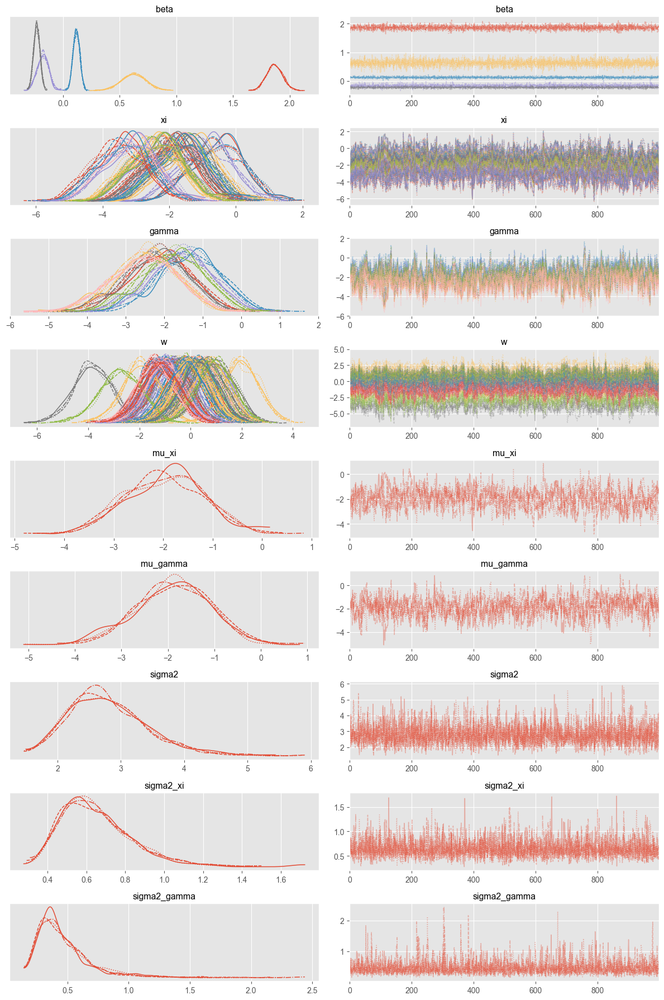

In [15]:
az.plot_trace(post_pred.posterior_az, var_names = ['beta', 'xi', 'gamma', 'w', 'mu_xi', 'mu_gamma', 'sigma2', 'sigma2_xi', 'sigma2_gamma'])
plt.tight_layout()
plt.savefig('SIS_plots/180_chain_all_sensors.pdf', bbox_inches='tight')
plt.show()

In [176]:
waic_out1 = az.waic(post_pred.posterior_az, var_name='log_lik')
loo_out1 = az.loo(post_pred.posterior_az, var_name='log_lik')
waic1 = waic_out1.elpd_waic
loo1 = loo_out1.elpd_loo
print(waic_out1)
print(loo_out1)

/usr/local/lib/python3.10/site-packages/arviz/stats/stats.py:1647: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(


Computed from 4000 posterior samples and 4126 observations log-likelihood matrix.

          Estimate       SE
elpd_waic -4800.32   105.29
p_waic      176.19        -

There has been a warning during the calculation. Please check the results.
Computed from 4000 posterior samples and 4126 observations log-likelihood matrix.

         Estimate       SE
elpd_loo -4801.22   105.33
p_loo      177.09        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.70]   (good)     4126  100.0%
   (0.70, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%



In [177]:
alpha = 0.05
y_pred, metrics = post_pred.predict(CI=True,
                                       alpha = alpha,
                                       error_metrics = True)
y_obs, residuals, mse, mae, mad, rmse, mse_test, mae_test, mad_test, rmse_test, outliers_test, percentage_inside_CI_test, outliers, percentage_inside = metrics.values()
print(f'The total number of outliers is: {len(outliers)}\n')
print(f'The total number of outliers in the test set is: {len(outliers_test)}\n')
print(f'The MSE is: {mse}\n')
print(f'The MAE is: {mae}\n')
print(f'The MAD is: {mad}\n')
print(f'The RMSE is: {rmse}\n')

print(f'The MSE in the test set is: {mse_test}\n')
print(f'The MAE in the test set is: {mae_test}\n')
print(f'The MAD in the test set is: {mad_test}\n')
print(f'The RMSE in the test set is: {rmse_test}\n')

print(f'The percentage of observations inside the CI is: {percentage_inside}\n')
print(f'The percentage of observations inside the CI of the test is: {percentage_inside_CI_test}\n')

The total number of outliers is: 264

The total number of outliers in the test set is: 91

The MSE is: 2.8660699134566436

The MAE is: 0.8380281690140845

The MAD is: 0.0

The RMSE is: 1.6929471088774874

The MSE in the test set is: 3.268251273344652

The MAE in the test set is: 0.8607809847198642

The MAD in the test set is: 0.0

The RMSE in the test set is: 1.8078305433155653

The percentage of observations inside the CI is: 0.955201086034278

The percentage of observations inside the CI of the test is: 0.9485002829654782



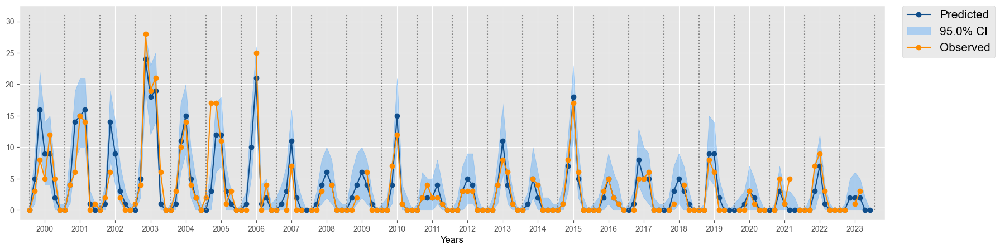

In [178]:
station_num_to_plot = 1 # Change this to plot a different station, -1 to plot manually
if station_num_to_plot != -1:
    xx = np.arange(24*7*(station_num_to_plot-1), 24*7*station_num_to_plot)
else:
    xx = np.arange(1000, 1200) # Change this for the range of the manual choice
plt.figure(figsize=(20, 5))
plt.plot(xx, y_pred.loc[xx, 'pred'], label='Predicted', linestyle='-', marker='o', color='#104E8B')
plt.fill_between(xx, y_pred.loc[xx, f'{alpha/2}'], y_pred.loc[xx, f'{(1-alpha/2)}'], alpha=0.3, label=f'{(1-alpha)*100}% CI', color='#1E90FF')
plt.plot(xx, Y_data[xx], label='Observed', linestyle='-', marker='o', color='#FF8C00')
plt.xticks(xx[np.arange(3,len(xx),7)], np.arange(2000,2024), fontsize=10)
plt.yticks(fontsize=10)
plt.xlim(xx[0]-2, xx[-1]+3)
plt.xlabel('Years', fontsize='12', color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.vlines(xx[np.arange(0,len(xx),7)], ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.vlines(xx[-1]+1, ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.savefig('SIS_plots/180_all_sensors_1.pdf', bbox_inches='tight')
plt.show()

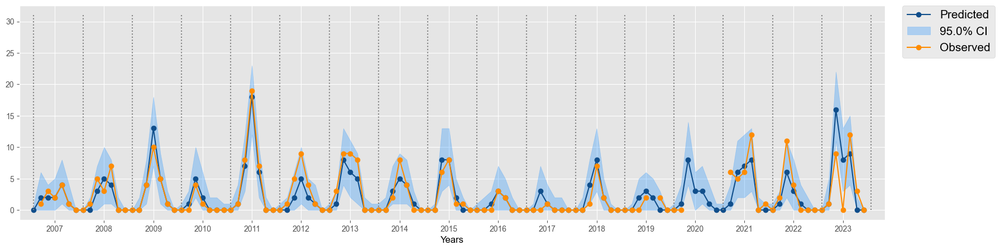

In [179]:
station_num_to_plot = 20 # Change this to plot a different station, -1 to plot manually
if station_num_to_plot != -1:
    xx = np.arange(17*7*(station_num_to_plot-1), 17*7*station_num_to_plot)
else:
    xx = np.arange(1000, 1200) # Change this for the range of the manual choice
plt.figure(figsize=(20, 5))
plt.plot(xx, y_pred.loc[xx, 'pred'], label='Predicted', linestyle='-', marker='o', color='#104E8B')
plt.fill_between(xx, y_pred.loc[xx, f'{alpha/2}'], y_pred.loc[xx, f'{(1-alpha/2)}'], alpha=0.3, label=f'{(1-alpha)*100}% CI', color='#1E90FF')
plt.plot(xx, Y_data[xx], label='Observed', linestyle='-', marker='o', color='#FF8C00')
plt.xticks(xx[np.arange(3,len(xx),7)], np.arange(2007,2024), fontsize=10)
plt.yticks(fontsize=10)
plt.xlim(xx[0]-2, xx[-1]+3)
plt.xlabel('Years', fontsize='12', color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.vlines(xx[np.arange(0,len(xx),7)], ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.vlines(xx[-1]+1, ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.savefig('SIS_plots/180_all_sensors_2.pdf', bbox_inches='tight')
plt.show()

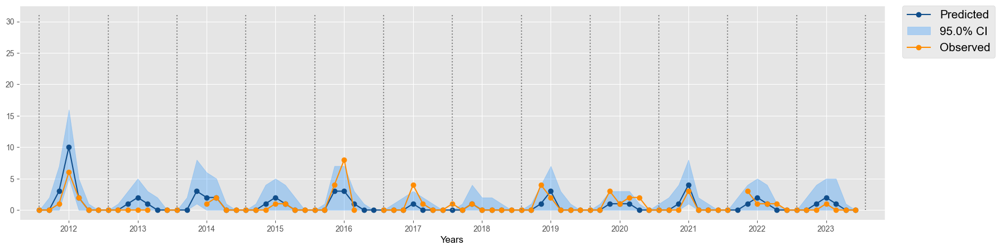

In [180]:
station_num_to_plot = 51 # Change this to plot a different station, -1 to plot manually
if station_num_to_plot != -1:
    xx = np.arange(12*7*(station_num_to_plot-1), 12*7*station_num_to_plot)
else:
    xx = np.arange(1000, 1200) # Change this for the range of the manual choice
plt.figure(figsize=(20, 5))
plt.plot(xx, y_pred.loc[xx, 'pred'], label='Predicted', linestyle='-', marker='o', color='#104E8B')
plt.fill_between(xx, y_pred.loc[xx, f'{alpha/2}'], y_pred.loc[xx, f'{(1-alpha/2)}'], alpha=0.3, label=f'{(1-alpha)*100}% CI', color='#1E90FF')
plt.plot(xx, Y_data[xx], label='Observed', linestyle='-', marker='o', color='#FF8C00')
plt.xticks(xx[np.arange(3,len(xx),7)], np.arange(2012,2024), fontsize=10)
plt.yticks(fontsize=10)
plt.xlim(xx[0]-2, xx[-1]+3)
plt.xlabel('Years', fontsize='12', color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.vlines(xx[np.arange(0,len(xx),7)], ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.vlines(xx[-1]+1, ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.savefig('SIS_plots/180_all_sensors_3.pdf', bbox_inches='tight')
plt.show()

# 120 - Binomial with all sensors

In [16]:
Y = pd.read_csv("../Datasets_all_sensors/Dataset_120.csv")
Y['Count_120'] = pd.to_numeric(Y['Count_120']).astype('Int64')
X = pd.read_csv("../Datasets_all_sensors/variables_to_select.csv")
X = X.drop(["Year", "Month", "Station"], axis = 1)
X = X.drop(["max_consecutive_highwind_days", "Density", "count_highwind", "Zone_A", "Zone_B", "Zone_Cities",
           "Area_S", "Area_U", "Type_T", "Quota"], axis = 1) 
# Note that the stations in Y, X and distance matrix are ordered wrt the period they start recording data

In [17]:
stations_2000_2007 = Y['idSensore'].unique()[:19]
stations_2007_2012 = Y['idSensore'].unique()[19:39] 
stations_2012_2023 = Y['idSensore'].unique()[39:51] 

# Remove from Y and X the blocks of NA between 2000-2007 and 2000-2012
rows_to_remove_2007 = Y[(Y['Year'].between(2000, 2006)) & (Y['idSensore'].isin(stations_2007_2012))].index
rows_to_remove_2012 = Y[(Y['Year'].between(2000, 2011)) & (Y['idSensore'].isin(stations_2012_2023))].index
rows_to_remove = rows_to_remove_2007.union(rows_to_remove_2012)

Y = Y.drop(rows_to_remove).reset_index(drop=True)
X = X.drop(rows_to_remove).reset_index(drop=True)

In [18]:
idx_obs = Y[Y['Count_120'].notna()].index
idx_miss = Y[Y['Count_120'].isna()].index

# take XX% of the remaining indexes for a test set
XX = 0.3 # [0, 1] change this value to change the size of the test set
random.seed(2024)

idx_test = sorted(np.random.choice(idx_obs.values, int(XX*len(idx_obs)), replace=False))
idx_miss = sorted(np.concatenate((idx_test, idx_miss.values)))
idx_obs = sorted(np.setdiff1d(idx_obs, idx_test))

Y_obs = Y.loc[idx_obs, :].reset_index(drop=True)
Y_miss = Y.loc[idx_miss, :].reset_index(drop=True)

X_obs = X.loc[idx_obs, :].reset_index(drop=True)
X_miss = X.loc[idx_miss, :].reset_index(drop=True)

In [19]:
stations = Y['idSensore']
years = pd.Series(Y['Year'] - 1999)
months = pd.Series(Y['Month'] - 3)
unique_values = list(dict.fromkeys(stations))
mapping_dict = {value: index + 1 for index, value in enumerate(unique_values)}
transformed_stations = [mapping_dict[value] for value in stations]
stations_original = pd.Series(stations)
stations = pd.Series(transformed_stations)

stations_obs = stations.loc[idx_obs].reset_index(drop=True)
stations_miss = stations.loc[idx_miss].reset_index(drop=True)
years_obs = years.loc[idx_obs].reset_index(drop=True)
years_miss = years.loc[idx_miss].reset_index(drop=True)
months_obs = months.loc[idx_obs].reset_index(drop=True)
months_miss = months.loc[idx_miss].reset_index(drop=True)

day_in_month = [31,28,31,30,31,30,31,31,30,31,30,31]
max_month = [day_in_month[Y['Month'][i]-1] for i in range(0,Y.shape[0]) ]
max_month = pd.Series(max_month)
max_month_obs = max_month.loc[idx_obs].reset_index(drop=True)
max_month_miss = max_month.loc[idx_miss].reset_index(drop=True)

In [20]:
phi = 66
distances = pd.read_csv("../Datasets_all_sensors/distances.csv", index_col=0)

In [21]:
data_120_all = {
    "N": len(Y_obs),
    "N_miss": len(Y_miss),

    "y": Y_obs['Count_120'],
    "P": X_obs.shape[1],

    "nyears": 24,
    "nstations": 51,
    "nmonths": 7,

    "station": stations_obs,
    "year": years_obs,
    "max_month": max_month_obs,
    "station_miss": stations_miss,
    "year_miss": years_miss,
    "max_month_miss": max_month_miss,

    "X": X_obs,
    "X_miss": X_miss,

    "phi": phi,
    "distances": distances,

    "month": months_obs,
    "month_miss": months_miss
}

In [22]:
model_all_sensors = """
data {

  int<lower=0> N; // Number of observations
  int<lower=0> N_miss; // Number of missing observations
  int<lower=0> P; // Covariate number
  int<lower=0> nyears;
  int<lower=0> nstations;
  int<lower=0> nmonths;

  array[N] int<lower=0> station;
  array[N] int<lower=0> year;
  array[N] int<lower=0> max_month;
  array[N] int<lower=0> month;

  array[N_miss] int<lower=0> station_miss;
  array[N_miss] int<lower=0> year_miss;
  array[N_miss] int<lower=0> max_month_miss;
  array[N_miss] int<lower=0> month_miss;

  array[N] int<lower=0> y; // Count data

  matrix[N, P] X; // Predictor matrix
  matrix[N_miss, P] X_miss; // Predictor matrix

  real phi;
  matrix[nstations, nstations] distances;
  
}

transformed data {

  matrix[nstations,nstations] H = exp(-(1/phi) * distances);
  
}

parameters {

  vector[P] beta; // Coefficients for predictors
  
  vector[nstations] w;
  
  vector[nyears] xi; // Random effects for years
  real mu_xi;
  
  vector[nmonths] gamma;
  real mu_gamma;
  
  real<lower = 0> sigma2;
  real<lower = 0> sigma2_xi;
  real<lower = 0> sigma2_gamma;
  
}

transformed parameters {

  vector[N] alpha;
  vector[N] fix_eff;
  vector[N] intercept;

  vector[N_miss] alpha_miss;
  vector[N_miss] fix_eff_miss;
  vector[N_miss] intercept_miss;

  matrix[nstations,nstations] Sigma_s = sigma2 * H; 
  matrix[nstations,nstations] Lw = cholesky_decompose(Sigma_s);

  alpha = X * beta + gamma[month] + xi[year] + w[station]; 
  alpha_miss = X_miss * beta + gamma[month_miss] + xi[year_miss] + w[station_miss];
  
}

model {

  beta ~ normal(0, 1);
  for (i in 1:N) {
    y[i] ~ binomial_logit(max_month[i], alpha[i]);
  }

  mu_xi ~ normal(0, 1);
  for (i in 1:nyears) {
    xi[i] ~ normal(mu_xi, sqrt(sigma2_xi));
  }
  mu_gamma ~ normal(0, 1);
  for (i in 1:nmonths) {
    gamma[i] ~ normal(mu_gamma, sqrt(sigma2_gamma));
  }

  w ~ multi_normal_cholesky(rep_vector(0, nstations), Lw);
  
  sigma2 ~ inv_gamma(4,2);
  sigma2_xi ~inv_gamma(4,2);
  sigma2_gamma ~ inv_gamma(4,2);
  
}

generated quantities {

  vector[N] log_lik;

  vector[N] y_pred;
  vector[N_miss] y_pred_miss;

  vector[N] theta;
  vector[N_miss] theta_miss;

  for(i in 1:N) {
    log_lik [i] = binomial_lpmf(y[i]|max_month[i], inv_logit(alpha[i]));
  }
  
  for(i in 1:N){
    theta[i] = inv_logit(alpha[i]);
    y_pred[i] = binomial_rng(max_month[i], theta[i]);
  }

  for(i in 1:N_miss){
    theta_miss[i] = inv_logit(alpha_miss[i]);
    y_pred_miss[i] = binomial_rng(max_month_miss[i], theta_miss[i]);
  }
  
}
"""

In [23]:
# Write model to file
stan_file = "./stan/binomial_all_sensors.stan"
with open(stan_file, "w") as f:
    print(model_all_sensors, file=f)

# Compile stan model
stan_model = CmdStanModel(stan_file=stan_file)

14:11:25 - cmdstanpy - INFO - compiling stan file /var/folders/h5/sljgddhd1clgfh2_bw619vb80000gn/T/tmp57we4546/tmpsj4u3ge1.stan to exe file /Users/beo/Desktop/Statistical Learning/Tesi/Code/tesi/Modello/stan/binomial_all_sensors
14:13:36 - cmdstanpy - INFO - compiled model executable: /Users/beo/Desktop/Statistical Learning/Tesi/Code/tesi/Modello/stan/binomial_all_sensors


In [24]:
# Run the sampler
bin_logit_var_120_all_sensors = stan_model.sample(data=data_120_all, chains=4, parallel_chains=4, 
                             iter_warmup=1000, iter_sampling=1000, seed=2024)

# Convert chain to arviz format
posterior_bin_logit_var_120_all_sensors = az.from_cmdstanpy(bin_logit_var_120_all_sensors)

14:13:37 - cmdstanpy - INFO - CmdStan start processing


chain 1 |          | 00:00 Status

chain 2 |          | 00:00 Status

chain 3 |          | 00:00 Status

chain 4 |          | 00:00 Status

14:37:39 - cmdstanpy - INFO - CmdStan done processing.
14:37:39 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: cholesky_decompose: A is not symmetric. A[1,2] = inf, but A[2,1] = inf (in 'binomial_all_sensors.stan', line 66, column 2 to column 63)
Exception: cholesky_decompose: A is not symmetric. A[1,2] = inf, but A[2,1] = inf (in 'binomial_all_sensors.stan', line 66, column 2 to column 63)
Exception: cholesky_decompose: A is not symmetric. A[1,2] = inf, but A[2,1] = inf (in 'binomial_all_sensors.stan', line 66, column 2 to column 63)
Exception: cholesky_decompose: A is not symmetric. A[1,2] = inf, but A[2,1] = inf (in 'binomial_all_sensors.stan', line 66, column 2 to column 63)
Consider re-running with show_console=True if the above output is unclear!


14:37:49 - cmdstanpy - WARNING - Some chains may have failed to converge.
	Chain 1 had 26 iterations at max treedepth (2.6%)
	Chain 2 had 12 iterations at max treedepth (1.2%)
	Chain 3 had 32 iterations at max treedepth (3.2%)
	Chain 4 had 63 iterations at max treedepth (6.3%)
	Use the "diagnose()" method on the CmdStanMCMC object to see further information.


In [25]:
post_pred = PostPred(posterior_bin_logit_var_120_all_sensors, Y['Count_120'], test_train=True, idx_test=idx_test)
Y_data = post_pred.Y
post_pred.posterior_az

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats

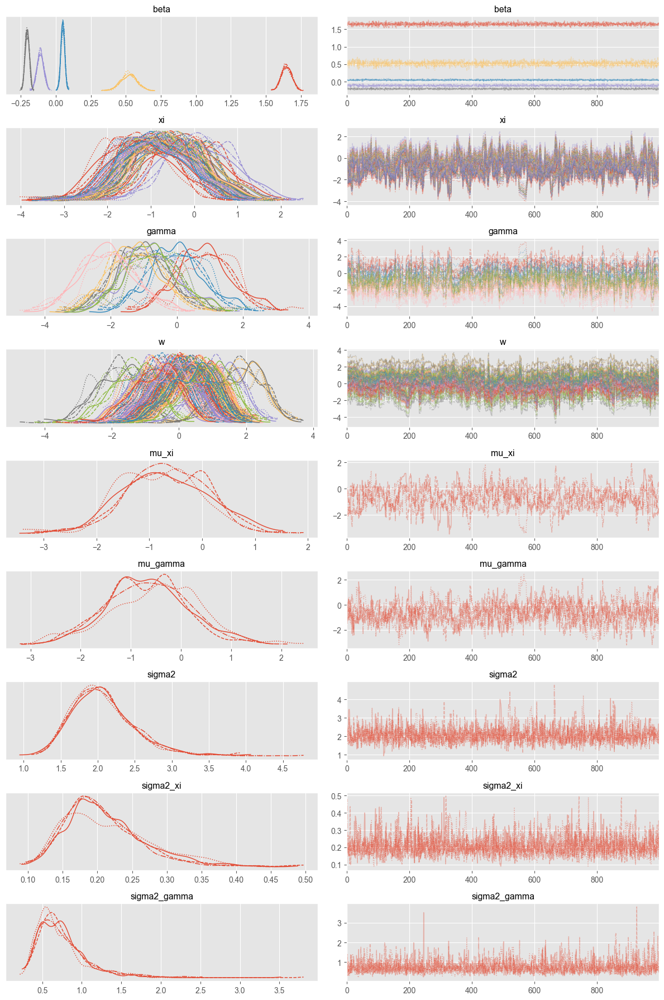

In [26]:
az.plot_trace(post_pred.posterior_az, var_names = ['beta', 'xi', 'gamma', 'w', 'mu_xi', 'mu_gamma', 'sigma2', 'sigma2_xi', 'sigma2_gamma'])
plt.tight_layout()
plt.savefig('SIS_plots/120_chain_all_sensors.pdf', bbox_inches='tight')
plt.show()

In [31]:
waic_out = az.waic(post_pred.posterior_az, var_name='log_lik')
loo_out = az.loo(post_pred.posterior_az, var_name='log_lik')
waic = waic_out.elpd_waic
loo = loo_out.elpd_loo
print(waic_out)
print(loo_out)

/usr/local/lib/python3.10/site-packages/arviz/stats/stats.py:1647: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(
arviz - WARNING - Array contains NaN-value.


Computed from 4000 posterior samples and 4202 observations log-likelihood matrix.

          Estimate       SE
elpd_waic -11840.46   177.01
p_waic      267.96        -

There has been a warning during the calculation. Please check the results.
Computed from 4000 posterior samples and 4202 observations log-likelihood matrix.

         Estimate       SE
elpd_loo -11841.04   177.03
p_loo      268.54        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.70]   (good)     4202  100.0%
   (0.70, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%



In [32]:
alpha = 0.05
y_pred, metrics = post_pred.predict(CI=True,
                                       alpha = alpha,
                                       error_metrics = True)
y_obs, residuals, mse, mae, mad, rmse, mse_test, mae_test, mad_test, rmse_test, outliers_test, percentage_inside_CI_test, outliers, percentage_inside = metrics.values()
print(f'The total number of outliers is: {len(outliers)}\n')
print(f'The total number of outliers in the test set is: {len(outliers_test)}\n')
print(f'The MSE is: {mse}\n')
print(f'The MAE is: {mae}\n')
print(f'The MAD is: {mad}\n')
print(f'The RMSE is: {rmse}\n')

print(f'The MSE in the test set is: {mse_test}\n')
print(f'The MAE in the test set is: {mae_test}\n')
print(f'The MAD in the test set is: {mad_test}\n')
print(f'The RMSE in the test set is: {rmse_test}\n')

print(f'The percentage of observations inside the CI is: {percentage_inside}\n')
print(f'The percentage of observations inside the CI of the test is: {percentage_inside_CI_test}\n')

The total number of outliers is: 929

The total number of outliers in the test set is: 288

The MSE is: 13.918402199266911

The MAE is: 2.6098800399866713

The MAD is: 2.0

The RMSE is: 3.7307374873162695

The MSE in the test set is: 13.611944444444445

The MAE in the test set is: 2.6205555555555557

The MAD in the test set is: 2.0

The RMSE in the test set is: 3.689436873622375

The percentage of observations inside the CI is: 0.8452182605798068

The percentage of observations inside the CI of the test is: 0.84



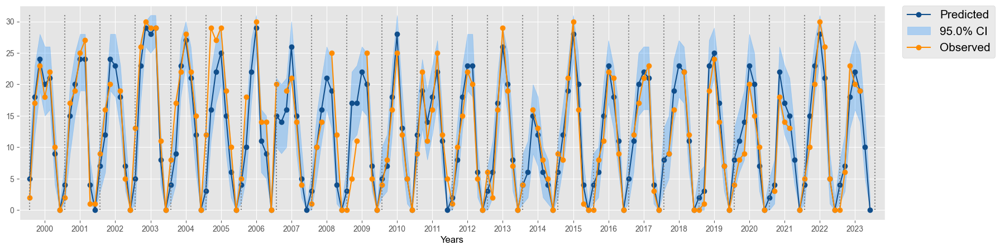

In [33]:
station_num_to_plot = 1 # Change this to plot a different station, -1 to plot manually
if station_num_to_plot != -1:
    xx = np.arange(24*7*(station_num_to_plot-1), 24*7*station_num_to_plot)
else:
    xx = np.arange(1000, 1200) # Change this for the range of the manual choice
plt.figure(figsize=(20, 5))
plt.plot(xx, y_pred.loc[xx, 'pred'], label='Predicted', linestyle='-', marker='o', color='#104E8B')
plt.fill_between(xx, y_pred.loc[xx, f'{alpha/2}'], y_pred.loc[xx, f'{(1-alpha/2)}'], alpha=0.3, label=f'{(1-alpha)*100}% CI', color='#1E90FF')
plt.plot(xx, Y_data[xx], label='Observed', linestyle='-', marker='o', color='#FF8C00')
plt.xticks(xx[np.arange(3,len(xx),7)], np.arange(2000,2024), fontsize=10)
plt.yticks(fontsize=10)
plt.xlim(xx[0]-2, xx[-1]+3)
plt.xlabel('Years', fontsize='12', color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.vlines(xx[np.arange(0,len(xx),7)], ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.vlines(xx[-1]+1, ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.savefig('SIS_plots/120_all_sensors_1.pdf', bbox_inches='tight')
plt.show()

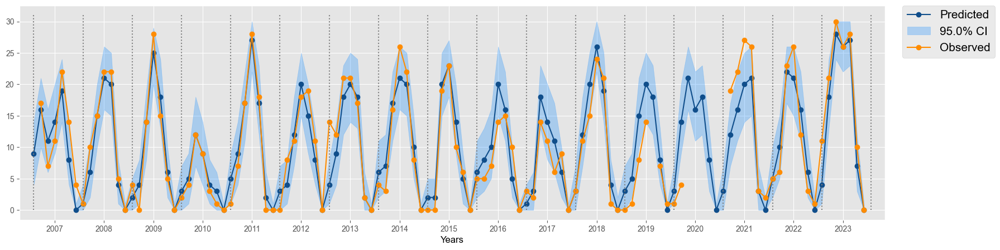

In [34]:
station_num_to_plot = 20 # Change this to plot a different station, -1 to plot manually
if station_num_to_plot != -1:
    xx = np.arange(17*7*(station_num_to_plot-1), 17*7*station_num_to_plot)
else:
    xx = np.arange(1000, 1200) # Change this for the range of the manual choice
plt.figure(figsize=(20, 5))
plt.plot(xx, y_pred.loc[xx, 'pred'], label='Predicted', linestyle='-', marker='o', color='#104E8B')
plt.fill_between(xx, y_pred.loc[xx, f'{alpha/2}'], y_pred.loc[xx, f'{(1-alpha/2)}'], alpha=0.3, label=f'{(1-alpha)*100}% CI', color='#1E90FF')
plt.plot(xx, Y_data[xx], label='Observed', linestyle='-', marker='o', color='#FF8C00')
plt.xticks(xx[np.arange(3,len(xx),7)], np.arange(2007,2024), fontsize=10)
plt.yticks(fontsize=10)
plt.xlim(xx[0]-2, xx[-1]+3)
plt.xlabel('Years', fontsize='12', color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.vlines(xx[np.arange(0,len(xx),7)], ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.vlines(xx[-1]+1, ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.savefig('SIS_plots/120_all_sensors_2.pdf', bbox_inches='tight')
plt.show()

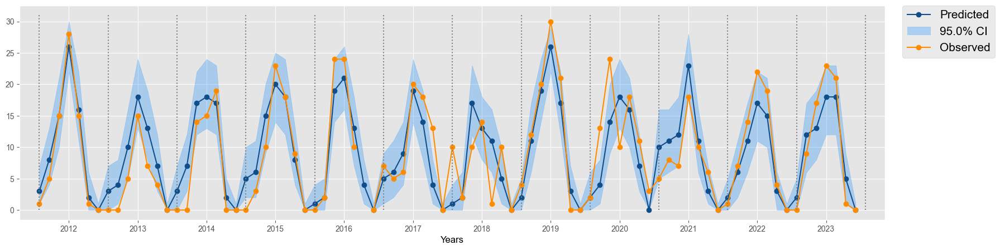

In [35]:
station_num_to_plot = 51 # Change this to plot a different station, -1 to plot manually
if station_num_to_plot != -1:
    xx = np.arange(12*7*(station_num_to_plot-1), 12*7*station_num_to_plot)
else:
    xx = np.arange(1000, 1200) # Change this for the range of the manual choice
plt.figure(figsize=(20, 5))
plt.plot(xx, y_pred.loc[xx, 'pred'], label='Predicted', linestyle='-', marker='o', color='#104E8B')
plt.fill_between(xx, y_pred.loc[xx, f'{alpha/2}'], y_pred.loc[xx, f'{(1-alpha/2)}'], alpha=0.3, label=f'{(1-alpha)*100}% CI', color='#1E90FF')
plt.plot(xx, Y_data[xx], label='Observed', linestyle='-', marker='o', color='#FF8C00')
plt.xticks(xx[np.arange(3,len(xx),7)], np.arange(2012,2024), fontsize=10)
plt.yticks(fontsize=10)
plt.xlim(xx[0]-2, xx[-1]+3)
plt.xlabel('Years', fontsize='12', color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.vlines(xx[np.arange(0,len(xx),7)], ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.vlines(xx[-1]+1, ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.savefig('SIS_plots/120_all_sensors_3.pdf', bbox_inches='tight')
plt.show()

# 180 & 120 - Comparison of parameters

In [22]:
nicer_names = {
    'mean_temperature': 'Temperature',
    'mean_precipitation_sum': 'Precipitation Tot',
    'mean_precipitation_hours': 'Precipitation Hours',
    'mean_windspeed_10m_max': 'Wind Speed',
    'mean_radiation_sum': 'Solar Radiation',
}

In [23]:
covariates_or = ["mean_temperature", "mean_precipitation_sum", "mean_precipitation_hours", "mean_windspeed_10m_max", "mean_radiation_sum"]
covariates_idx = [X.columns.get_loc(cov) for cov in covariates_or]
betas_180 = posterior_bin_logit_var_180_all_sensors.posterior['beta'].stack(sample=("chain", "draw"))
betas_120 = posterior_bin_logit_var_120_all_sensors.posterior['beta'].stack(sample=("chain", "draw"))
betas_180 = betas_180[covariates_idx]
betas_120 = betas_120[covariates_idx]
covariates = [nicer_names[cov] for cov in covariates_or]

In [24]:
covariates = covariates[::-1]
betas_180 = betas_180[::-1]
betas_120 = betas_120[::-1]

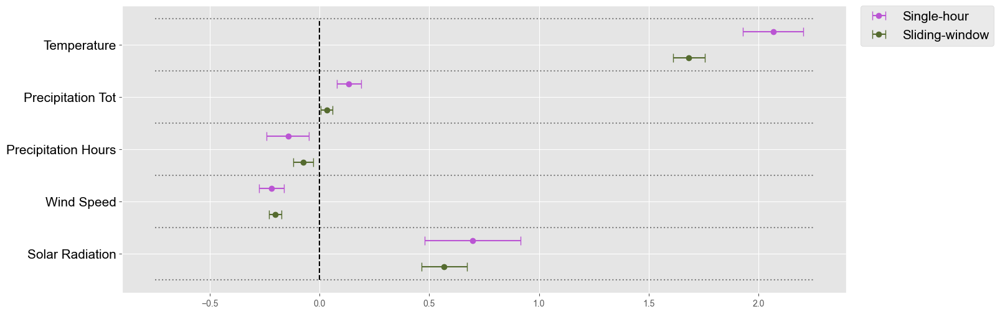

In [25]:
plt.figure(figsize=(15, 6))
plt.errorbar(betas_180.median(dim='sample'), np.arange(2, len(covariates)*4 - 1, 4), 
             xerr=[betas_180.median(dim='sample') - betas_180.quantile(0.025, dim='sample'), betas_180.quantile(0.975, dim='sample') - betas_180.median(dim='sample')], 
             fmt='o', label='Single-hour', capsize=5, color='#BA55D3')
plt.errorbar(betas_120.median(dim='sample'), np.arange(0, len(covariates)*4 - 3, 4), 
             xerr=[betas_120.median(dim='sample') - betas_120.quantile(0.025, dim='sample'), betas_120.quantile(0.975, dim='sample') - betas_120.median(dim='sample')], 
             fmt='o', label='Sliding-window', capsize=5, color='#556B2F')
plt.yticks(np.arange(1, len(covariates)*4 - 2, 4), covariates, fontsize=15, color='black')
plt.xticks(fontsize=10)
plt.hlines(np.arange(-1, len(covariates)*4, 4), xmin=-0.75, xmax=2.25, colors='gray', linestyles='dotted')
plt.vlines(0, ymin=-1, ymax=len(covariates)*4-1, colors='black', linestyles='--')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.savefig('SIS_plots/beta_CI_all_sensors.pdf', bbox_inches='tight')
plt.show()

In [26]:
xi_180 = posterior_bin_logit_var_180_all_sensors.posterior['xi'].stack(sample=("chain", "draw"))
xi_120 = posterior_bin_logit_var_120_all_sensors.posterior['xi'].stack(sample=("chain", "draw"))
years_plot = np.arange(2000, 2024)

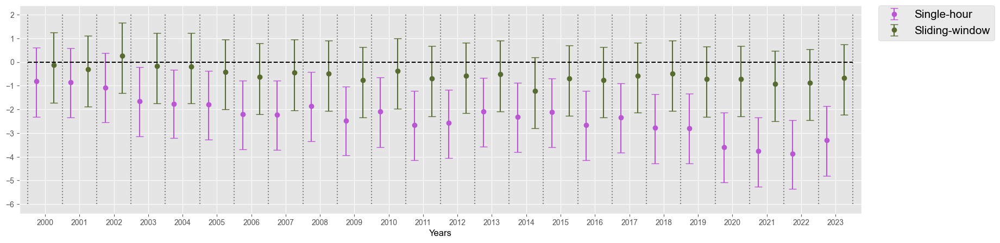

In [27]:
plt.figure(figsize=(20, 5))
plt.errorbar(np.arange(0, len(years_plot)*4 - 3, 4), xi_180.median(dim='sample'), 
             yerr=[xi_180.median(dim='sample') - xi_180.quantile(0.025, dim='sample'), xi_180.quantile(0.975, dim='sample') - xi_180.median(dim='sample')], 
             fmt='o', label='Single-hour', capsize=5, color='#BA55D3')
plt.errorbar(np.arange(2, len(years_plot)*4 - 1, 4), xi_120.median(dim='sample'), 
             yerr=[xi_120.median(dim='sample') - xi_120.quantile(0.025, dim='sample'), xi_120.quantile(0.975, dim='sample') - xi_120.median(dim='sample')], 
             fmt='o', label='Sliding-window', capsize=5, color='#556B2F')
plt.xticks(np.arange(1, len(years_plot)*4 - 2, 4), years_plot, fontsize=10)
plt.yticks(fontsize=10)
plt.vlines(np.arange(-1, len(years_plot)*4, 4), ymin=-6, ymax=2, colors='gray', linestyles='dotted')
plt.hlines(0, xmin=-1, xmax=len(years_plot)*4-1, colors='black', linestyles='--')
plt.xlim(-2, len(years_plot)*4)
plt.xlabel('Years', fontsize=12, color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.savefig('SIS_plots/xi_CI_all_sensors.pdf', bbox_inches='tight')
plt.show()

In [28]:
gamma_180 = posterior_bin_logit_var_180_all_sensors.posterior['gamma'].stack(sample=("chain", "draw"))
gamma_120 = posterior_bin_logit_var_120_all_sensors.posterior['gamma'].stack(sample=("chain", "draw"))
months_plot = np.arange(1, 8)
months = ['April', 'May', 'June', 'July', 'August', 'September', 'October']

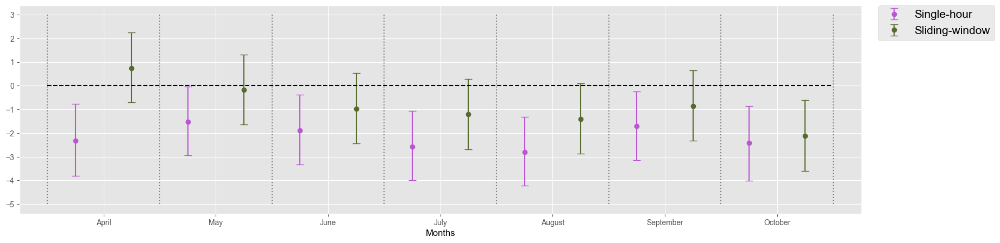

In [32]:
plt.figure(figsize=(20, 5))
plt.errorbar(np.arange(0, len(months_plot)*4 - 3, 4), gamma_180.median(dim='sample'), 
             yerr=[gamma_180.median(dim='sample') - gamma_180.quantile(0.025, dim='sample'), gamma_180.quantile(0.975, dim='sample') - gamma_180.median(dim='sample')], 
             fmt='o', label='Single-hour', capsize=5, color='#BA55D3')
plt.errorbar(np.arange(2, len(months_plot)*4 - 1, 4), gamma_120.median(dim='sample'), 
             yerr=[gamma_120.median(dim='sample') - gamma_120.quantile(0.025, dim='sample'), gamma_120.quantile(0.975, dim='sample') - gamma_120.median(dim='sample')], 
             fmt='o', label='Sliding-window', capsize=5, color='#556B2F')
plt.xticks(np.arange(1, len(months_plot)*4 - 2, 4), months, fontsize=10)
plt.yticks(fontsize=10)
plt.vlines(np.arange(-1, len(months_plot)*4, 4), ymin=-5, ymax=3, colors='gray', linestyles='dotted')
plt.hlines(0, xmin=-1, xmax=len(months_plot)*4-1, colors='black', linestyles='--')
plt.xlim(-2, len(months_plot)*4)
plt.xlabel('Months', fontsize=12, color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.savefig('SIS_plots/gamma_CI_all_sensors.pdf', bbox_inches='tight')
plt.show()

In [27]:
w_180 = posterior_bin_logit_var_180_all_sensors.posterior['w'].stack(sample=("chain", "draw"))
w_120 = posterior_bin_logit_var_120_all_sensors.posterior['w'].stack(sample=("chain", "draw"))
stations_plot = np.concatenate((np.concatenate((stations_2000_2007, stations_2007_2012)), stations_2012_2023))

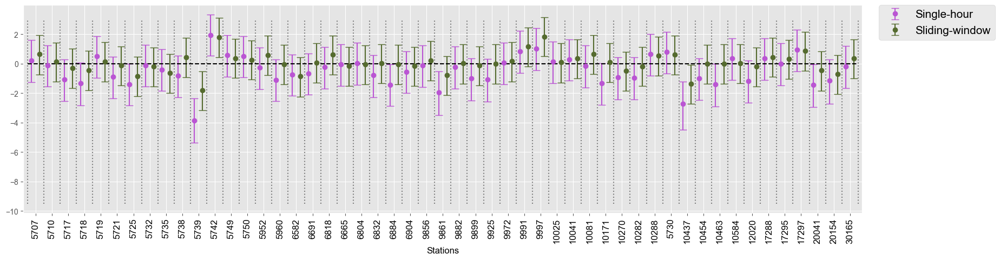

In [28]:
plt.figure(figsize=(20, 5))
plt.errorbar(np.arange(0, len(stations_plot)*4 - 3, 4), w_180.median(dim='sample'), 
             yerr=[w_180.median(dim='sample') - w_180.quantile(0.025, dim='sample'), w_180.quantile(0.975, dim='sample') - w_180.median(dim='sample')], 
             fmt='o', label='Single-hour', capsize=5, color='#BA55D3')
plt.errorbar(np.arange(2, len(stations_plot)*4 - 1, 4), w_120.median(dim='sample'), 
             yerr=[w_120.median(dim='sample') - w_120.quantile(0.025, dim='sample'), w_120.quantile(0.975, dim='sample') - w_120.median(dim='sample')], 
             fmt='o', label='Sliding-window', capsize=5, color='#556B2F')
plt.xticks(np.arange(1, len(stations_plot)*4 - 2, 4), stations_plot, fontsize=12, rotation=90, color='black')
plt.yticks(fontsize=10)
plt.vlines(np.arange(-1, len(stations_plot)*4, 4), ymin=-9.5, ymax=3, colors='gray', linestyles='dotted')
plt.hlines(0, xmin=-1, xmax=len(stations_plot)*4-1, colors='black', linestyles='--')
plt.xlim(-2, len(stations_plot)*4)
plt.xlabel('Stations', fontsize=12, color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.savefig('SIS_plots/w_CI_all_sensors.pdf', bbox_inches='tight')
plt.show()

# 180 - Binomial with all sensors, annual beta, type on xi, zero inflation 

In [4]:
Y = pd.read_csv("../Datasets_all_sensors/Dataset_180.csv")
Y['Count_180'] = pd.to_numeric(Y['Count_180']).astype('Int64')
X = pd.read_csv("../Datasets_all_sensors/variables_to_select.csv")
X = X.drop(["Year", "Month", "Station"], axis = 1)
X = X.drop(["max_consecutive_highwind_days", "Density", "count_highwind", "Zone_A", "Zone_B", "Zone_Cities",
           "Area_S", "Area_U", "Type_T", "Quota"], axis = 1) 
# Note that the stations in Y, X and distance matrix are ordered wrt the period they start recording data

In [5]:
stations_2000_2007 = Y['idSensore'].unique()[:19]
stations_2007_2012 = Y['idSensore'].unique()[19:39] 
stations_2012_2023 = Y['idSensore'].unique()[39:51] 

# Remove from Y and X the blocks of NA between 2000-2007 and 2000-2012
rows_to_remove_2007 = Y[(Y['Year'].between(2000, 2006)) & (Y['idSensore'].isin(stations_2007_2012))].index
rows_to_remove_2012 = Y[(Y['Year'].between(2000, 2011)) & (Y['idSensore'].isin(stations_2012_2023))].index
rows_to_remove = rows_to_remove_2007.union(rows_to_remove_2012)

Y = Y.drop(rows_to_remove).reset_index(drop=True)
X = X.drop(rows_to_remove).reset_index(drop=True)

In [6]:
idx_obs = Y[Y['Count_180'].notna()].index
idx_miss = Y[Y['Count_180'].isna()].index

# take XX% of the remaining indexes for a test set
XX = 0.3 # [0, 1] change this value to change the size of the test set
random.seed(2024)

idx_test = sorted(np.random.choice(idx_obs.values, int(XX*len(idx_obs)), replace=False))
idx_miss = sorted(np.concatenate((idx_test, idx_miss.values)))
idx_obs = sorted(np.setdiff1d(idx_obs, idx_test))

Y_obs = Y.loc[idx_obs, :].reset_index(drop=True)
Y_miss = Y.loc[idx_miss, :].reset_index(drop=True)

X_obs = X.loc[idx_obs, :].reset_index(drop=True)
X_miss = X.loc[idx_miss, :].reset_index(drop=True)

In [7]:
stations = Y['idSensore']
years = pd.Series(Y['Year'] - 1999)
months = pd.Series(Y['Month'] - 3)

unique_values = list(dict.fromkeys(stations))
mapping_dict = {value: index + 1 for index, value in enumerate(unique_values)}
transformed_stations = [mapping_dict[value] for value in stations]
stations_original = pd.Series(stations)
stations = pd.Series(transformed_stations)

stations_obs = stations.loc[idx_obs].reset_index(drop=True)
stations_miss = stations.loc[idx_miss].reset_index(drop=True)
years_obs = years.loc[idx_obs].reset_index(drop=True)
years_miss = years.loc[idx_miss].reset_index(drop=True)
months_obs = months.loc[idx_obs].reset_index(drop=True)
months_miss = months.loc[idx_miss].reset_index(drop=True)

day_in_month = [31,28,31,30,31,30,31,31,30,31,30,31]
max_month = [day_in_month[Y['Month'][i]-1] for i in range(0,Y.shape[0]) ]
max_month = pd.Series(max_month)
max_month_obs = max_month.loc[idx_obs].reset_index(drop=True)
max_month_miss = max_month.loc[idx_miss].reset_index(drop=True)

In [8]:
y = Y_obs['Count_180']
X_obs1 = X_obs
X_obs1 = np.column_stack([np.ones(X_obs1.shape[0]), X_obs1])

# Stima dei coefficienti beta
beta_hat = np.linalg.inv(X_obs1.T @ X_obs1) @ X_obs1.T @ y

# Residui
residuals = y - X_obs1 @ beta_hat

# Varianza stimata degli errori (sigma^2)
sigma2_hat = (residuals.T @ residuals) / (X_obs1.shape[0] - X_obs1.shape[1])

# Matrice di covarianza dei coefficienti beta
cov_beta = sigma2_hat * np.linalg.inv(X_obs1.T @ X_obs1)
cov_beta = cov_beta[1:, 1:] 

In [9]:
phi = 66
distances = pd.read_csv("../Datasets_all_sensors/distances.csv", index_col=0)

In [38]:
data_180_all_year = {
    "N": len(Y_obs),
    "N_miss": len(Y_miss),

    "y": Y_obs['Count_180'],
    "P": X_obs.shape[1],
    
    "nyears": 24,
    "nstations": 51,
    "nmonths": 7,

    "station": stations_obs,
    "year": years_obs,
    "max_month": max_month_obs,
    "station_miss": stations_miss,
    "year_miss": years_miss,
    "max_month_miss": max_month_miss,

    "X": X_obs,
    "X_miss": X_miss,

    "Sigma_mu_beta": cov_beta,

    "phi": phi,
    "distances": distances,

    "month": months_obs,
    "month_miss": months_miss
}

In [29]:
model_all_sensors_year = """
data {

  int<lower=0> N; // Number of observations
  int<lower=0> N_miss; // Number of missing observations
  int<lower=0> P;
  int<lower=0> nyears;
  int<lower=0> nstations;
  int<lower=0> nmonths;

  array[N] int<lower=0> station;
  array[N] int<lower=0> year;
  array[N] int<lower=0> max_month;
  array[N] int<lower=0> month;

  array[N_miss] int<lower=0> station_miss;
  array[N_miss] int<lower=0> year_miss;
  array[N_miss] int<lower=0> max_month_miss;
  array[N_miss] int<lower=0> month_miss;

  array[N] int<lower=0> y; // Count data

  matrix[N, P] X; 
  matrix[N_miss, P] X_miss; 

  real phi;
  matrix[nstations, nstations] distances;
  matrix[P, P] Sigma_mu_beta;
  
}

transformed data {

  matrix[nstations,nstations] H = exp(-(1/phi) * distances);
  
}

parameters {

  matrix[nyears, P] beta; 
  vector[P] mu_beta; 
  real<lower=0> sigma2_beta; 
  
  vector[nstations] w;
  real<lower = 0> sigma2;
  
  vector[nyears] xi; // Random effects for years
  real mu_xi;
  real<lower = 0> sigma2_xi;
  
  vector[nmonths] gamma;
  real mu_gamma;
  real<lower = 0> sigma2_gamma;
  
}

transformed parameters {

  vector[N] alpha;
  vector[N] fix_eff;

  vector[N_miss] alpha_miss;
  vector[N_miss] fix_eff_miss;

  matrix[nstations,nstations] Sigma_s = sigma2 * H; 
  matrix[nstations,nstations] Lw = cholesky_decompose(Sigma_s);
  
  for (i in 1:N) {
    fix_eff[i] = X[i] * beta[year[i]]';  
  }
  alpha = fix_eff + gamma[month] + xi[year] + w[station];

  for (i in 1:N_miss) {
    fix_eff_miss[i] = X_miss[i] * beta[year_miss[i]]';
  }
  alpha_miss = fix_eff_miss + gamma[month_miss] + xi[year_miss] + w[station_miss];
  
}

model {

  mu_beta ~ multi_normal(rep_vector(0, P), Sigma_mu_beta);
  for (j in 1:nyears) {
    beta[j, ] ~ multi_normal(mu_beta, sigma2_beta * diag_matrix(rep_vector(1, P)));
  }

  for (i in 1:N) {
    y[i] ~ binomial_logit(max_month[i], alpha[i]);
  }

  mu_xi ~ normal(0, 1);
  for (i in 1:nyears) {
    xi[i] ~ normal(mu_xi, sqrt(sigma2_xi));
  }
  
  mu_gamma ~ normal(0, 1);
  for (i in 1:nmonths) {
    gamma[i] ~ normal(mu_gamma, sqrt(sigma2_gamma));
  }

  w ~ multi_normal_cholesky(rep_vector(0, nstations), Lw);  
  
  sigma2 ~ inv_gamma(4,2);
  sigma2_xi ~ inv_gamma(4,2);
  sigma2_gamma ~ inv_gamma(4,2);
  sigma2_beta ~ inv_gamma(3,2);

}

generated quantities {

  vector[N] log_lik;

  vector[N] y_pred;
  vector[N_miss] y_pred_miss;

  vector[N] theta;
  vector[N_miss] theta_miss;

  for(i in 1:N) {
    log_lik[i] = binomial_lpmf(y[i]|max_month[i], inv_logit(alpha[i]));
  }
  
  for(i in 1:N){
    theta[i] = inv_logit(alpha[i]);
    y_pred[i] = binomial_rng(max_month[i], theta[i]);
  }

  for(i in 1:N_miss){
    theta_miss[i] = inv_logit(alpha_miss[i]);
    y_pred_miss[i] = binomial_rng(max_month_miss[i], theta_miss[i]);
  }
  
}
"""

In [30]:
# Write model to file
stan_file = "./stan/binomial_all_sensors_year.stan"
with open(stan_file, "w") as f:
    print(model_all_sensors_year, file=f)

# Compile stan model
stan_model = CmdStanModel(stan_file=stan_file)

15:25:03 - cmdstanpy - INFO - compiling stan file /var/folders/h5/sljgddhd1clgfh2_bw619vb80000gn/T/tmpm3d7c993/tmpw0k6oylu.stan to exe file /Users/beo/Desktop/Statistical Learning/Tesi/Code/tesi/Modello/stan/binomial_all_sensors_year
15:26:45 - cmdstanpy - INFO - compiled model executable: /Users/beo/Desktop/Statistical Learning/Tesi/Code/tesi/Modello/stan/binomial_all_sensors_year


In [39]:
# Run the sampler
bin_logit_var_180_all_sensors_year = stan_model.sample(data=data_180_all_year, chains=4, parallel_chains=4, 
                             iter_warmup=1000, iter_sampling=1000, seed=2024)

# Convert chain to arviz format
posterior_bin_logit_var_180_all_sensors_year = az.from_cmdstanpy(bin_logit_var_180_all_sensors_year)

16:03:28 - cmdstanpy - INFO - CmdStan start processing


chain 1 |          | 00:00 Status

chain 2 |          | 00:00 Status

chain 3 |          | 00:00 Status

chain 4 |          | 00:00 Status

16:33:57 - cmdstanpy - INFO - CmdStan done processing.
16:33:57 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: cholesky_decompose: A is not symmetric. A[1,2] = inf, but A[2,1] = inf (in 'binomial_all_sensors_year.stan', line 66, column 2 to column 63)
Exception: cholesky_decompose: A is not symmetric. A[1,2] = inf, but A[2,1] = inf (in 'binomial_all_sensors_year.stan', line 66, column 2 to column 63)
	Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = nan, but Covariance matrix[2,1] = nan (in 'binomial_all_sensors_year.stan', line 84, column 4 to column 83)
Exception: cholesky_decompose: Matrix m is not positive definite (in 'binomial_all_sensors_year.stan', line 66, column 2 to column 63)
Exception: cholesky_decompose: A is not symmetric. A[1,2] = inf, but A[2,1] = inf (in 'binomial_all_sensors_year.stan', line 66, column 2 to column 63)
Consider re-running with show_console=True if the above output is unclear!


In [40]:
post_pred = PostPred(posterior_bin_logit_var_180_all_sensors_year, Y['Count_180'], test_train=True, idx_test=idx_test)
Y_data = post_pred.Y
post_pred.posterior_az

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats

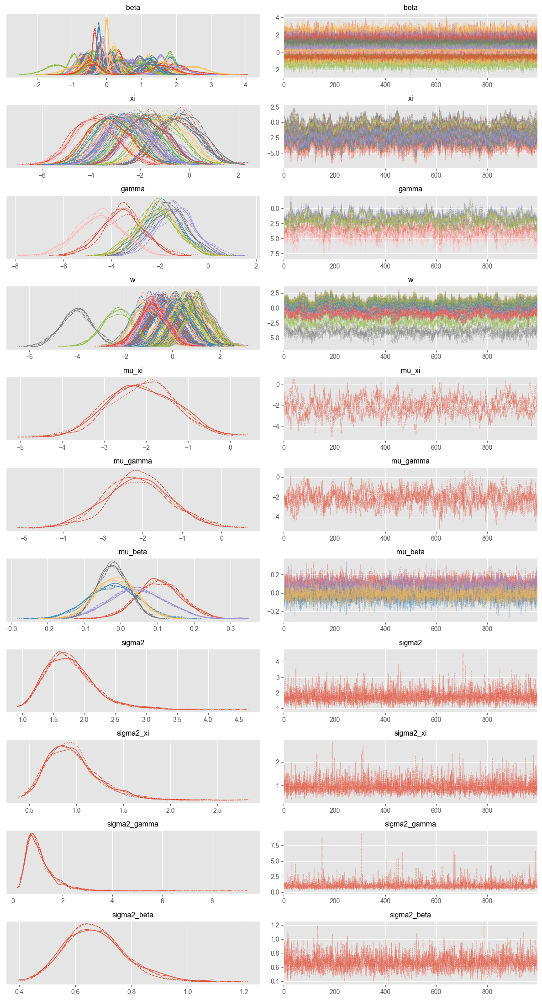

In [42]:
az.plot_trace(post_pred.posterior_az, var_names = ['beta', 'xi', 'gamma', 'w', 'mu_xi', 'mu_gamma', 'mu_beta', 'sigma2', 'sigma2_xi', 'sigma2_gamma', 'sigma2_beta'])
plt.tight_layout()
plt.savefig('SIS_plots/180_chain_all_sensors_year.pdf', bbox_inches='tight')
plt.show()

In [193]:
waic_out2 = az.waic(post_pred.posterior_az, var_name='log_lik')
loo_out2 = az.loo(post_pred.posterior_az, var_name='log_lik')
waic2 = waic_out2.elpd_waic
loo2 = loo_out2.elpd_loo
print(waic_out2)
print(loo_out2)

/usr/local/lib/python3.10/site-packages/arviz/stats/stats.py:1647: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(
/usr/local/lib/python3.10/site-packages/arviz/stats/stats.py:792: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.70 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Computed from 4000 posterior samples and 4126 observations log-likelihood matrix.

          Estimate       SE
elpd_waic -4480.99    98.30
p_waic      333.92        -

There has been a warning during the calculation. Please check the results.
Computed from 4000 posterior samples and 4126 observations log-likelihood matrix.

         Estimate       SE
elpd_loo -4489.04    98.70
p_loo      341.97        -

There has been a warning during the calculation. Please check the results.
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.70]   (good)     4115   99.7%
   (0.70, 1]   (bad)        10    0.2%
   (1, Inf)   (very bad)    1    0.0%



In [209]:
waic_diff = waic_out1.elpd_waic - waic_out2.elpd_waic
se_diff = (waic_out1.se**2 + waic_out2.se**2)**0.5

is_significant = abs(waic_diff) > 2 * se_diff
print(f"Is the difference significant? {'Yes' if is_significant else 'No'}")

Is the difference significant? Yes


In [210]:
alpha = 0.05
y_pred, metrics = post_pred.predict(CI=True,
                                       alpha = alpha,
                                       error_metrics = True)

y_obs, residuals, mse, mae, mad, rmse, mse_test, mae_test, mad_test, rmse_test, outliers_test, percentage_inside_CI_test, outliers, percentage_inside = metrics.values()
print(f'The total number of outliers is: {len(outliers)}\n')
print(f'The total number of outliers in the test set is: {len(outliers_test)}\n')
print(f'The MSE is: {mse}\n')
print(f'The MAE is: {mae}\n')
print(f'The MAD is: {mad}\n')
print(f'The RMSE is: {rmse}\n')

print(f'The MSE in the test set is: {mse_test}\n')
print(f'The MAE in the test set is: {mae_test}\n')
print(f'The MAD in the test set is: {mad_test}\n')
print(f'The RMSE in the test set is: {rmse_test}\n')

print(f'The percentage of observations inside the CI is: {percentage_inside}\n')
print(f'The percentage of observations inside the CI of the test is: {percentage_inside_CI_test}\n')

The total number of outliers is: 207

The total number of outliers in the test set is: 82

The MSE is: 2.4798489733582216

The MAE is: 0.7665874766672323

The MAD is: 0.0

The RMSE is: 1.574753623065596

The MSE in the test set is: 2.911431805319751

The MAE in the test set is: 0.8138087153367289

The MAD in the test set is: 0.0

The RMSE in the test set is: 1.7062918288850097

The percentage of observations inside the CI is: 0.9648735788223316

The percentage of observations inside the CI of the test is: 0.9535936615732881



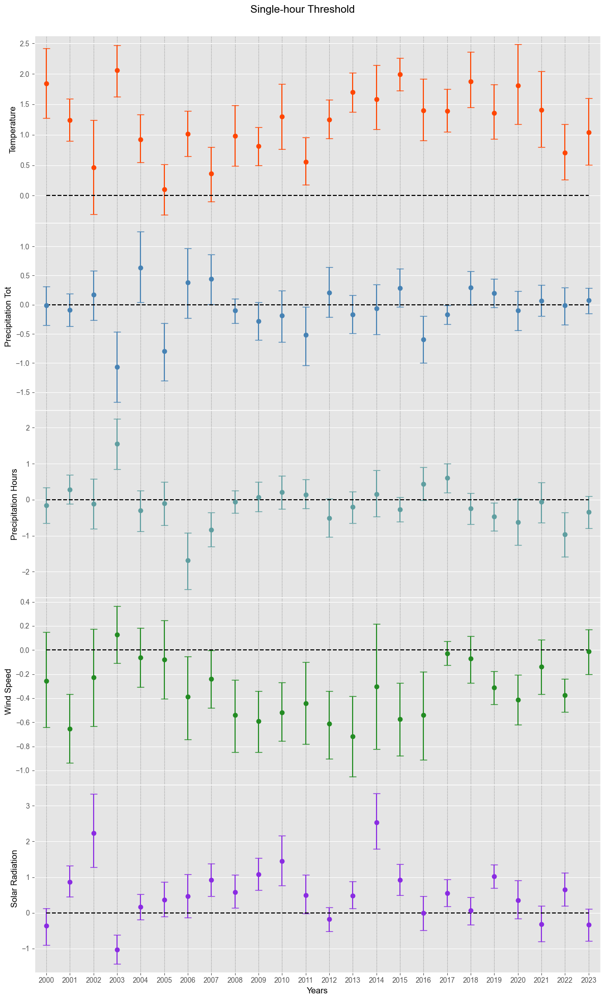

In [211]:
betas = posterior_bin_logit_var_180_all_sensors_year.posterior['beta'].stack(sample=("chain", "draw"))
betas_median = betas.median(dim='sample')
betas_lower = betas.quantile(0.025, dim='sample')
betas_upper = betas.quantile(0.975, dim='sample')

years = range(2000, 2024)  
covariates = betas.coords['beta_dim_1'].values
betas_median = betas_median.values
betas_lower = betas_lower.values
betas_upper = betas_upper.values

colors = ['#FF4500', '#4682B4', '#5F9EA0', '#228B22', '#8A2BE2']
num_covariates = len(covariates)
covariate_labels = ['Temperature', 'Precipitation Tot', 'Precipitation Hours', 'Wind Speed', 'Solar Radiation']
years = range(2000, 2024)  

plt.figure(figsize=(12, 20))
for i, (covariate, color, label) in enumerate(zip(covariates, colors, covariate_labels)):
    ax = plt.subplot(len(covariates), 1, i + 1)
    ax.errorbar(
        years,
        betas_median[:, i],
        yerr=[
            betas_median[:, i] - betas_lower[:, i],
            betas_upper[:, i] - betas_median[:, i]
        ],
        fmt='o',
        color=color,
        capsize=5
    )
    ax.tick_params(axis='x', labelsize=10)  
    ax.tick_params(axis='y', labelsize=10)  

    if i == len(covariates) - 1:
        ax.set_xlabel('Years', fontsize=12, color='black')
    else:
        ax.tick_params(labelbottom=False)  
    ax.set_ylabel(f'{label}', fontsize=12, color='black')
    ax.grid(axis='x', linestyle='dotted', color='grey')
    ax.hlines(0, years[0], years[-1], colors='black', linestyles='--')
    ax.set_xlim(years[0] - 0.5, years[-1] + 0.5)
    ax.set_xticks(years)  
    if i != len(covariates) - 1:
        ax.set_xticklabels([])  

plt.suptitle('Single-hour Threshold', fontsize=15)
plt.tight_layout(h_pad=-0.4)  
plt.subplots_adjust(top=0.95)
plt.savefig('SIS_plots/180_beta_CI_all_sensors_annual.pdf', bbox_inches='tight')
plt.show()    

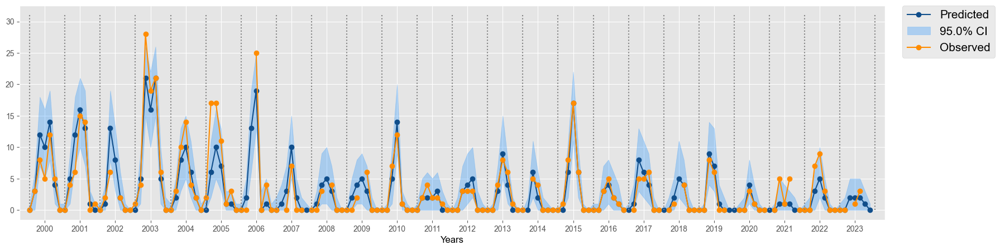

In [212]:
station_num_to_plot = 1 # Change this to plot a different station, -1 to plot manually
if station_num_to_plot != -1:
    xx = np.arange(24*7*(station_num_to_plot-1), 24*7*station_num_to_plot)
else:
    xx = np.arange(1000, 1200) # Change this for the range of the manual choice
plt.figure(figsize=(20, 5))
plt.plot(xx, y_pred.loc[xx, 'pred'], label='Predicted', linestyle='-', marker='o', color='#104E8B')
plt.fill_between(xx, y_pred.loc[xx, f'{alpha/2}'], y_pred.loc[xx, f'{(1-alpha/2)}'], alpha=0.3, label=f'{(1-alpha)*100}% CI', color='#1E90FF')
plt.plot(xx, Y_data[xx], label='Observed', linestyle='-', marker='o', color='#FF8C00')
plt.xticks(xx[np.arange(3,len(xx),7)], np.arange(2000,2024), fontsize=10)
plt.yticks(fontsize=10)
plt.xlim(xx[0]-2, xx[-1]+3)
plt.xlabel('Years', fontsize='12', color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.vlines(xx[np.arange(0,len(xx),7)], ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.vlines(xx[-1]+1, ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.savefig('SIS_plots/180_all_sensors_annual.pdf', bbox_inches='tight')
plt.show()

## Now, we add the type on xi

In [10]:
Y = pd.read_csv("../Datasets_all_sensors/180_zone_area_type.csv")
Y['Count_180'] = pd.to_numeric(Y['Count_180']).astype('Int64')
Y = Y.drop(['Unnamed: 0', 'Zone', 'Area'], axis = 1)
Y = Y.drop(rows_to_remove).reset_index(drop=True)
mapping = {'B': 1, 'T': 2} 
Y['Type_Num'] = Y['Type'].map(mapping)
types = pd.Series(Y['Type_Num'])
types_obs = types.loc[idx_obs].reset_index(drop=True)
types_miss = types.loc[idx_miss].reset_index(drop=True)

In [11]:
data_180_type_year = {
    "N": len(Y_obs),
    "N_miss": len(Y_miss),

    "y": Y_obs['Count_180'],
    "P": X_obs.shape[1],

    "nyears": 24,
    "nstations": 51,
    "nmonths": 7,
    "ntypes": 2, 
    
    "station": stations_obs,
    "year": years_obs,
    "max_month": max_month_obs,
    "month": months_obs,
    "type": types_obs,
    
    "station_miss": stations_miss,
    "year_miss": years_miss,
    "max_month_miss": max_month_miss,
    "month_miss": months_miss,
    "type_miss": types_miss,

    "X": X_obs,
    "X_miss": X_miss,

    "Sigma_mu_beta": cov_beta,

    "phi": phi,
    "distances": distances,
}

In [12]:
model_all_sensors_type_year = """
data {

  int<lower=0> N; // Number of observations
  int<lower=0> N_miss; // Number of missing observations
  int<lower=0> P;
  int<lower=0> nyears;
  int<lower=0> nstations;
  int<lower=0> nmonths;
  int<lower=0> ntypes;

  array[N] int<lower=0> station;
  array[N] int<lower=0> year;
  array[N] int<lower=0> max_month;
  array[N] int<lower=0> month;
  array[N] int<lower=0> type; // Type index for each observation

  array[N_miss] int<lower=0> station_miss;
  array[N_miss] int<lower=0> year_miss;
  array[N_miss] int<lower=0> max_month_miss;
  array[N_miss] int<lower=0> month_miss;
  array[N_miss] int<lower=0> type_miss; // Type index for each missing observation

  array[N] int<lower=0> y; // Count data

  matrix[N, P] X; 
  matrix[N_miss, P] X_miss;

  real phi;
  matrix[nstations, nstations] distances;
  matrix[P, P] Sigma_mu_beta;
    
}

transformed data {

  matrix[nstations,nstations] H = exp(-(1/phi) * distances);
  
}

parameters {

  matrix[nyears, P] beta; 
  vector[P] mu_beta; 
  real<lower=0> sigma2_beta; 

  vector[nstations] w;
  real<lower = 0> sigma2;
  vector<lower = 0>[nstations] sigma2_eta;
  
  matrix[nyears, ntypes] xi;
  real mu_xi;
  real<lower = 0> sigma2_xi;
  
  vector[nmonths] gamma;
  real mu_gamma;
  real<lower = 0> sigma2_gamma;
  
}

transformed parameters {

  vector[N] alpha;
  vector[N] fix_eff;
  vector[N] intercept;

  vector[N_miss] alpha_miss;
  vector[N_miss] fix_eff_miss;
  vector[N_miss] intercept_miss;

  matrix[nstations,nstations] Sigma_s = sigma2 * H + diag_matrix(sigma2_eta); 
  matrix[nstations,nstations] Lw = cholesky_decompose(Sigma_s);

  for (i in 1:N) {
    fix_eff[i] = X[i] * beta[year[i]]';  
  }
  
  for (i in 1:N) {
    intercept[i] = gamma[month[i]] + xi[year[i], type[i]] + w[station[i]];
  }
  
  alpha = fix_eff + intercept; 

  for (i in 1:N_miss) {
    fix_eff_miss[i] = X_miss[i] * beta[year_miss[i]]';
  }
  
  for (i in 1:N_miss) {
    intercept_miss[i] = gamma[month_miss[i]] + xi[year_miss[i], type_miss[i]] + w[station_miss[i]];
  }
  
  alpha_miss = fix_eff_miss + intercept_miss;
  
}

model {

  mu_beta ~ multi_normal(rep_vector(0, P), Sigma_mu_beta);
  for (j in 1:nyears) {
    beta[j, ] ~ multi_normal(mu_beta, sigma2_beta * diag_matrix(rep_vector(1, P)));
  }

  for (i in 1:N) {
    y[i] ~ binomial_logit(max_month[i], alpha[i]);
  }

  mu_xi ~ normal(0, 1);
  for (i in 1:nyears) {
    for (j in 1:ntypes) {
      xi[i, j] ~ normal(mu_xi, sqrt(sigma2_xi));
    }
  }
  
  mu_gamma ~ normal(0, 1);
  for (i in 1:nmonths) {
    gamma[i] ~ normal(mu_gamma, sqrt(sigma2_gamma));
  }

  w ~ multi_normal_cholesky(rep_vector(0, nstations), Lw);
  
  sigma2 ~ inv_gamma(4,2);
  sigma2_xi ~inv_gamma(4,2);
  sigma2_gamma ~ inv_gamma(4,2);
  sigma2_eta ~ inv_gamma(4,2);
  sigma2_beta ~ inv_gamma(3,2);
  
}

generated quantities {

  vector[N] log_lik;

  vector[N] y_pred;
  vector[N_miss] y_pred_miss;

  vector[N] theta;
  vector[N_miss] theta_miss;

  for(i in 1:N) {
    log_lik[i] = binomial_lpmf(y[i]|max_month[i], inv_logit(alpha[i]));
  }
  
  for(i in 1:N){
    theta[i] = inv_logit(alpha[i]);
    y_pred[i] = binomial_rng(max_month[i], theta[i]);
  }

  for(i in 1:N_miss){
    theta_miss[i] = inv_logit(alpha_miss[i]);
    y_pred_miss[i] = binomial_rng(max_month_miss[i], theta_miss[i]);
  }
  
}
"""

In [13]:
# Write model to file
stan_file = "./stan/binomial_all_sensors_type_year.stan"
with open(stan_file, "w") as f:
    print(model_all_sensors_type_year, file=f)

# Compile stan model
stan_model = CmdStanModel(stan_file=stan_file)

11:43:20 - cmdstanpy - INFO - compiling stan file /var/folders/h5/sljgddhd1clgfh2_bw619vb80000gn/T/tmp8zyz0u88/tmpmvbleg_i.stan to exe file /Users/beo/Desktop/Statistical Learning/Tesi/Code/tesi/Modello/stan/binomial_all_sensors_type_year
11:45:00 - cmdstanpy - INFO - compiled model executable: /Users/beo/Desktop/Statistical Learning/Tesi/Code/tesi/Modello/stan/binomial_all_sensors_type_year


In [14]:
# Run the sampler
bin_logit_var_180_all_sensors_type_year = stan_model.sample(data=data_180_type_year, chains=4, parallel_chains=4, 
                             iter_warmup=1000, iter_sampling=1000, seed=2024)

# Convert chain to arviz format
posterior_bin_logit_var_180_all_sensors_type_year = az.from_cmdstanpy(bin_logit_var_180_all_sensors_type_year)

11:45:01 - cmdstanpy - INFO - CmdStan start processing


chain 1 |          | 00:00 Status

chain 2 |          | 00:00 Status

chain 3 |          | 00:00 Status

chain 4 |          | 00:00 Status

12:11:01 - cmdstanpy - INFO - CmdStan done processing.
12:11:01 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = nan, but Covariance matrix[2,1] = nan (in 'binomial_all_sensors_type_year.stan', line 100, column 4 to column 83)
	Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = nan, but Covariance matrix[2,1] = nan (in 'binomial_all_sensors_type_year.stan', line 100, column 4 to column 83)
Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = nan, but Covariance matrix[2,1] = nan (in 'binomial_all_sensors_type_year.stan', line 100, column 4 to column 83)
	Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = nan, but Covariance matrix[2,1] = nan (in 'binomial_all_sensors_type_year.stan', line 100, column 4 to column 83)
Exception: multi_normal_lpdf: LDLT_Factor of covariance p

In [15]:
post_pred = PostPred(posterior_bin_logit_var_180_all_sensors_type_year, Y['Count_180'], test_train=True, idx_test=idx_test)
Y_data = post_pred.Y
post_pred.posterior_az

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats

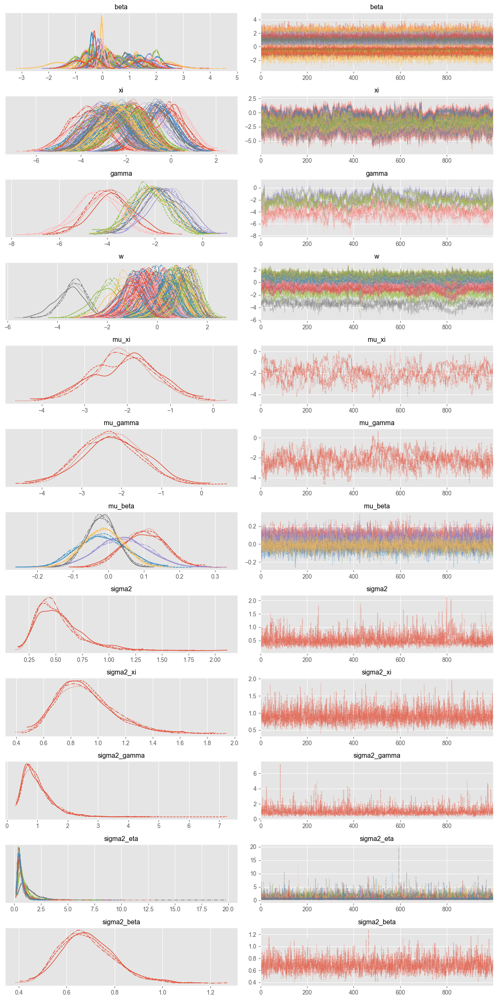

In [219]:
az.plot_trace(post_pred.posterior_az, var_names = ['beta', 'xi', 'gamma', 'w', 'mu_xi', 'mu_gamma', 'mu_beta', 'sigma2', 'sigma2_xi', 'sigma2_gamma', 'sigma2_eta', 'sigma2_beta'])
plt.tight_layout()
plt.savefig('SIS_plots/180_chain_all_sensors_year_type.pdf', bbox_inches='tight')
plt.show()

In [220]:
waic_out = az.waic(post_pred.posterior_az, var_name='log_lik')
loo_out = az.loo(post_pred.posterior_az, var_name='log_lik')
waic = waic_out.elpd_waic
loo = loo_out.elpd_loo
print(waic_out)
print(loo_out)

/usr/local/lib/python3.10/site-packages/arviz/stats/stats.py:1647: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(
/usr/local/lib/python3.10/site-packages/arviz/stats/stats.py:792: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.70 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Computed from 4000 posterior samples and 4126 observations log-likelihood matrix.

          Estimate       SE
elpd_waic -4437.82    97.48
p_waic      362.69        -

There has been a warning during the calculation. Please check the results.
Computed from 4000 posterior samples and 4126 observations log-likelihood matrix.

         Estimate       SE
elpd_loo -4447.61    97.93
p_loo      372.48        -

There has been a warning during the calculation. Please check the results.
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.70]   (good)     4110   99.6%
   (0.70, 1]   (bad)        15    0.4%
   (1, Inf)   (very bad)    1    0.0%



In [221]:
alpha = 0.05
y_pred, metrics = post_pred.predict(CI=True,
                                       alpha = alpha,
                                       error_metrics = True)

y_obs, residuals, mse, mae, mad, rmse, mse_test, mae_test, mad_test, rmse_test, outliers_test, percentage_inside_CI_test, outliers, percentage_inside = metrics.values()
print(f'The total number of outliers is: {len(outliers)}\n')
print(f'The total number of outliers in the test set is: {len(outliers_test)}\n')
print(f'The MSE is: {mse}\n')
print(f'The MAE is: {mae}\n')
print(f'The MAD is: {mad}\n')
print(f'The RMSE is: {mad}\n')

print(f'The MSE in the test set is: {mse_test}\n')
print(f'The MAE in the test set is: {mae_test}\n')
print(f'The MAD in the test set is: {mad_test}\n')
print(f'The RMSE in the test set is: {rmse_test}\n')

print(f'The percentage of observations inside the CI is: {percentage_inside}\n')
print(f'The percentage of observations inside the CI of the test is: {percentage_inside_CI_test}\n')

The total number of outliers is: 190

The total number of outliers in the test set is: 79

The MSE is: 2.3876633293738334

The MAE is: 0.7525878160529442

The MAD is: 0.0

The RMSE is: 0.0

The MSE in the test set is: 2.8588002263723826

The MAE in the test set is: 0.8115449915110357

The MAD in the test set is: 0.0

The RMSE in the test set is: 1.69079869481035

The percentage of observations inside the CI is: 0.9677583573731546

The percentage of observations inside the CI of the test is: 0.955291454442558



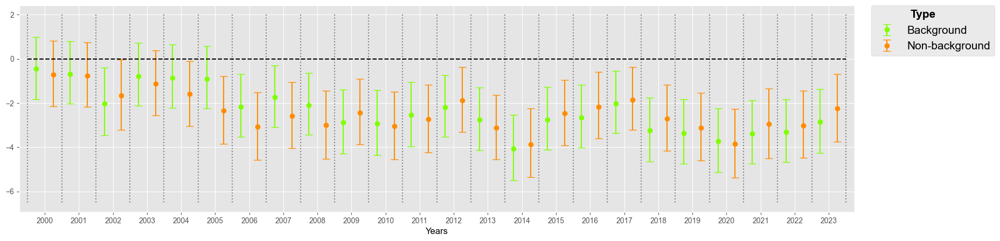

In [25]:
xi_samples = posterior_bin_logit_var_180_all_sensors_type_year.posterior['xi'].stack(sample=("chain", "draw"))
years_plot = np.arange(2000, 2024)

n_years = xi_samples.shape[0] 
n_zones = xi_samples.shape[1] 

xi_means = xi_samples.median(axis=2) 
xi_lower = np.percentile(xi_samples, 2.5, axis=2)  
xi_upper = np.percentile(xi_samples, 97.5, axis=2) 

plt.figure(figsize=(20, 5))
plt.errorbar(np.arange(0, n_years*4 - 3, 4), xi_means[:, 0], yerr=[xi_means[:, 0] - xi_lower[:, 0], xi_upper[:, 0] - xi_means[:, 0]], 
             fmt='o', label=f'Background', capsize=5, color='#7FFF00')
plt.errorbar(np.arange(2, n_years*4 - 1, 4), xi_means[:, 1], yerr=[xi_means[:, 1] - xi_lower[:, 1], xi_upper[:, 1] - xi_means[:, 1]], 
             fmt='o', label=f'Non-background', capsize=5, color='#FF8C00')

plt.xticks(np.arange(1, len(years_plot)*4 - 2, 4), years_plot, fontsize=10)
plt.yticks(fontsize=10)  
plt.vlines(np.arange(-1, len(years_plot)*4, 4), ymin=-6.5, ymax=2, colors='gray', linestyles='dotted')
plt.hlines(0, xmin=-1, xmax=len(years_plot)*4-1, colors='black', linestyles='--')
plt.xlim(-2, len(years_plot)*4)
plt.xlabel('Years', fontsize=12, color='black')
legend = plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0., title='Type', title_fontproperties=font_properties)
legend.get_title().set_horizontalalignment('left')
legend.get_title().set_x(-18)  
plt.savefig('SIS_plots/180_xi_all_sensors_annual_type.pdf', bbox_inches='tight')
plt.show()

## Finally, we add the zero inflation

In [223]:
data_180_type_year = {
    "N": len(Y_obs),
    "N_miss": len(Y_miss),

    "y": Y_obs['Count_180'],
    "P": X_obs.shape[1],
    
    "nyears": 24,
    "nstations": 51,
    "nmonths": 7,
    "ntypes": 2, 
    
    "station": stations_obs,
    "year": years_obs,
    "max_month": max_month_obs,
    "month": months_obs,
    "type": types_obs,
    
    "station_miss": stations_miss,
    "year_miss": years_miss,
    "max_month_miss": max_month_miss,
    "month_miss": months_miss,
    "type_miss": types_miss,

    "X": X_obs,
    "X_miss": X_miss,

    "phi": phi,
    "distances": distances,
    "Sigma_mu_beta": cov_beta,
}

In [224]:
model_all_sensors_type_year_ZIB = """
data {

  int<lower=0> N; // Number of observations
  int<lower=0> N_miss; // Number of missing observations
  int<lower=0> P;
  int<lower=0> nyears;
  int<lower=0> nstations;
  int<lower=0> nmonths;
  int<lower=0> ntypes;

  array[N] int<lower=0> station;
  array[N] int<lower=0> year;
  array[N] int<lower=0> max_month;
  array[N] int<lower=0> month;
  array[N] int<lower=0> type; // Type index for each observation

  array[N_miss] int<lower=0> station_miss;
  array[N_miss] int<lower=0> year_miss;
  array[N_miss] int<lower=0> max_month_miss;
  array[N_miss] int<lower=0> month_miss;
  array[N_miss] int<lower=0> type_miss; // Type index for each missing observation

  array[N] int<lower=0> y; // Count data

  matrix[N, P] X;
  matrix[N_miss, P] X_miss; // Predictor matrix for yearly covariates

  real phi;
  matrix[nstations, nstations] distances;
  matrix[P, P] Sigma_mu_beta;

}

transformed data {

  matrix[nstations,nstations] H = exp(-(1/phi) * distances);
  
}

parameters {

  matrix[nyears, P] beta; // Coefficients for yearly covariates
  vector[P] mu_beta; 
  real<lower=0> sigma2_beta; 

  vector[nstations] w;
  real<lower = 0> sigma2;
  vector<lower = 0>[nstations] sigma2_eta;
  
  matrix[nyears, ntypes] xi;
  real mu_xi;
  real<lower = 0> sigma2_xi;

  vector[nmonths] gamma;
  real mu_gamma;
  real<lower = 0> sigma2_gamma;
  
  vector<lower=0, upper=1>[nmonths] theta; // Probability of excess zeros
  
}

transformed parameters {

  vector[N] alpha;
  vector[N] fix_eff;
  vector[N] intercept;

  vector[N_miss] alpha_miss;
  vector[N_miss] fix_eff_miss;
  vector[N_miss] intercept_miss;

  matrix[nstations,nstations] Sigma_s = sigma2 * H + diag_matrix(sigma2_eta); 
  matrix[nstations,nstations] Lw = cholesky_decompose(Sigma_s);

  for (i in 1:N) {
    fix_eff[i] = X[i] * beta[year[i]]';  
  }
  
  for (i in 1:N) {
    intercept[i] = gamma[month[i]] + xi[year[i], type[i]] + w[station[i]];
  }
  
  alpha = fix_eff + intercept; 

  for (i in 1:N_miss) {
    fix_eff_miss[i] = X_miss[i] * beta[year_miss[i]]';
  }
  
  for (i in 1:N_miss) {
    intercept_miss[i] = gamma[month_miss[i]] + xi[year_miss[i], type_miss[i]] + w[station_miss[i]];
  }
  
  alpha_miss = fix_eff_miss + intercept_miss;
  
}

model {

  mu_beta ~ multi_normal(rep_vector(0, P), Sigma_mu_beta);
  for (j in 1:nyears) {
    beta[j, ] ~ multi_normal(mu_beta, sigma2_beta * diag_matrix(rep_vector(1, P)));
  }

  for (i in 1:N) {
    y[i] ~ binomial_logit(max_month[i], alpha[i]);
  }

  mu_xi ~ normal(0, 1);
  for (i in 1:nyears) {
    for (j in 1:ntypes) {
      xi[i, j] ~ normal(mu_xi, sqrt(sigma2_xi));
    }
  }
  
  mu_gamma ~ normal(0, 1);
  for (i in 1:nmonths) {
    gamma[i] ~ normal(mu_gamma, sqrt(sigma2_gamma));
  }

  w ~ multi_normal_cholesky(rep_vector(0, nstations), Lw);
  
  sigma2 ~ inv_gamma(4,2);
  sigma2_xi ~inv_gamma(4,2);
  sigma2_gamma ~ inv_gamma(4,2);
  sigma2_eta ~ inv_gamma(4,2);
  sigma2_beta ~ inv_gamma(3,2);

  theta ~ beta(0.5, 0.5); // Prior for excess zeros probability

  for (i in 1:N) {
    if (y[i] == 0) {
      target += log_sum_exp(log(theta[month[i]]),
                            log1m(theta[month[i]]) + binomial_lpmf(y[i] | max_month[i], inv_logit(alpha[i])));
    } else {
      target += log1m(theta[month[i]]) + binomial_lpmf(y[i] | max_month[i], inv_logit(alpha[i]));
    }
  }
  
}

generated quantities {

  vector[N] log_lik;

  vector[N] y_pred;
  vector[N_miss] y_pred_miss;

  for (i in 1:N) {
    if (y[i] == 0) {
      log_lik[i] = log_sum_exp(log(theta[month[i]]), log1m(theta[month[i]]) + binomial_lpmf(y[i] | max_month[i], inv_logit(alpha[i])));
    } else {
      log_lik[i] = log1m(theta[month[i]]) + binomial_lpmf(y[i] | max_month[i], inv_logit(alpha[i]));
    }
  }

  for (i in 1:N) {
    real is_zero = bernoulli_rng(theta[month[i]]);
    if (is_zero == 1) {
      y_pred[i] = 0;
    } else {
      y_pred[i] = binomial_rng(max_month[i], inv_logit(alpha[i]));
    }
  }

  for (i in 1:N_miss) {
    real is_zero = bernoulli_rng(theta[month_miss[i]]);
    if (is_zero == 1) {
      y_pred_miss[i] = 0;
    } else {
      y_pred_miss[i] = binomial_rng(max_month_miss[i], inv_logit(alpha_miss[i]));
    }
  }
  
}
"""

In [225]:
# Write model to file
stan_file = "./stan/binomial_all_sensors_type_year_ZIB.stan"
with open(stan_file, "w") as f:
    print(model_all_sensors_type_year_ZIB, file=f)

# Compile stan model
stan_model = CmdStanModel(stan_file=stan_file)

13:19:58 - cmdstanpy - INFO - compiling stan file /var/folders/h5/sljgddhd1clgfh2_bw619vb80000gn/T/tmpi9jdz84m/tmp8ooo7bld.stan to exe file /Users/beo/Desktop/Statistical Learning/Tesi/Code/tesi/Modello/stan/binomial_all_sensors_type_year_ZIB
13:21:57 - cmdstanpy - INFO - compiled model executable: /Users/beo/Desktop/Statistical Learning/Tesi/Code/tesi/Modello/stan/binomial_all_sensors_type_year_ZIB


In [226]:
# Run the sampler
bin_logit_var_180_all_sensors_type_year_ZIB = stan_model.sample(data=data_180_type_year, chains=4, parallel_chains=4, 
                             iter_warmup=1000, iter_sampling=1000, seed=2024)

# Convert chain to arviz format
posterior_bin_logit_var_180_all_sensors_type_year_ZIB = az.from_cmdstanpy(bin_logit_var_180_all_sensors_type_year_ZIB)

13:21:59 - cmdstanpy - INFO - CmdStan start processing


chain 1 |          | 00:00 Status

chain 2 |          | 00:00 Status

chain 3 |          | 00:00 Status

chain 4 |          | 00:00 Status

14:15:02 - cmdstanpy - INFO - CmdStan done processing.
14:15:02 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = nan, but Covariance matrix[2,1] = nan (in 'binomial_all_sensors_type_year_ZIB.stan', line 102, column 4 to column 83)
	Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = nan, but Covariance matrix[2,1] = nan (in 'binomial_all_sensors_type_year_ZIB.stan', line 102, column 4 to column 83)
Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = nan, but Covariance matrix[2,1] = nan (in 'binomial_all_sensors_type_year_ZIB.stan', line 102, column 4 to column 83)
Exception: multi_normal_lpdf: LDLT_Factor of covariance parameter is not positive definite.  last conditional variance is 0. (in 'binomial_all_sensors_type_year_ZIB.stan', line 102, column 4 to column 83)
Consider re-running with show_console=True if 

In [227]:
post_pred = PostPred(posterior_bin_logit_var_180_all_sensors_type_year_ZIB, Y['Count_180'], test_train=True, idx_test=idx_test)
Y_data = post_pred.Y
post_pred.posterior_az

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats

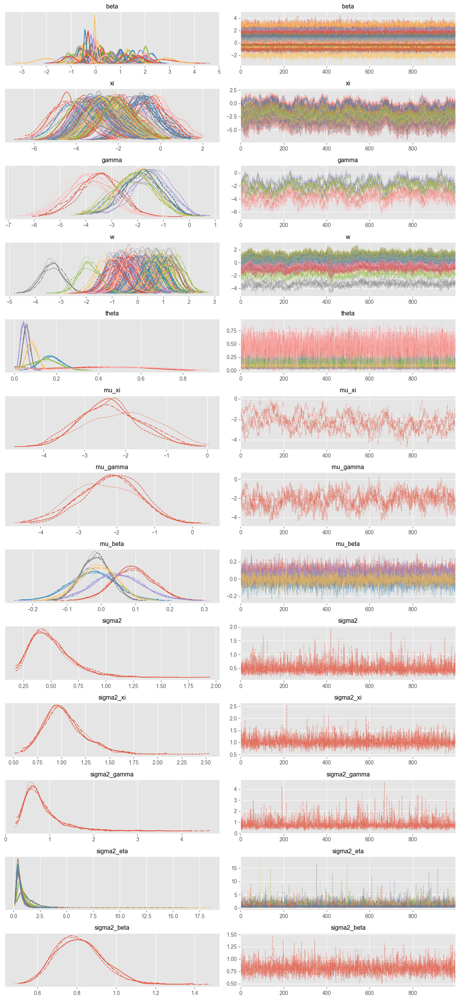

In [228]:
az.plot_trace(post_pred.posterior_az, var_names = ['beta', 'xi', 'gamma', 'w', 'theta', 'mu_xi', 'mu_gamma', 'mu_beta', 'sigma2', 'sigma2_xi', 'sigma2_gamma', 'sigma2_eta', 'sigma2_beta'])
plt.tight_layout()
plt.savefig('SIS_plots/180_chain_all_sensors_year_type_zib.pdf', bbox_inches='tight')
plt.show()

In [229]:
waic_out = az.waic(post_pred.posterior_az, var_name='log_lik')
loo_out = az.loo(post_pred.posterior_az, var_name='log_lik')
waic = waic_out.elpd_waic
loo = loo_out.elpd_loo
print(waic_out)
print(loo_out)

/usr/local/lib/python3.10/site-packages/arviz/stats/stats.py:1647: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(
/usr/local/lib/python3.10/site-packages/arviz/stats/stats.py:792: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.70 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Computed from 4000 posterior samples and 4126 observations log-likelihood matrix.

          Estimate       SE
elpd_waic -4182.67    89.09
p_waic      165.68        -

There has been a warning during the calculation. Please check the results.
Computed from 4000 posterior samples and 4126 observations log-likelihood matrix.

         Estimate       SE
elpd_loo -4184.09    89.13
p_loo      167.10        -

There has been a warning during the calculation. Please check the results.
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.70]   (good)     4125  100.0%
   (0.70, 1]   (bad)         1    0.0%
   (1, Inf)   (very bad)    0    0.0%



In [230]:
alpha = 0.05
y_pred, metrics = post_pred.predict(CI=True,
                                       alpha = alpha,
                                       error_metrics = True)

y_obs, residuals, mse, mae, mad, rmse, mse_test, mae_test, mad_test, rmse_test, outliers_test, percentage_inside_CI_test, outliers, percentage_inside = metrics.values()
print(f'The total number of outliers is: {len(outliers)}\n')
print(f'The total number of outliers in the test set is: {len(outliers_test)}\n')
print(f'The MSE is: {mse}\n')
print(f'The MAE is: {mae}\n')
print(f'The MAD is: {mad}\n')
print(f'The RMSE is: {rmse}\n')

print(f'The MSE in the test set is: {mse_test}\n')
print(f'The MAE in the test set is: {mae_test}\n')
print(f'The MAD in the test set is: {mad_test}\n')
print(f'The RMSE in the test set is: {rmse_test}\n')

print(f'The percentage of observations inside the CI is: {percentage_inside}\n')
print(f'The percentage of observations inside the CI of the test is: {percentage_inside_CI_test}\n')

The total number of outliers is: 157

The total number of outliers in the test set is: 67

The MSE is: 2.451086034277957

The MAE is: 0.7533514339046327

The MAD is: 0.0

The RMSE is: 1.5655944667371424

The MSE in the test set is: 3.006508205998868

The MAE in the test set is: 0.8262591963780419

The MAD in the test set is: 0.0

The RMSE in the test set is: 1.7339285469703958

The percentage of observations inside the CI is: 0.9733582216188699

The percentage of observations inside the CI of the test is: 0.9620826259196378



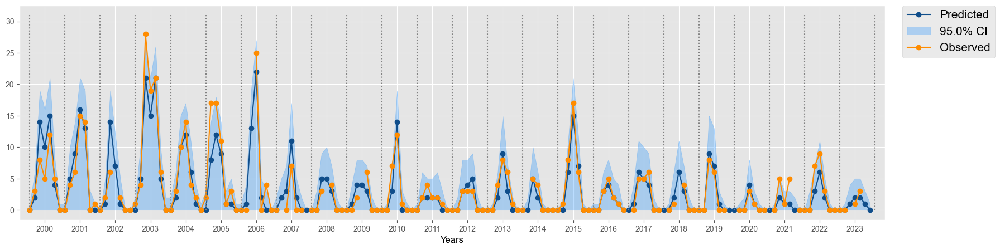

In [78]:
station_num_to_plot = 1 # Change this to plot a different station, -1 to plot manually
if station_num_to_plot != -1:
    xx = np.arange(24*7*(station_num_to_plot-1), 24*7*station_num_to_plot)
else:
    xx = np.arange(1000, 1200) # Change this for the range of the manual choice
plt.figure(figsize=(20, 5))
plt.plot(xx, y_pred.loc[xx, 'pred'], label='Predicted', linestyle='-', marker='o', color='#104E8B')
plt.fill_between(xx, y_pred.loc[xx, f'{alpha/2}'], y_pred.loc[xx, f'{(1-alpha/2)}'], alpha=0.3, label=f'{(1-alpha)*100}% CI', color='#1E90FF')
plt.plot(xx, Y_data[xx], label='Observed', linestyle='-', marker='o', color='#FF8C00')
plt.xticks(xx[np.arange(3,len(xx),7)], np.arange(2000,2024), fontsize=10)
plt.yticks(fontsize=10)
plt.xlim(xx[0]-2, xx[-1]+3)
plt.xlabel('Years', fontsize='12', color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.vlines(xx[np.arange(0,len(xx),7)], ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.vlines(xx[-1]+1, ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.savefig('SIS_plots/180_all_sensors_year_type_zib_1.pdf', bbox_inches='tight')
plt.show()

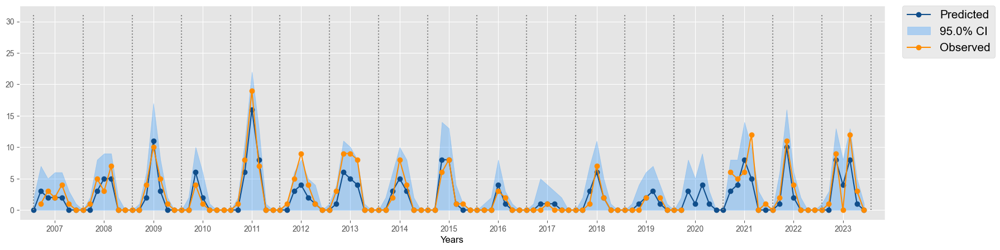

In [79]:
station_num_to_plot = 20 # Change this to plot a different station, -1 to plot manually
if station_num_to_plot != -1:
    xx = np.arange(17*7*(station_num_to_plot-1), 17*7*station_num_to_plot)
else:
    xx = np.arange(1000, 1200) # Change this for the range of the manual choice
plt.figure(figsize=(20, 5))
plt.plot(xx, y_pred.loc[xx, 'pred'], label='Predicted', linestyle='-', marker='o', color='#104E8B')
plt.fill_between(xx, y_pred.loc[xx, f'{alpha/2}'], y_pred.loc[xx, f'{(1-alpha/2)}'], alpha=0.3, label=f'{(1-alpha)*100}% CI', color='#1E90FF')
plt.plot(xx, Y_data[xx], label='Observed', linestyle='-', marker='o', color='#FF8C00')
plt.xticks(xx[np.arange(3,len(xx),7)], np.arange(2007,2024), fontsize=10)
plt.yticks(fontsize=10)
plt.xlim(xx[0]-2, xx[-1]+3)
plt.xlabel('Years', fontsize='12', color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.vlines(xx[np.arange(0,len(xx),7)], ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.vlines(xx[-1]+1, ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.savefig('SIS_plots/180_all_sensors_year_type_zib_2.pdf', bbox_inches='tight')
plt.show()

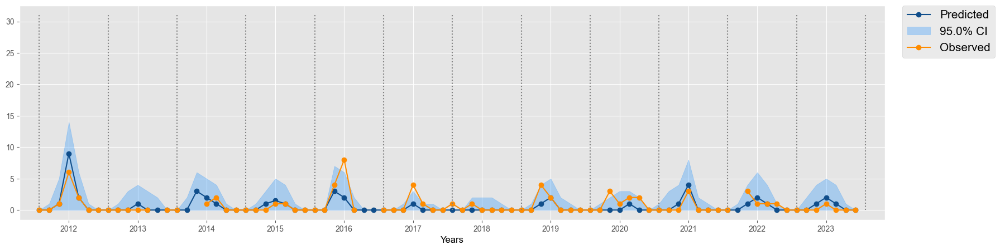

In [80]:
station_num_to_plot = 51 # Change this to plot a different station, -1 to plot manually
if station_num_to_plot != -1:
    xx = np.arange(12*7*(station_num_to_plot-1), 12*7*station_num_to_plot)
else:
    xx = np.arange(1000, 1200) # Change this for the range of the manual choice
plt.figure(figsize=(20, 5))
plt.plot(xx, y_pred.loc[xx, 'pred'], label='Predicted', linestyle='-', marker='o', color='#104E8B')
plt.fill_between(xx, y_pred.loc[xx, f'{alpha/2}'], y_pred.loc[xx, f'{(1-alpha/2)}'], alpha=0.3, label=f'{(1-alpha)*100}% CI', color='#1E90FF')
plt.plot(xx, Y_data[xx], label='Observed', linestyle='-', marker='o', color='#FF8C00')
plt.xticks(xx[np.arange(3,len(xx),7)], np.arange(2012,2024), fontsize=10)
plt.yticks(fontsize=10)
plt.xlim(xx[0]-2, xx[-1]+3)
plt.xlabel('Years', fontsize='12', color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.vlines(xx[np.arange(0,len(xx),7)], ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.vlines(xx[-1]+1, ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.savefig('SIS_plots/180_all_sensors_year_type_zib_3.pdf', bbox_inches='tight')
plt.show()

# 120 - Binomial with all sensors, annual beta

In [43]:
Y = pd.read_csv("../Datasets_all_sensors/Dataset_120.csv")
Y['Count_120'] = pd.to_numeric(Y['Count_120']).astype('Int64')
X = pd.read_csv("../Datasets_all_sensors/variables_to_select.csv")
X = X.drop(["Year", "Month", "Station"], axis = 1)
X = X.drop(["max_consecutive_highwind_days", "Density", "count_highwind", "Zone_A", "Zone_B", "Zone_Cities",
           "Area_S", "Area_U", "Type_T", "Quota"], axis = 1) 
# Note that the stations in Y, X and distance matrix are ordered wrt the period they start recording data

In [44]:
stations_2000_2007 = Y['idSensore'].unique()[:19]
stations_2007_2012 = Y['idSensore'].unique()[19:39] 
stations_2012_2023 = Y['idSensore'].unique()[39:51] 

# Remove from Y and X the blocks of NA between 2000-2007 and 2000-2012
rows_to_remove_2007 = Y[(Y['Year'].between(2000, 2006)) & (Y['idSensore'].isin(stations_2007_2012))].index
rows_to_remove_2012 = Y[(Y['Year'].between(2000, 2011)) & (Y['idSensore'].isin(stations_2012_2023))].index
rows_to_remove = rows_to_remove_2007.union(rows_to_remove_2012)

Y = Y.drop(rows_to_remove).reset_index(drop=True)
X = X.drop(rows_to_remove).reset_index(drop=True)

In [45]:
idx_obs = Y[Y['Count_120'].notna()].index
idx_miss = Y[Y['Count_120'].isna()].index

# take XX% of the remaining indexes for a test set
XX = 0.3 # [0, 1] change this value to change the size of the test set
random.seed(2024)

idx_test = sorted(np.random.choice(idx_obs.values, int(XX*len(idx_obs)), replace=False))
idx_miss = sorted(np.concatenate((idx_test, idx_miss.values)))
idx_obs = sorted(np.setdiff1d(idx_obs, idx_test))

Y_obs = Y.loc[idx_obs, :].reset_index(drop=True)
Y_miss = Y.loc[idx_miss, :].reset_index(drop=True)

X_obs = X.loc[idx_obs, :].reset_index(drop=True)
X_miss = X.loc[idx_miss, :].reset_index(drop=True)

In [46]:
stations = Y['idSensore']
years = pd.Series(Y['Year'] - 1999)
months = pd.Series(Y['Month'] - 3)

unique_values = list(dict.fromkeys(stations))
mapping_dict = {value: index + 1 for index, value in enumerate(unique_values)}
transformed_stations = [mapping_dict[value] for value in stations]
stations_original = pd.Series(stations)
stations = pd.Series(transformed_stations)

stations_obs = stations.loc[idx_obs].reset_index(drop=True)
stations_miss = stations.loc[idx_miss].reset_index(drop=True)
years_obs = years.loc[idx_obs].reset_index(drop=True)
years_miss = years.loc[idx_miss].reset_index(drop=True)
months_obs = months.loc[idx_obs].reset_index(drop=True)
months_miss = months.loc[idx_miss].reset_index(drop=True)

day_in_month = [31,28,31,30,31,30,31,31,30,31,30,31]
max_month = [day_in_month[Y['Month'][i]-1] for i in range(0,Y.shape[0]) ]
max_month = pd.Series(max_month)
max_month_obs = max_month.loc[idx_obs].reset_index(drop=True)
max_month_miss = max_month.loc[idx_miss].reset_index(drop=True)

In [47]:
y = Y_obs['Count_120']
X_obs1 = X_obs
X_obs1 = np.column_stack([np.ones(X_obs1.shape[0]), X_obs1])

# Stima dei coefficienti beta
beta_hat = np.linalg.inv(X_obs1.T @ X_obs1) @ X_obs1.T @ y

# Residui
residuals = y - X_obs1 @ beta_hat

# Varianza stimata degli errori (sigma^2)
sigma2_hat = (residuals.T @ residuals) / (X_obs1.shape[0] - X_obs1.shape[1])

# Matrice di covarianza dei coefficienti beta
cov_beta = sigma2_hat * np.linalg.inv(X_obs1.T @ X_obs1)
cov_beta = cov_beta[1:, 1:] 

In [48]:
phi = 66
distances = pd.read_csv("../Datasets_all_sensors/distances.csv", index_col=0)

In [49]:
data_120_all_year = {
    "N": len(Y_obs),
    "N_miss": len(Y_miss),

    "y": Y_obs['Count_120'],
    "P": X_obs.shape[1],
    
    "nyears": 24,
    "nstations": 51,
    "nmonths": 7,

    "station": stations_obs,
    "year": years_obs,
    "max_month": max_month_obs,
    "station_miss": stations_miss,
    "year_miss": years_miss,
    "max_month_miss": max_month_miss,

    "X": X_obs,
    "X_miss": X_miss,

    "Sigma_mu_beta": cov_beta,

    "phi": phi,
    "distances": distances,

    "month": months_obs,
    "month_miss": months_miss
}

In [50]:
model_all_sensors_year = """
data {

  int<lower=0> N; // Number of observations
  int<lower=0> N_miss; // Number of missing observations
  int<lower=0> P;
  int<lower=0> nyears;
  int<lower=0> nstations;
  int<lower=0> nmonths;

  array[N] int<lower=0> station;
  array[N] int<lower=0> year;
  array[N] int<lower=0> max_month;
  array[N] int<lower=0> month;

  array[N_miss] int<lower=0> station_miss;
  array[N_miss] int<lower=0> year_miss;
  array[N_miss] int<lower=0> max_month_miss;
  array[N_miss] int<lower=0> month_miss;

  array[N] int<lower=0> y; // Count data

  matrix[N, P] X; 
  matrix[N_miss, P] X_miss; 

  real phi;
  matrix[nstations, nstations] distances;
  matrix[P, P] Sigma_mu_beta;
  
}

transformed data {

  matrix[nstations,nstations] H = exp(-(1/phi) * distances);
  
}

parameters {

  matrix[nyears, P] beta; 
  vector[P] mu_beta; 
  real<lower=0> sigma2_beta; 
  
  vector[nstations] w;
  real<lower = 0> sigma2;
  
  vector[nyears] xi; // Random effects for years
  real mu_xi;
  real<lower = 0> sigma2_xi;
  
  vector[nmonths] gamma;
  real mu_gamma;
  real<lower = 0> sigma2_gamma;
  
}

transformed parameters {

  vector[N] alpha;
  vector[N] fix_eff;

  vector[N_miss] alpha_miss;
  vector[N_miss] fix_eff_miss;

  matrix[nstations,nstations] Sigma_s = sigma2 * H; 
  matrix[nstations,nstations] Lw = cholesky_decompose(Sigma_s);
  
  for (i in 1:N) {
    fix_eff[i] = X[i] * beta[year[i]]';  
  }
  
  alpha = fix_eff + gamma[month] + xi[year] + w[station]; 

  for (i in 1:N_miss) {
    fix_eff_miss[i] = X_miss[i] * beta[year_miss[i]]';
  }
  
  alpha_miss = fix_eff_miss + gamma[month_miss] + xi[year_miss] + w[station_miss];
  
}

model {

  mu_beta ~ multi_normal(rep_vector(0, P), Sigma_mu_beta);
  for (j in 1:nyears) {
    beta[j, ] ~ multi_normal(mu_beta, sigma2_beta * diag_matrix(rep_vector(1, P)));
  }

  for (i in 1:N) {
    y[i] ~ binomial_logit(max_month[i], alpha[i]);
  }

  mu_xi ~ normal(0, 1);
  for (i in 1:nyears) {
    xi[i] ~ normal(mu_xi, sqrt(sigma2_xi));
  }
  
  mu_gamma ~ normal(0, 1);
  for (i in 1:nmonths) {
    gamma[i] ~ normal(mu_gamma, sqrt(sigma2_gamma));
  }

  w ~ multi_normal_cholesky(rep_vector(0, nstations), Lw);  
  
  sigma2 ~ inv_gamma(4,2);
  sigma2_xi ~inv_gamma(4,2);
  sigma2_gamma ~ inv_gamma(4,2);
  sigma2_beta ~ inv_gamma(3,2);

}

generated quantities {

  vector[N] log_lik;

  vector[N] y_pred;
  vector[N_miss] y_pred_miss;

  vector[N] theta;
  vector[N_miss] theta_miss;

  for(i in 1:N) {
    log_lik[i] = binomial_lpmf(y[i]|max_month[i], inv_logit(alpha[i]));
  }
  
  for(i in 1:N){
    theta[i] = inv_logit(alpha[i]);
    y_pred[i] = binomial_rng(max_month[i], theta[i]);
  }

  for(i in 1:N_miss){
    theta_miss[i] = inv_logit(alpha_miss[i]);
    y_pred_miss[i] = binomial_rng(max_month_miss[i], theta_miss[i]);
  }
  
}
"""

In [51]:
# Write model to file
stan_file = "./stan/binomial_all_sensors_year.stan"
with open(stan_file, "w") as f:
    print(model_all_sensors_year, file=f)

# Compile stan model
stan_model = CmdStanModel(stan_file=stan_file)

16:40:09 - cmdstanpy - INFO - compiling stan file /var/folders/h5/sljgddhd1clgfh2_bw619vb80000gn/T/tmpzf528c5y/tmpkus9lir8.stan to exe file /Users/beo/Desktop/Statistical Learning/Tesi/Code/tesi/Modello/stan/binomial_all_sensors_year
16:41:27 - cmdstanpy - INFO - compiled model executable: /Users/beo/Desktop/Statistical Learning/Tesi/Code/tesi/Modello/stan/binomial_all_sensors_year


In [52]:
# Run the sampler
bin_logit_var_120_all_sensors_year = stan_model.sample(data=data_120_all_year, chains=4, parallel_chains=4, 
                             iter_warmup=1000, iter_sampling=1000, seed=2024)

# Convert chain to arviz format
posterior_bin_logit_var_120_all_sensors_year = az.from_cmdstanpy(bin_logit_var_120_all_sensors_year)

16:41:27 - cmdstanpy - INFO - CmdStan start processing


chain 1 |          | 00:00 Status

chain 2 |          | 00:00 Status

chain 3 |          | 00:00 Status

chain 4 |          | 00:00 Status

17:31:38 - cmdstanpy - INFO - CmdStan done processing.
17:31:39 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = nan, but Covariance matrix[2,1] = nan (in 'binomial_all_sensors_year.stan', line 86, column 4 to column 83)
	Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = nan, but Covariance matrix[2,1] = nan (in 'binomial_all_sensors_year.stan', line 86, column 4 to column 83)
Exception: cholesky_decompose: A is not symmetric. A[1,2] = inf, but A[2,1] = inf (in 'binomial_all_sensors_year.stan', line 66, column 2 to column 63)
	Exception: multi_normal_lpdf: Covariance matrix is not symmetric. Covariance matrix[1,2] = nan, but Covariance matrix[2,1] = nan (in 'binomial_all_sensors_year.stan', line 86, column 4 to column 83)
Exception: cholesky_decompose: Matrix m is not positive definite (in 'binomial_all_sensors_year.stan', line 66, column 2 to colu

17:31:48 - cmdstanpy - WARNING - Some chains may have failed to converge.
	Chain 1 had 1 iterations at max treedepth (0.1%)
	Chain 2 had 3 iterations at max treedepth (0.3%)
	Chain 3 had 11 iterations at max treedepth (1.1%)
	Chain 4 had 12 iterations at max treedepth (1.2%)
	Use the "diagnose()" method on the CmdStanMCMC object to see further information.


In [53]:
post_pred = PostPred(posterior_bin_logit_var_120_all_sensors_year, Y['Count_120'], test_train=True, idx_test=idx_test)
Y_data = post_pred.Y
post_pred.posterior_az

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats

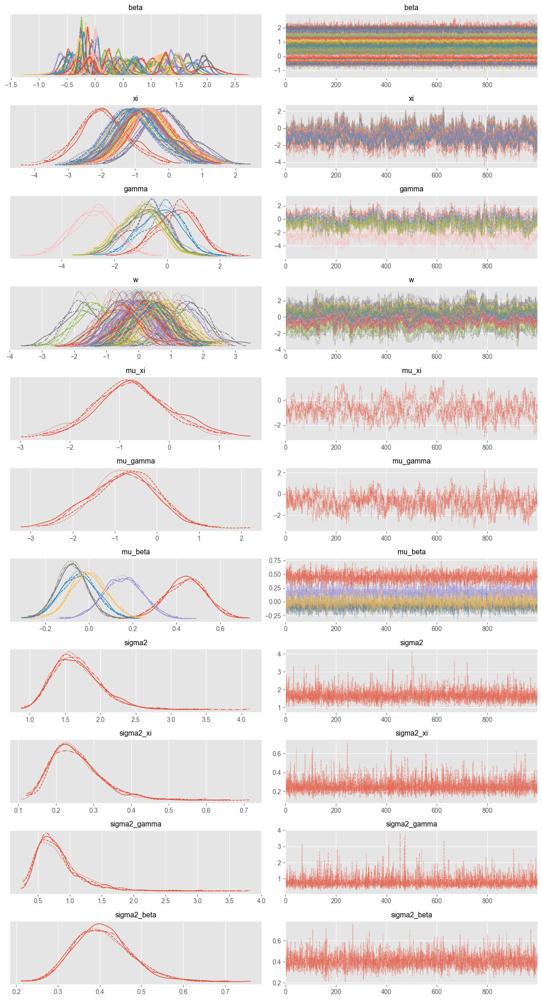

In [54]:
az.plot_trace(post_pred.posterior_az, var_names = ['beta', 'xi', 'gamma', 'w', 'mu_xi', 'mu_gamma', 'mu_beta', 'sigma2', 'sigma2_xi', 'sigma2_gamma', 'sigma2_beta'])
plt.tight_layout()
plt.savefig('SIS_plots/120_chain_all_sensors_year.pdf', bbox_inches='tight')
plt.show()

In [34]:
waic_out = az.waic(post_pred.posterior_az, var_name='log_lik')
loo_out = az.loo(post_pred.posterior_az, var_name='log_lik')
waic = waic_out.elpd_waic
loo = loo_out.elpd_loo
print(waic_out)
print(loo_out)

/usr/local/lib/python3.10/site-packages/arviz/stats/stats.py:1647: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(
/usr/local/lib/python3.10/site-packages/arviz/stats/stats.py:792: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.70 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(


Computed from 4000 posterior samples and 4202 observations log-likelihood matrix.

          Estimate       SE
elpd_waic -10965.55   163.18
p_waic      541.45        -

There has been a warning during the calculation. Please check the results.
Computed from 4000 posterior samples and 4202 observations log-likelihood matrix.

         Estimate       SE
elpd_loo -10969.89   163.26
p_loo      545.80        -

There has been a warning during the calculation. Please check the results.
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.70]   (good)     4192   99.8%
   (0.70, 1]   (bad)         8    0.2%
   (1, Inf)   (very bad)    2    0.0%



In [35]:
alpha = 0.05
y_pred, metrics = post_pred.predict(CI=True,
                                       alpha = alpha,
                                       error_metrics = True)

y_obs, residuals, mse, mae, mad, rmse, mse_test, mae_test, mad_test, rmse_test, outliers_test, percentage_inside_CI_test, outliers, percentage_inside = metrics.values()
print(f'The total number of outliers is: {len(outliers)}\n')
print(f'The total number of outliers in the test set is: {len(outliers_test)}\n')
print(f'The MSE is: {mse}\n')
print(f'The MAE is: {mae}\n')
print(f'The MAD is: {mad}\n')
print(f'The RMSE is: {rmse}\n')

print(f'The MSE in the test set is: {mse_test}\n')
print(f'The MAE in the test set is: {mae_test}\n')
print(f'The MAD in the test set is: {mad_test}\n')
print(f'The RMSE in the test set is: {rmse_test}\n')

print(f'The percentage of observations inside the CI is: {percentage_inside}\n')
print(f'The percentage of observations inside the CI of the test is: {percentage_inside_CI_test}\n')

The total number of outliers is: 744

The total number of outliers in the test set is: 247

The MSE is: 12.32222592469177

The MAE is: 2.3853715428190605

The MAD is: 2.0

The RMSE is: 3.51030282521206

The MSE in the test set is: 14.375555555555556

The MAE in the test set is: 2.5633333333333335

The MAD in the test set is: 2.0

The RMSE in the test set is: 3.7915109858149636

The percentage of observations inside the CI is: 0.8760413195601466

The percentage of observations inside the CI of the test is: 0.8627777777777778



In [36]:
betas = posterior_bin_logit_var_120_all_sensors_year.posterior['beta'].stack(sample=("chain", "draw"))
betas_median = betas.median(dim='sample')
betas_lower = betas.quantile(0.025, dim='sample')
betas_upper = betas.quantile(0.975, dim='sample')

covariates = betas.coords['beta_dim_1'].values
betas_median = betas_median.values
betas_lower = betas_lower.values
betas_upper = betas_upper.values

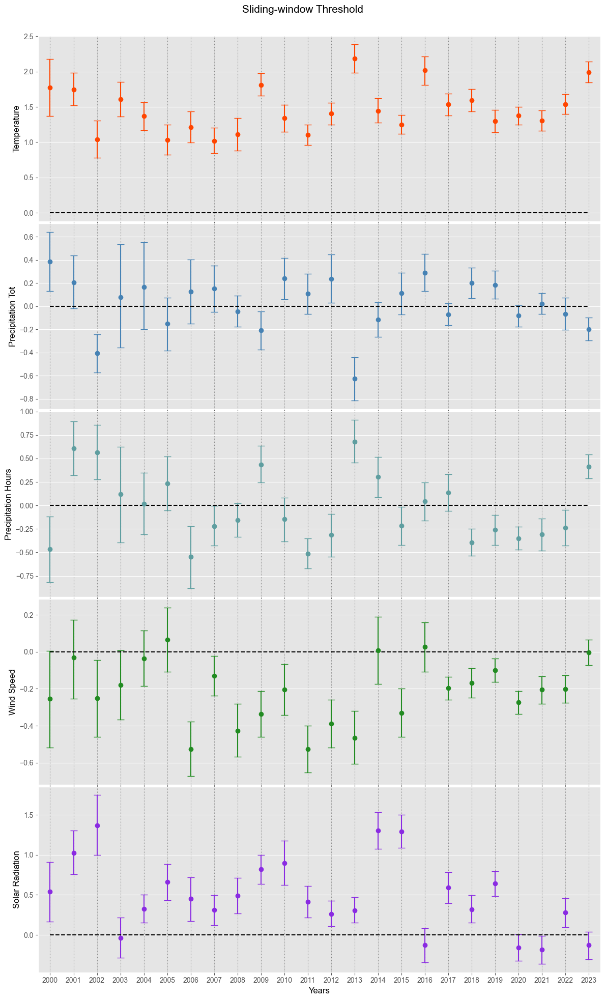

In [37]:
colors = ['#FF4500', '#4682B4', '#5F9EA0', '#228B22', '#8A2BE2'] 
num_covariates = len(covariates)
covariate_labels = ['Temperature', 'Precipitation Tot', 'Precipitation Hours', 'Wind Speed', 'Solar Radiation']
years = range(2000, 2024)  

plt.figure(figsize=(12, 20))

for i, (covariate, color, label) in enumerate(zip(covariates, colors, covariate_labels)):
    ax = plt.subplot(len(covariates), 1, i + 1)
    ax.errorbar(
        years,
        betas_median[:, i],
        yerr=[
            betas_median[:, i] - betas_lower[:, i],
            betas_upper[:, i] - betas_median[:, i]
        ],
        fmt='o',
        color=color,
        capsize=5
    )
    ax.tick_params(axis='x', labelsize=10)  
    ax.tick_params(axis='y', labelsize=10)  

    if i == len(covariates) - 1:
        ax.set_xlabel('Years', fontsize=12, color='black')
    else:
        ax.tick_params(labelbottom=False)  
    ax.set_ylabel(f'{label}', fontsize=12, color='black')
    ax.grid(axis='x', linestyle='dotted', color='grey')
    ax.hlines(0, years[0], years[-1], colors='black', linestyles='--')
    ax.set_xlim(years[0] - 0.5, years[-1] + 0.5)
    ax.set_xticks(years)  
    if i != len(covariates) - 1:
        ax.set_xticklabels([])  

plt.suptitle('Sliding-window Threshold', fontsize=15)
plt.tight_layout(h_pad=-0.4)  
plt.subplots_adjust(top=0.95)
plt.savefig('SIS_plots/120_beta_CI_all_sensors_annual.pdf', bbox_inches='tight')
plt.show()    

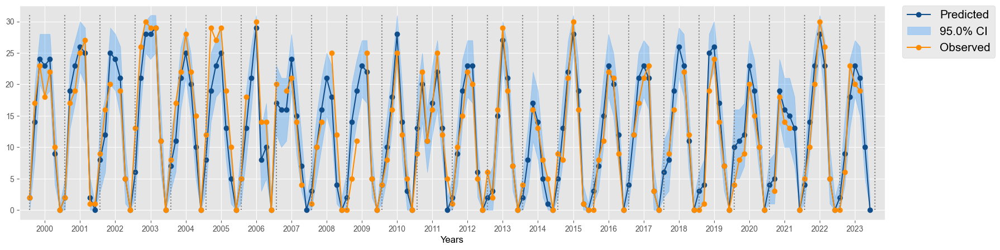

In [38]:
station_num_to_plot = 1 # Change this to plot a different station, -1 to plot manually
if station_num_to_plot != -1:
    xx = np.arange(24*7*(station_num_to_plot-1), 24*7*station_num_to_plot)
else:
    xx = np.arange(1000, 1200) # Change this for the range of the manual choice
plt.figure(figsize=(20, 5))
plt.plot(xx, y_pred.loc[xx, 'pred'], label='Predicted', linestyle='-', marker='o', color='#104E8B')
plt.fill_between(xx, y_pred.loc[xx, f'{alpha/2}'], y_pred.loc[xx, f'{(1-alpha/2)}'], alpha=0.3, label=f'{(1-alpha)*100}% CI', color='#1E90FF')
plt.plot(xx, Y_data[xx], label='Observed', linestyle='-', marker='o', color='#FF8C00')
plt.xticks(xx[np.arange(3,len(xx),7)], np.arange(2000,2024), fontsize=10)
plt.yticks(fontsize=10)
plt.xlim(xx[0]-2, xx[-1]+3)
plt.xlabel('Years', fontsize='12', color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.vlines(xx[np.arange(0,len(xx),7)], ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.vlines(xx[-1]+1, ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.savefig('SIS_plots/120_all_sensors_year_1.pdf', bbox_inches='tight')
plt.show()

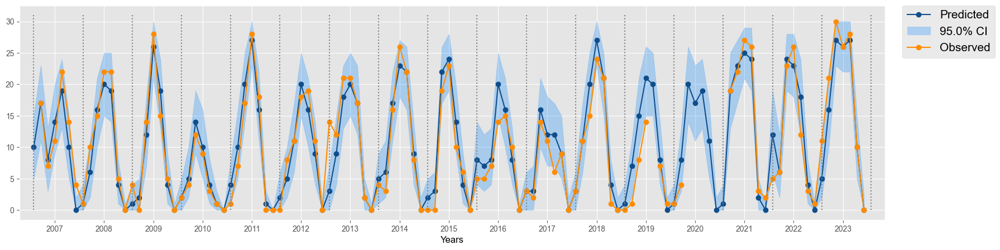

In [39]:
station_num_to_plot = 20 # Change this to plot a different station, -1 to plot manually
if station_num_to_plot != -1:
    xx = np.arange(17*7*(station_num_to_plot-1), 17*7*station_num_to_plot)
else:
    xx = np.arange(1000, 1200) # Change this for the range of the manual choice
plt.figure(figsize=(20, 5))
plt.plot(xx, y_pred.loc[xx, 'pred'], label='Predicted', linestyle='-', marker='o', color='#104E8B')
plt.fill_between(xx, y_pred.loc[xx, f'{alpha/2}'], y_pred.loc[xx, f'{(1-alpha/2)}'], alpha=0.3, label=f'{(1-alpha)*100}% CI', color='#1E90FF')
plt.plot(xx, Y_data[xx], label='Observed', linestyle='-', marker='o', color='#FF8C00')
plt.xticks(xx[np.arange(3,len(xx),7)], np.arange(2007,2024), fontsize=10)
plt.yticks(fontsize=10)
plt.xlim(xx[0]-2, xx[-1]+3)
plt.xlabel('Years', fontsize='12', color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.vlines(xx[np.arange(0,len(xx),7)], ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.vlines(xx[-1]+1, ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.savefig('SIS_plots/120_all_sensors_year_2.pdf', bbox_inches='tight')
plt.show()

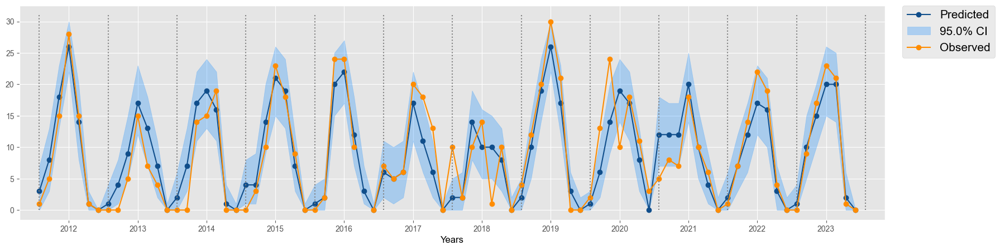

In [40]:
station_num_to_plot = 51 # Change this to plot a different station, -1 to plot manually
if station_num_to_plot != -1:
    xx = np.arange(12*7*(station_num_to_plot-1), 12*7*station_num_to_plot)
else:
    xx = np.arange(1000, 1200) # Change this for the range of the manual choice
plt.figure(figsize=(20, 5))
plt.plot(xx, y_pred.loc[xx, 'pred'], label='Predicted', linestyle='-', marker='o', color='#104E8B')
plt.fill_between(xx, y_pred.loc[xx, f'{alpha/2}'], y_pred.loc[xx, f'{(1-alpha/2)}'], alpha=0.3, label=f'{(1-alpha)*100}% CI', color='#1E90FF')
plt.plot(xx, Y_data[xx], label='Observed', linestyle='-', marker='o', color='#FF8C00')
plt.xticks(xx[np.arange(3,len(xx),7)], np.arange(2012,2024), fontsize=10)
plt.yticks(fontsize=10)
plt.xlim(xx[0]-2, xx[-1]+3)
plt.xlabel('Years', fontsize='12', color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.vlines(xx[np.arange(0,len(xx),7)], ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.vlines(xx[-1]+1, ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.savefig('SIS_plots/120_all_sensors_year_3.pdf', bbox_inches='tight')
plt.show()

# 180 & 120 - Bivariate binomial model with all sensors

In [4]:
Y = pd.read_csv("../Datasets_all_sensors/Dataset_bivariate.csv")
Y['Count_180'] = pd.to_numeric(Y['Count_180']).astype('Int64')
Y['Count_120'] = pd.to_numeric(Y['Count_120']).astype('Int64')
X = pd.read_csv("../Datasets_all_sensors/variables_to_select.csv")
X = X.drop(["Year", "Month", "Station"], axis = 1)
X = X.drop(["max_consecutive_highwind_days", "Density", "count_highwind", "Zone_A", "Zone_B", "Zone_Cities",
           "Area_S", "Area_U", "Type_T", "Quota"], axis = 1) 
# Note that the stations in Y, X and distance matrix are ordered wrt the period they start recording data

In [5]:
stations_2000_2007 = Y['idSensore'].unique()[:19]
stations_2007_2012 = Y['idSensore'].unique()[19:39] 
stations_2012_2023 = Y['idSensore'].unique()[39:51] 

# Remove from Y and X the blocks of NA between 2000-2007 and 2000-2012
rows_to_remove_2007 = Y[(Y['Year'].between(2000, 2006)) & (Y['idSensore'].isin(stations_2007_2012))].index
rows_to_remove_2012 = Y[(Y['Year'].between(2000, 2011)) & (Y['idSensore'].isin(stations_2012_2023))].index
rows_to_remove = rows_to_remove_2007.union(rows_to_remove_2012)

Y = Y.drop(rows_to_remove).reset_index(drop=True)
X = X.drop(rows_to_remove).reset_index(drop=True)

In [6]:
Y['Count_180'] = Y['Count_180'].mask(Y['Count_120'].isna())
Y['Count_120'] = Y['Count_120'].mask(Y['Count_180'].isna())

In [7]:
idx_obs = Y[Y['Count_180'].notna()].index
idx_miss = Y[Y['Count_180'].isna()].index

# take XX% of the remaining indexes for a test set
XX = 0.3 # [0, 1] change this value to change the size of the test set
random.seed(2024)

idx_test = sorted(np.random.choice(idx_obs.values, int(XX*len(idx_obs)), replace=False))
idx_miss = sorted(np.concatenate((idx_test, idx_miss.values)))
idx_obs = sorted(np.setdiff1d(idx_obs, idx_test))

Y_obs = Y.loc[idx_obs, :].reset_index(drop=True)
Y_miss = Y.loc[idx_miss, :].reset_index(drop=True)

X_obs = X.loc[idx_obs, :].reset_index(drop=True)
X_miss = X.loc[idx_miss, :].reset_index(drop=True)

In [8]:
stations = Y['idSensore']
years = pd.Series(Y['Year'] - 1999)
months = pd.Series(Y['Month'] - 3)
unique_values = list(dict.fromkeys(stations))
mapping_dict = {value: index + 1 for index, value in enumerate(unique_values)}
transformed_stations = [mapping_dict[value] for value in stations]
stations_original = pd.Series(stations)
stations = pd.Series(transformed_stations)

stations_obs = stations.loc[idx_obs].reset_index(drop=True)
stations_miss = stations.loc[idx_miss].reset_index(drop=True)
years_obs = years.loc[idx_obs].reset_index(drop=True)
years_miss = years.loc[idx_miss].reset_index(drop=True)
months_obs = months.loc[idx_obs].reset_index(drop=True)
months_miss = months.loc[idx_miss].reset_index(drop=True)

day_in_month = [31,28,31,30,31,30,31,31,30,31,30,31]
max_month = [day_in_month[Y['Month'][i]-1] for i in range(0,Y.shape[0]) ]
max_month = pd.Series(max_month)
max_month_obs = max_month.loc[idx_obs].reset_index(drop=True)
max_month_miss = max_month.loc[idx_miss].reset_index(drop=True)

In [9]:
phi1 = 66
phi2 = 66
distances = pd.read_csv("../Datasets_all_sensors/distances.csv", index_col=0)

In [10]:
data_biv_all = {
    "N": len(Y_obs),
    "N_miss": len(Y_miss),

    "y180": Y_obs['Count_180'],
    "y120": Y_obs['Count_120'],
    "P": X_obs.shape[1],

    "nyears": 24,
    "nstations": 51,
    "nmonths": 7,

    "station": stations_obs,
    "year": years_obs,
    "max_month": max_month_obs,
    "station_miss": stations_miss,
    "year_miss": years_miss,
    "max_month_miss": max_month_miss,

    "X": X_obs,
    "X_miss": X_miss,

    "phi1": phi1,
    "phi2": phi2,
    "distances": distances,

    "month": months_obs,
    "month_miss": months_miss
}

In [11]:
model_biv_all_sensors = """ 
data {

  int<lower=0> N; // Number of observations
  int<lower=0> N_miss; // Number of missing observations
  int<lower=0> P; // Covariate number
  int<lower=0> nyears;
  int<lower=0> nstations;
  int <lower=0> nmonths;

  array[N] int<lower=0> station;
  array[N] int<lower=0> year;
  array[N] int<lower=0> max_month;
  array[N] int<lower=0> month;

  array[N_miss] int<lower=0> station_miss;
  array[N_miss] int<lower=0> year_miss;
  array[N_miss] int<lower=0> max_month_miss;
  array[N_miss] int<lower=0> month_miss;
  
  array[N] int<lower=0> y180; 
  array[N] int<lower=0> y120; 

  matrix[N, P] X; // Predictor matrix
  matrix[N_miss, P] X_miss; // Predictor matrix
  
  real phi1; // questo phi è uguale in entrambi 120 e 180
  real phi2;
  matrix[nstations, nstations] distances;
  
}

transformed data {

  matrix[nstations,nstations] H1 = exp(-(1/phi1) * distances);
  matrix[nstations,nstations] H2 = exp(-(1/phi2) * distances);
  
}

parameters {

  vector[P] beta180; // indipendenti
  vector[P] beta120; // 

  vector[nyears] xi180; // indipendenti
  vector[nyears] xi120; // 
  real mu_xi;
  real<lower = 0> sigma2_xi;

  vector[nmonths] gamma180; // dipendenti
  vector[nmonths] gamma120; // 
  vector[2] mu_gamma;
  real<lower = 0> sigma2_gamma;
  real<lower=-1, upper=1> rho_gamma;

  vector[nstations] w180; // indipendenti
  vector[nstations] w120; //
  real<lower = 0> sigma180; 
  real<lower = 0> sigma120; 
  // real<lower = 0> s2;
  // vector<lower = 0>[nstations] sigma2_eta;
  
}

transformed parameters {

  vector[N] alpha180;
  vector[N] alpha120;

  vector[N_miss] alpha_miss180;
  vector[N_miss] alpha_miss120;

  // Matrice covarianza per gamma
  matrix[2, 2] Sigma_gamma;
  Sigma_gamma[1, 1] = sigma2_gamma;
  Sigma_gamma[2, 2] = sigma2_gamma;
  Sigma_gamma[1, 2] = rho_gamma * sigma2_gamma;
  Sigma_gamma[2, 1] = rho_gamma * sigma2_gamma;

  // Matrici di covarianza per w
  cov_matrix[nstations] Sigma180 = sigma180 * H1;
  cov_matrix[nstations] Sigma120 = sigma120 * H2;
  // cov_matrix[nstations] S = s2*identity_matrix(nstations);
  
  // Combinazione delle matrici di covarianza
  // matrix[nstations, 2*nstations] upper_part = append_col(Sigma180, S);
  // matrix[nstations, 2*nstations] lower_part = append_col(S, Sigma120);
  // cov_matrix[2*nstations] Sigma_combined = append_row(upper_part, lower_part); 
  
  alpha180 = X * beta180 + gamma180[month] + xi180[year] + w180[station];
  alpha120 = X * beta120 + gamma120[month] + xi120[year] + w120[station];

  alpha_miss180 = X_miss * beta180 + gamma180[month_miss] + xi180[year_miss] + w180[station_miss];
  alpha_miss120 = X_miss * beta120 + gamma120[month_miss] + xi120[year_miss] + w120[station_miss];
  
  // vector[2*nstations] w_concat = append_row(w180, w120);
  matrix[nmonths,2] gamma_concat = append_col(gamma180, gamma120);

}

model {

  beta180 ~ normal(0, 1); 
  beta120 ~ normal(0, 1); 

  for (i in 1:N) {
    y180[i] ~ binomial_logit(max_month[i], alpha180[i]);
    y120[i] ~ binomial_logit(max_month[i], alpha120[i]);
  }

  mu_xi ~ normal(0, 1);
  sigma2_xi ~ inv_gamma(4,2);
  for (i in 1:nyears) {
    xi180[i] ~ normal(mu_xi, sqrt(sigma2_xi)); 
    xi120[i] ~ normal(mu_xi, sqrt(sigma2_xi)); 
  }
  
  mu_gamma ~ normal(0, 1);
  sigma2_gamma ~ inv_gamma(3,2);
  rho_gamma ~ normal(0, 1);
  for (i in 1:nmonths) {
    [gamma180[i], gamma120[i]] ~ multi_normal(mu_gamma, Sigma_gamma);
  }

  // w_concat ~ multi_normal_cholesky(rep_vector(0,2*nstations), cholesky_decompose(Sigma_combined));
  w180 ~ multi_normal_cholesky(rep_vector(0,nstations), cholesky_decompose(Sigma180));
  w120 ~ multi_normal_cholesky(rep_vector(0,nstations), cholesky_decompose(Sigma120));
  sigma180 ~ inv_gamma(3,2);
  sigma120 ~ inv_gamma(3,2);
  // s2 ~ inv_gamma(3,2);
  // sigma2_eta ~ inv_gamma(4,2); serve per il nugget, qua non ce l'abbiamo 
  
}

generated quantities {

  vector[N] log_lik180;
  vector[N] log_lik120;

  vector[N] y_pred180;
  vector[N_miss] y_pred_miss180;

  vector[N] y_pred120;
  vector[N_miss] y_pred_miss120;

  for(i in 1:N) {
    log_lik180[i] = binomial_lpmf(y180[i]|max_month[i], inv_logit(alpha180[i]));
    log_lik120[i] = binomial_lpmf(y120[i]|max_month[i], inv_logit(alpha120[i]));
  }
  
  for(i in 1:N){
    y_pred180[i] = binomial_rng(max_month[i], inv_logit(alpha180[i]));
    y_pred120[i] = binomial_rng(max_month[i], inv_logit(alpha120[i]));
  }

  for(i in 1:N_miss){
    y_pred_miss180[i] = binomial_rng(max_month_miss[i], inv_logit(alpha_miss180[i]));
    y_pred_miss120[i] = binomial_rng(max_month_miss[i], inv_logit(alpha_miss120[i]));
  }
  
}
"""

In [12]:
# Write model to file
stan_file = "./stan/bivariate_all_sensors_2000_23.stan"
with open(stan_file, "w") as f:
    print(model_biv_all_sensors, file=f)

# Compile stan model
stan_model = CmdStanModel(stan_file=stan_file)

17:40:56 - cmdstanpy - INFO - compiling stan file /var/folders/h5/sljgddhd1clgfh2_bw619vb80000gn/T/tmpqxizsefo/tmpbvxbvfn2.stan to exe file /Users/beo/Desktop/Statistical Learning/Tesi/Code/tesi/Modello/stan/bivariate_all_sensors_2000_23
17:42:41 - cmdstanpy - INFO - compiled model executable: /Users/beo/Desktop/Statistical Learning/Tesi/Code/tesi/Modello/stan/bivariate_all_sensors_2000_23


In [14]:
# Run the sampler
bin_logit_var_bivariate = stan_model.sample(data=data_biv_all, chains=4, parallel_chains=4, 
                             iter_warmup=1000, iter_sampling=1000, seed=2024)

17:44:52 - cmdstanpy - INFO - CmdStan start processing


chain 1 |          | 00:00 Status

chain 2 |          | 00:00 Status

chain 3 |          | 00:00 Status

chain 4 |          | 00:00 Status

19:41:18 - cmdstanpy - INFO - CmdStan done processing.


19:41:18 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: tmpbvxbvfn2_model_namespace::log_prob: Sigma180 is not symmetric. Sigma180[1,2] = inf, but Sigma180[2,1] = inf (in 'bivariate_all_sensors_2000_23.stan', line 81, column 2 to column 49)
Exception: tmpbvxbvfn2_model_namespace::log_prob: Sigma180 is not symmetric. Sigma180[1,2] = inf, but Sigma180[2,1] = inf (in 'bivariate_all_sensors_2000_23.stan', line 81, column 2 to column 49)
	Exception: tmpbvxbvfn2_model_namespace::log_prob: Sigma120 is not symmetric. Sigma120[1,2] = inf, but Sigma120[2,1] = inf (in 'bivariate_all_sensors_2000_23.stan', line 82, column 2 to column 49)
Exception: tmpbvxbvfn2_model_namespace::log_prob: Sigma180 is not symmetric. Sigma180[1,2] = inf, but Sigma180[2,1] = inf (in 'bivariate_all_sensors_2000_23.stan', line 81, column 2 to column 49)
	Exception: tmpbvxbvfn2_model_namespace::log_prob: Sigma120 is not symmetric. Sigma120[1,2] = inf, but Sigma120[2,1] = inf (in 'bivariate_all_sensors

In [15]:
posterior_bin_logit_var_bivariate = az.from_cmdstanpy(bin_logit_var_bivariate, log_likelihood={'log_lik180': 'log_lik180', 
                                                                                               'log_lik120': 'log_lik120'})

In [16]:
post_pred = PostPredBivariate(posterior_bin_logit_var_bivariate, Y['Count_180'], Y['Count_120'], test_train=True, idx_test=idx_test)
Y180_data = post_pred.Y180
Y120_data = post_pred.Y120
post_pred.posterior_az

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats

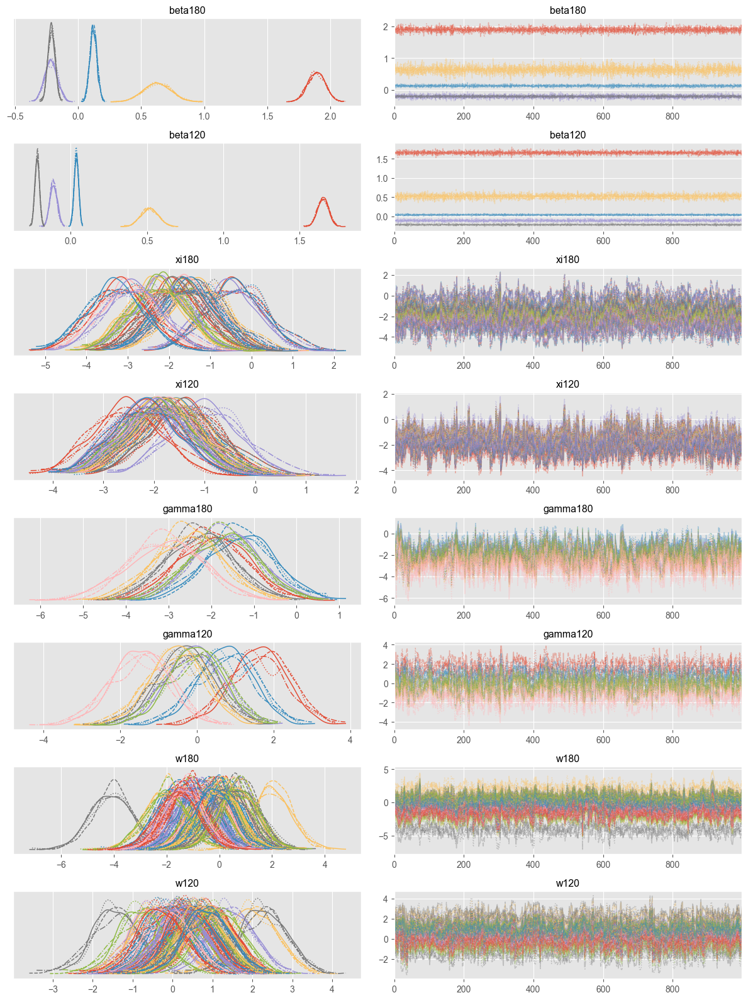

In [16]:
az.plot_trace(post_pred.posterior_az, var_names = ['beta180', 'beta120', 'xi180', 'xi120', 'gamma180', 'gamma120', 'w180', 'w120'])
plt.tight_layout()
plt.savefig('SIS_plots/biv_chain_all_sensors_1.pdf', bbox_inches='tight')
plt.show()

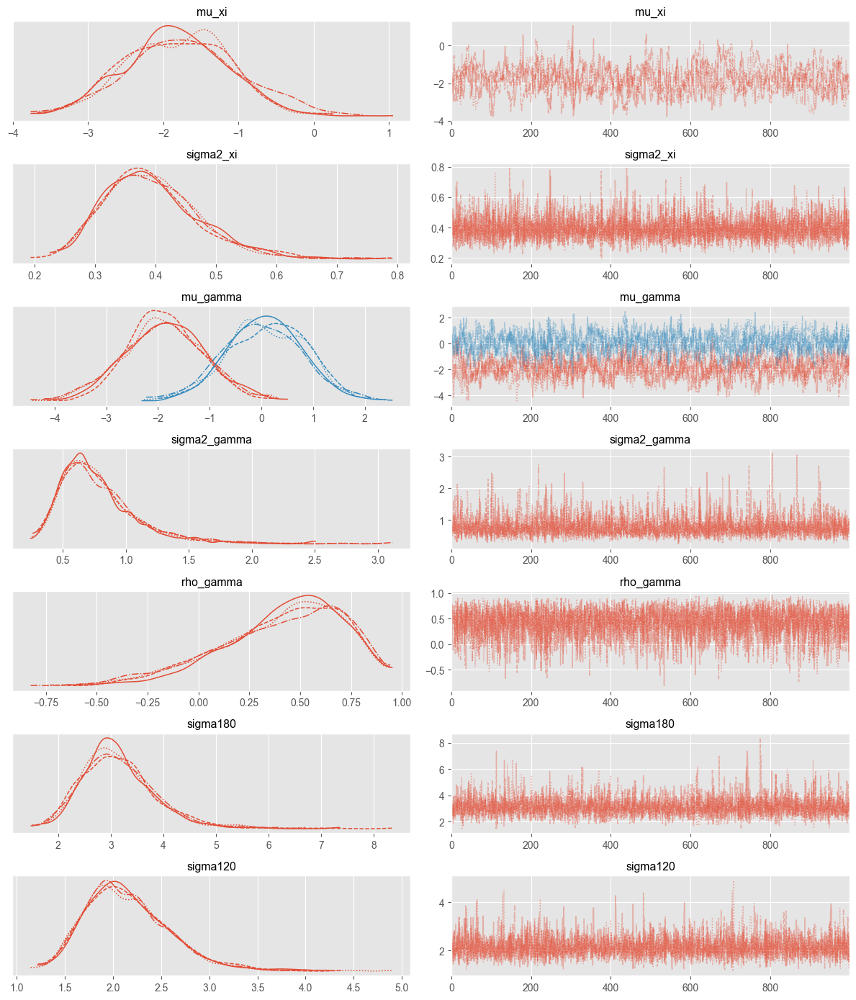

In [17]:
az.plot_trace(post_pred.posterior_az, var_names = ['mu_xi', 'sigma2_xi', 'mu_gamma', 'sigma2_gamma', 'rho_gamma', 'sigma180', 'sigma120'])
plt.tight_layout()
plt.savefig('SIS_plots/biv_chain_all_sensors_2.pdf', bbox_inches='tight')
plt.show()

In [18]:
waic_out180 = az.waic(post_pred.posterior_az, var_name='log_lik180')
loo_out180 = az.loo(post_pred.posterior_az, var_name='log_lik180')
waic180 = waic_out180.elpd_waic
loo180 = loo_out180.elpd_loo
print(waic_out180)
print(loo_out180)

/usr/local/lib/python3.10/site-packages/arviz/stats/stats.py:1647: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(


Computed from 4000 posterior samples and 4124 observations log-likelihood matrix.

          Estimate       SE
elpd_waic -4719.01   102.29
p_waic      177.09        -

There has been a warning during the calculation. Please check the results.
Computed from 4000 posterior samples and 4124 observations log-likelihood matrix.

         Estimate       SE
elpd_loo -4719.97   102.33
p_loo      178.05        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.70]   (good)     4124  100.0%
   (0.70, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%



In [19]:
waic_out120 = az.waic(post_pred.posterior_az, var_name='log_lik120')
loo_out120 = az.loo(post_pred.posterior_az, var_name='log_lik120')
waic120 = waic_out120.elpd_waic
loo120 = loo_out120.elpd_loo
print(waic_out120)
print(loo_out120)

/usr/local/lib/python3.10/site-packages/arviz/stats/stats.py:1647: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(


Computed from 4000 posterior samples and 4124 observations log-likelihood matrix.

          Estimate       SE
elpd_waic -11444.90   169.55
p_waic      260.76        -

There has been a warning during the calculation. Please check the results.
Computed from 4000 posterior samples and 4124 observations log-likelihood matrix.

         Estimate       SE
elpd_loo -11445.27   169.56
p_loo      261.13        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.70]   (good)     4124  100.0%
   (0.70, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%



In [20]:
alpha = 0.05
(y_pred180, y_pred120), (metrics180, metrics120) = post_pred.predict(CI=True,
                                                                 alpha = alpha,
                                                                 error_metrics = True)

In [21]:
y_obs, residuals, mse, mae, mad, rmse, mse_test, mae_test, mad_test, rmse_test, outliers_test, percentage_inside_CI_test, outliers, percentage_inside = metrics180.values()
print(f'Metrics for 180 Threshold\n')

print(f'The total number of outliers is: {len(outliers)}\n')
print(f'The total number of outliers in the test set is: {len(outliers_test)}\n')
print(f'The MSE is: {mse}\n')
print(f'The MAE is: {mae}\n')
print(f'The MAD is: {mad}\n')
print(f'The RMSE is: {rmse}\n')

print(f'The MSE in the test set is: {mse_test}\n')
print(f'The MAE in the test set is: {mae_test}\n')
print(f'The MAD in the test set is: {mad_test}\n')
print(f'The RMSE in the test set is: {rmse_test}\n')

print(f'The percentage of observations inside the CI is: {percentage_inside}\n')
print(f'The percentage of observations inside the CI of the test is: {percentage_inside_CI_test}\n')

Metrics for 180 Threshold

The total number of outliers is: 273

The total number of outliers in the test set is: 97

The MSE is: 2.908631811237481

The MAE is: 0.8490069597691393

The MAD is: 0.0

The RMSE is: 1.705471140546647

The MSE in the test set is: 3.32088285229202

The MAE in the test set is: 0.9100169779286927

The MAD in the test set is: 0.0

The RMSE in the test set is: 1.8223289637966082

The percentage of observations inside the CI is: 0.9536581225598371

The percentage of observations inside the CI of the test is: 0.9451046972269384



In [22]:
y_obs, residuals, mse, mae, mad, rmse, mse_test, mae_test, mad_test, rmse_test, outliers_test, percentage_inside_CI_test, outliers, percentage_inside = metrics120.values()
print(f'Metrics for 120 Threshold\n')

print(f'The total number of outliers is: {len(outliers)}\n')
print(f'The total number of outliers in the test set is: {len(outliers_test)}\n')
print(f'The MSE is: {mse}\n')
print(f'The MAE is: {mae}\n')
print(f'The MAD is: {mad}\n')
print(f'The RMSE is: {rmse}\n')

print(f'The MSE in the test set is: {mse_test}\n')
print(f'The MAE in the test set is: {mae_test}\n')
print(f'The MAD in the test set is: {mad_test}\n')
print(f'The RMSE in the test set is: {rmse_test}\n')

print(f'The percentage of observations inside the CI is: {percentage_inside}\n')
print(f'The percentage of observations inside the CI of the test is: {percentage_inside_CI_test}\n')

Metrics for 120 Threshold

The total number of outliers is: 923

The total number of outliers in the test set is: 299

The MSE is: 13.889237820404006

The MAE is: 2.598200645051774

The MAD is: 2.0

The RMSE is: 3.7268267762808627

The MSE in the test set is: 14.656479909451047

The MAE in the test set is: 2.6610073571024335

The MAD in the test set is: 2.0

The RMSE in the test set is: 3.828378234899348

The percentage of observations inside the CI is: 0.8433203191308776

The percentage of observations inside the CI of the test is: 0.8307866440294285



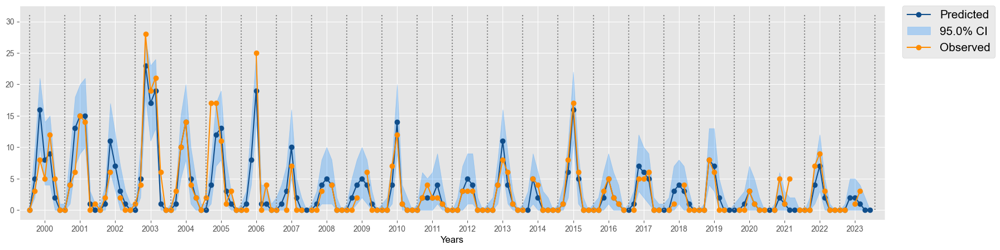

In [23]:
station_num_to_plot = 1 # Change this to plot a different station, -1 to plot manually
if station_num_to_plot != -1:
    xx = np.arange(24*7*(station_num_to_plot-1), 24*7*station_num_to_plot)
else:
    xx = np.arange(1000, 1200) # Change this for the range of the manual choice
plt.figure(figsize=(20, 5))
plt.plot(xx, y_pred180.loc[xx, 'pred180'], label='Predicted', linestyle='-', marker='o', color='#104E8B')
plt.fill_between(xx, y_pred180.loc[xx, f'{alpha/2}'], y_pred180.loc[xx, f'{(1-alpha/2)}'], alpha=0.3, label=f'{(1-alpha)*100}% CI', color='#1E90FF')
plt.plot(xx, Y180_data[xx], label='Observed', linestyle='-', marker='o', color='#FF8C00')
plt.xticks(xx[np.arange(3,len(xx),7)], np.arange(2000,2024), fontsize=10)
plt.yticks(fontsize=10)
plt.xlim(xx[0]-2, xx[-1]+3)
plt.xlabel('Years', fontsize='12', color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.vlines(xx[np.arange(0,len(xx),7)], ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.vlines(xx[-1]+1, ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.savefig('SIS_plots/biv_180_all_sensors_1.pdf', bbox_inches='tight')
plt.show()

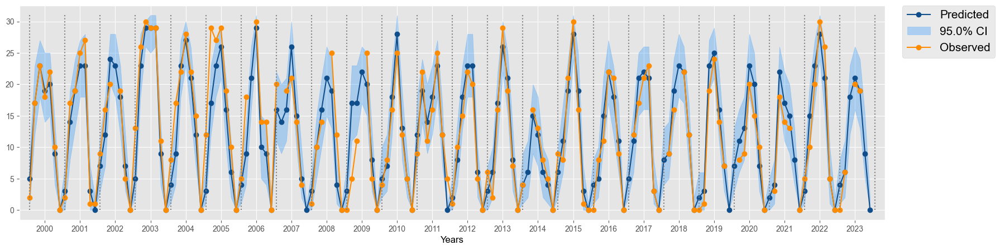

In [24]:
station_num_to_plot = 1 # Change this to plot a different station, -1 to plot manually
if station_num_to_plot != -1:
    xx = np.arange(24*7*(station_num_to_plot-1), 24*7*station_num_to_plot)
else:
    xx = np.arange(1000, 1200) # Change this for the range of the manual choice
plt.figure(figsize=(20, 5))
plt.plot(xx, y_pred120.loc[xx, 'pred120'], label='Predicted', linestyle='-', marker='o', color='#104E8B')
plt.fill_between(xx, y_pred120.loc[xx, f'{alpha/2}'], y_pred120.loc[xx, f'{(1-alpha/2)}'], alpha=0.3, label=f'{(1-alpha)*100}% CI', color='#1E90FF')
plt.plot(xx, Y120_data[xx], label='Observed', linestyle='-', marker='o', color='#FF8C00')
plt.xticks(xx[np.arange(3,len(xx),7)], np.arange(2000,2024), fontsize=10)
plt.yticks(fontsize=10)
plt.xlim(xx[0]-2, xx[-1]+3)
plt.xlabel('Years', fontsize='12', color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.vlines(xx[np.arange(0,len(xx),7)], ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.vlines(xx[-1]+1, ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.savefig('SIS_plots/biv_120_all_sensors_1.pdf', bbox_inches='tight')
plt.show()

In [13]:
mapping_dict

{5707: 1,
 5710: 2,
 5717: 3,
 5718: 4,
 5719: 5,
 5721: 6,
 5725: 7,
 5732: 8,
 5735: 9,
 5738: 10,
 5739: 11,
 5742: 12,
 5749: 13,
 5750: 14,
 5952: 15,
 5960: 16,
 6582: 17,
 6691: 18,
 6818: 19,
 6665: 20,
 6804: 21,
 6832: 22,
 6884: 23,
 6904: 24,
 9856: 25,
 9861: 26,
 9882: 27,
 9899: 28,
 9925: 29,
 9972: 30,
 9991: 31,
 9997: 32,
 10025: 33,
 10041: 34,
 10081: 35,
 10171: 36,
 10270: 37,
 10282: 38,
 10288: 39,
 5730: 40,
 10437: 41,
 10454: 42,
 10463: 43,
 10584: 44,
 12020: 45,
 17288: 46,
 17295: 47,
 17297: 48,
 20041: 49,
 20154: 50,
 30165: 51}

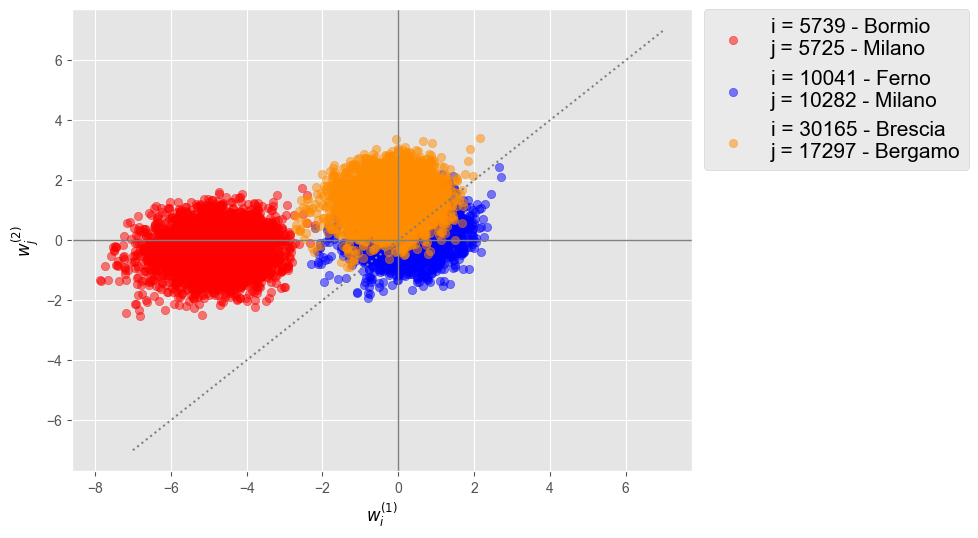

In [17]:
# scatterplot w_i^(180) vs w_j^(120)
w180_samples = post_pred.posterior_az.posterior['w180'].values
w120_samples = post_pred.posterior_az.posterior['w120'].values

w180_flat = w180_samples.reshape(-1, 51)  # shape (4000, 51)
w120_flat = w120_samples.reshape(-1, 51)  # shape (4000, 51)

plt.figure(figsize=(8, 6))
plt.scatter(w180_flat[:, 10], w120_flat[:, 6], alpha=0.5, color='red', label='i = 5739 - Bormio \nj = 5725 - Milano')
plt.scatter(w180_flat[:, 33], w120_flat[:, 37], alpha=0.5, color='blue', label='i = 10041 - Ferno \nj = 10282 - Milano')
plt.scatter(w180_flat[:, 50], w120_flat[:, 47], alpha=0.5, color='darkorange', label='i = 30165 - Brescia \nj = 17297 - Bergamo')
plt.plot([-7, 7], [-7, 7], color='gray', linestyle='dotted')
plt.axhline(0, color='gray',linewidth=1)  
plt.axvline(0, color='gray',linewidth=1)  
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.xlabel(r'$w_i^{(1)}$', fontsize='12', color='black')
plt.ylabel(r'$w_j^{(2)}$', fontsize='12', color='black')
plt.savefig('SIS_plots/biv_wi_wj.pdf', bbox_inches='tight')
plt.grid(True)
plt.show()

In [20]:
corr_bormio_milano = np.corrcoef(w180_flat[:, 10], w120_flat[:, 6])[0, 1]
corr_ferno_milano = np.corrcoef(w180_flat[:, 33], w120_flat[:, 37])[0, 1]
corr_monza_bergamo = np.corrcoef(w180_flat[:, 50], w120_flat[:, 47])[0, 1]

print(f"Correlazione Bormio-Milano: {corr_bormio_milano:.3f}")
print(f"Correlazione Ferno-Milano: {corr_ferno_milano:.3f}")
print(f"Correlazione Brescia-Bergamo: {corr_monza_bergamo:.3f}")

Correlazione Bormio-Milano: 0.094
Correlazione Ferno-Milano: 0.120
Correlazione Brescia-Bergamo: 0.120


In [19]:
data_combined = np.array([w180_flat[:, 10], w120_flat[:, 6], 
                          w180_flat[:, 33], w120_flat[:, 37], 
                          w180_flat[:, 50], w120_flat[:, 47]]).T  
correlation_matrix = np.corrcoef(data_combined, rowvar=False)
station_names = ['Bormio 180', 'Milano 120', 
                 'Ferno 180', 'Milano 120', 
                 'Brescia 180', 'Bergamo 120']
correlation_df = pd.DataFrame(correlation_matrix, index=station_names, columns=station_names)

print("Matrice di correlazione:")
print(correlation_df.to_string(index=True, header=True, justify='left', line_width=200))

Matrice di correlazione:
             Bormio 180  Milano 120  Ferno 180  Milano 120  Brescia 180  Bergamo 120
Bormio 180   1.000000    0.093771    0.825738   0.095325    0.815609     0.092727   
Milano 120   0.093771    1.000000    0.117620   0.993194    0.120778     0.991719   
Ferno 180    0.825738    0.117620    1.000000   0.119859    0.974959     0.117098   
Milano 120   0.095325    0.993194    0.119859   1.000000    0.122638     0.991272   
Brescia 180  0.815609    0.120778    0.974959   0.122638    1.000000     0.119986   
Bergamo 120  0.092727    0.991719    0.117098   0.991272    0.119986     1.000000   


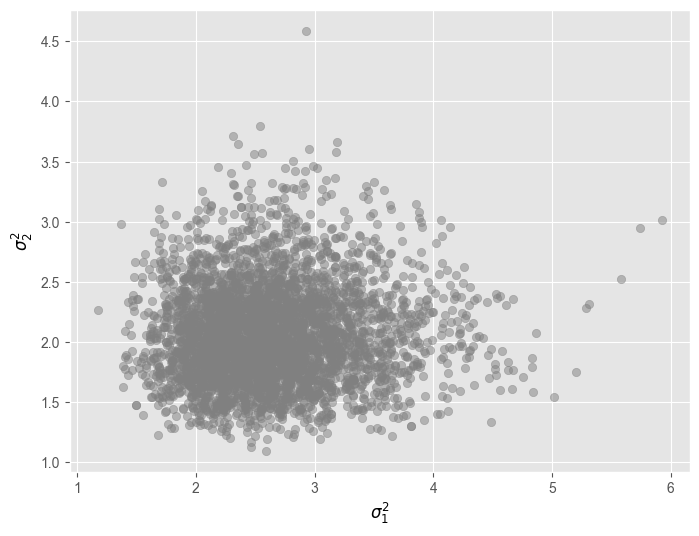

In [74]:
# scatterplot sigma180 vs sigma120
sigma180_samples = post_pred.posterior_az.posterior['sigma180'].values.flatten()
sigma120_samples = post_pred.posterior_az.posterior['sigma120'].values.flatten()

plt.figure(figsize=(8, 6))
plt.scatter(sigma180_samples, sigma120_samples, alpha=0.5, color='grey')
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.xlabel(r'$\sigma_{1}^2$', fontsize='12', color='black')
plt.ylabel(r'$\sigma_{2}^2$', fontsize='12', color='black')
plt.grid(True)
plt.savefig('SIS_plots/biv_sigma180_sigma120.pdf', bbox_inches='tight')
plt.show()

In [50]:
nicer_names = {
    'mean_temperature': 'Temperature',
    'mean_precipitation_sum': 'Precipitation Tot',
    'mean_precipitation_hours': 'Precipitation Hours',
    'mean_windspeed_10m_max': 'Wind Speed',
    'mean_radiation_sum': 'Solar Radiation',
}

In [51]:
covariates_or = ["mean_temperature", "mean_precipitation_sum", "mean_precipitation_hours", "mean_windspeed_10m_max", "mean_radiation_sum"]
covariates_idx = [X.columns.get_loc(cov) for cov in covariates_or]
betas_180 = posterior_bin_logit_var_bivariate.posterior['beta180'].stack(sample=("chain", "draw"))
betas_120 = posterior_bin_logit_var_bivariate.posterior['beta120'].stack(sample=("chain", "draw"))
betas_180 = betas_180[covariates_idx]
betas_120 = betas_120[covariates_idx]
covariates = [nicer_names[cov] for cov in covariates_or]
covariates = covariates[::-1]
betas_180 = betas_180[::-1]
betas_120 = betas_120[::-1]

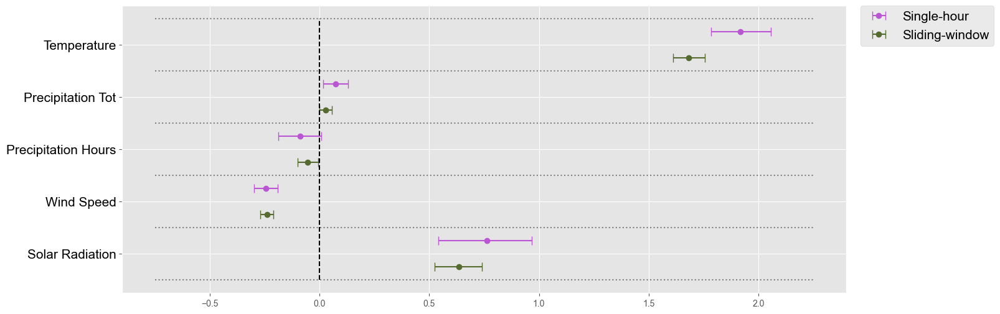

In [52]:
plt.figure(figsize=(15, 6))
plt.errorbar(betas_180.median(dim='sample'), np.arange(2, len(covariates)*4 - 1, 4), 
             xerr=[betas_180.median(dim='sample') - betas_180.quantile(0.025, dim='sample'), betas_180.quantile(0.975, dim='sample') - betas_180.median(dim='sample')], 
             fmt='o', label='Single-hour', capsize=5, color='#BA55D3')
plt.errorbar(betas_120.median(dim='sample'), np.arange(0, len(covariates)*4 - 3, 4), 
             xerr=[betas_120.median(dim='sample') - betas_120.quantile(0.025, dim='sample'), betas_120.quantile(0.975, dim='sample') - betas_120.median(dim='sample')], 
             fmt='o', label='Sliding-window', capsize=5, color='#556B2F')
plt.yticks(np.arange(1, len(covariates)*4 - 2, 4), covariates, fontsize=15, color='black')
plt.xticks(fontsize=10)
plt.hlines(np.arange(-1, len(covariates)*4, 4), xmin=-0.75, xmax=2.25, colors='gray', linestyles='dotted')
plt.vlines(0, ymin=-1, ymax=len(covariates)*4-1, colors='black', linestyles='--')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.savefig('SIS_plots/biv_beta_CI_all_sensors.pdf', bbox_inches='tight')
plt.show()

In [53]:
xi_180 = posterior_bin_logit_var_bivariate.posterior['xi180'].stack(sample=("chain", "draw"))
xi_120 = posterior_bin_logit_var_bivariate.posterior['xi120'].stack(sample=("chain", "draw"))
years_plot = np.arange(2000, 2024)

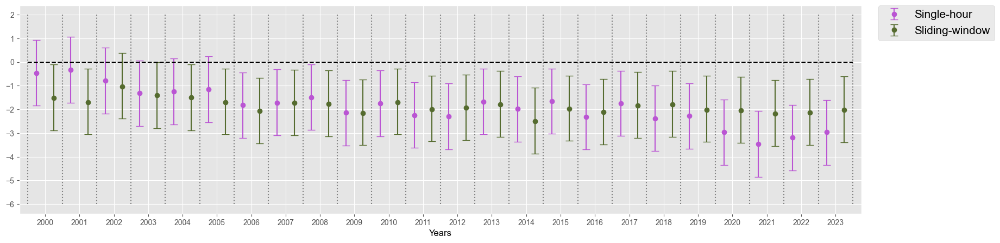

In [54]:
plt.figure(figsize=(20, 5))
plt.errorbar(np.arange(0, len(years_plot)*4 - 3, 4), xi_180.median(dim='sample'), 
             yerr=[xi_180.median(dim='sample') - xi_180.quantile(0.025, dim='sample'), xi_180.quantile(0.975, dim='sample') - xi_180.median(dim='sample')], 
             fmt='o', label='Single-hour', capsize=5, color='#BA55D3')
plt.errorbar(np.arange(2, len(years_plot)*4 - 1, 4), xi_120.median(dim='sample'), 
             yerr=[xi_120.median(dim='sample') - xi_120.quantile(0.025, dim='sample'), xi_120.quantile(0.975, dim='sample') - xi_120.median(dim='sample')], 
             fmt='o', label='Sliding-window', capsize=5, color='#556B2F')
plt.xticks(np.arange(1, len(years_plot)*4 - 2, 4), years_plot, fontsize=10)
plt.yticks(fontsize=10)
plt.vlines(np.arange(-1, len(years_plot)*4, 4), ymin=-6, ymax=2, colors='gray', linestyles='dotted')
plt.hlines(0, xmin=-1, xmax=len(years_plot)*4-1, colors='black', linestyles='--')
plt.xlim(-2, len(years_plot)*4)
plt.xlabel('Years', fontsize=12, color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.savefig('SIS_plots/biv_xi_CI_all_sensors.pdf', bbox_inches='tight')
plt.show()

In [55]:
gamma_180 = posterior_bin_logit_var_bivariate.posterior['gamma180'].stack(sample=("chain", "draw"))
gamma_120 = posterior_bin_logit_var_bivariate.posterior['gamma120'].stack(sample=("chain", "draw"))
months = ['April', 'May', 'June', 'July', 'August', 'September', 'October']

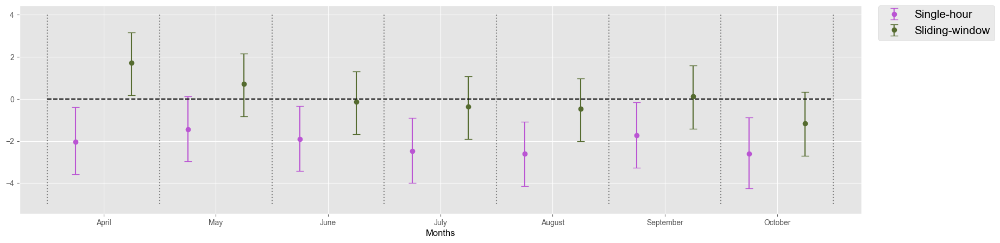

In [64]:
plt.figure(figsize=(20, 5))
plt.errorbar(np.arange(0, len(months)*4 - 3, 4), gamma_180.median(dim='sample'), 
             yerr=[gamma_180.median(dim='sample') - gamma_180.quantile(0.025, dim='sample'), gamma_180.quantile(0.975, dim='sample') - gamma_180.median(dim='sample')], 
             fmt='o', label='Single-hour', capsize=5, color='#BA55D3')
plt.errorbar(np.arange(2, len(months)*4 - 1, 4), gamma_120.median(dim='sample'), 
             yerr=[gamma_120.median(dim='sample') - gamma_120.quantile(0.025, dim='sample'), gamma_120.quantile(0.975, dim='sample') - gamma_120.median(dim='sample')], 
             fmt='o', label='Sliding-window', capsize=5, color='#556B2F')
plt.xticks(np.arange(1, len(months)*4 - 2, 4), months, fontsize=10)
plt.yticks(fontsize=10)
plt.vlines(np.arange(-1, len(months)*4, 4), ymin=-5, ymax=4, colors='gray', linestyles='dotted')
plt.hlines(0, xmin=-1, xmax=len(months)*4-1, colors='black', linestyles='--')
plt.xlim(-2, len(months)*4)
plt.xlabel('Months', fontsize=12, color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.savefig('SIS_plots/biv_gamma_CI_all_sensors.pdf', bbox_inches='tight')
plt.show()

In [58]:
w_180 = posterior_bin_logit_var_bivariate.posterior['w180'].stack(sample=("chain", "draw"))
w_120 = posterior_bin_logit_var_bivariate.posterior['w120'].stack(sample=("chain", "draw"))
stations_plot = np.concatenate((np.concatenate((stations_2000_2007, stations_2007_2012)), stations_2012_2023))

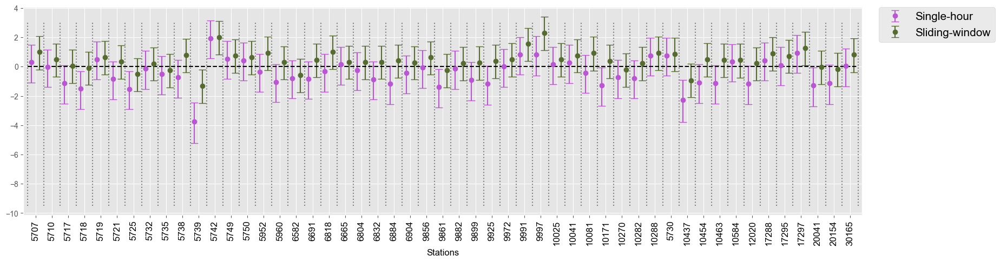

In [59]:
plt.figure(figsize=(20, 5))
plt.errorbar(np.arange(0, len(stations_plot)*4 - 3, 4), w_180.median(dim='sample'), 
             yerr=[w_180.median(dim='sample') - w_180.quantile(0.025, dim='sample'), w_180.quantile(0.975, dim='sample') - w_180.median(dim='sample')], 
             fmt='o', label='Single-hour', capsize=5, color='#BA55D3')
plt.errorbar(np.arange(2, len(stations_plot)*4 - 1, 4), w_120.median(dim='sample'), 
             yerr=[w_120.median(dim='sample') - w_120.quantile(0.025, dim='sample'), w_120.quantile(0.975, dim='sample') - w_120.median(dim='sample')], 
             fmt='o', label='Sliding-window', capsize=5, color='#556B2F')
plt.xticks(np.arange(1, len(stations_plot)*4 - 2, 4), stations_plot, fontsize=12, rotation=90, color='black')
plt.yticks(fontsize=10)
plt.vlines(np.arange(-1, len(stations_plot)*4, 4), ymin=-9.5, ymax=3, colors='gray', linestyles='dotted')
plt.hlines(0, xmin=-1, xmax=len(stations_plot)*4-1, colors='black', linestyles='--')
plt.xlim(-2, len(stations_plot)*4)
plt.xlabel('Stations', fontsize=12, color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.savefig('SIS_plots/biv_w_CI.pdf', bbox_inches='tight')
plt.show()

## We try to use just one vector w instead of two for the different thresholds

In [113]:
data_biv_all2 = {
    "N": len(Y_obs),
    "N_miss": len(Y_miss),

    "y180": Y_obs['Count_180'],
    "y120": Y_obs['Count_120'],
    "P": X_obs.shape[1],

    "nyears": 24,
    "nstations": 51,
    "nmonths": 7,

    "station": stations_obs,
    "year": years_obs,
    "max_month": max_month_obs,
    "station_miss": stations_miss,
    "year_miss": years_miss,
    "max_month_miss": max_month_miss,

    "X": X_obs,
    "X_miss": X_miss,

    "phi": phi1,
    "distances": distances,

    "month": months_obs,
    "month_miss": months_miss
}

In [114]:
model_biv_all_sensors2 = """ 
data {

  int<lower=0> N; // Number of observations
  int<lower=0> N_miss; // Number of missing observations
  int<lower=0> P; // Covariate number
  int<lower=0> nyears;
  int<lower=0> nstations;
  int <lower=0> nmonths;

  array[N] int<lower=0> station;
  array[N] int<lower=0> year;
  array[N] int<lower=0> max_month;
  array[N] int<lower=0> month;

  array[N_miss] int<lower=0> station_miss;
  array[N_miss] int<lower=0> year_miss;
  array[N_miss] int<lower=0> max_month_miss;
  array[N_miss] int<lower=0> month_miss;
  
  array[N] int<lower=0> y180; 
  array[N] int<lower=0> y120; 

  matrix[N, P] X; // Predictor matrix
  matrix[N_miss, P] X_miss; // Predictor matrix
  
  real phi;
  matrix[nstations, nstations] distances;
  
}

transformed data {

  matrix[nstations,nstations] H = exp(-(1/phi) * distances);  
}

parameters {

  vector[P] beta180; // indipendenti
  vector[P] beta120; // 

  vector[nyears] xi180; // indipendenti
  vector[nyears] xi120; // 
  real mu_xi;
  real<lower = 0> sigma2_xi;

  vector[nmonths] gamma180; // dipendenti
  vector[nmonths] gamma120; // 
  vector[2] mu_gamma;
  real<lower = 0> sigma2_gamma;
  real<lower=-1, upper=1> rho_gamma;

  vector[nstations] w;
  real<lower = 0> sigma;
  
}

transformed parameters {

  vector[N] alpha180;
  vector[N] alpha120;

  vector[N_miss] alpha_miss180;
  vector[N_miss] alpha_miss120;

  // Matrice covarianza per gamma
  matrix[2, 2] Sigma_gamma;
  Sigma_gamma[1, 1] = sigma2_gamma;
  Sigma_gamma[2, 2] = sigma2_gamma;
  Sigma_gamma[1, 2] = rho_gamma * sigma2_gamma;
  Sigma_gamma[2, 1] = rho_gamma * sigma2_gamma;

  // Matrice di covarianza per w
  cov_matrix[nstations] Sigma = sigma * H;
  
  alpha180 = X * beta180 + gamma180[month] + xi180[year] + w[station];
  alpha120 = X * beta120 + gamma120[month] + xi120[year] + w[station];

  alpha_miss180 = X_miss * beta180 + gamma180[month_miss] + xi180[year_miss] + w[station_miss];
  alpha_miss120 = X_miss * beta120 + gamma120[month_miss] + xi120[year_miss] + w[station_miss];
  
  matrix[nmonths,2] gamma_concat = append_col(gamma180, gamma120);

}

model {

  beta180 ~ normal(0, 1); 
  beta120 ~ normal(0, 1); 

  for (i in 1:N) {
    y180[i] ~ binomial_logit(max_month[i], alpha180[i]);
    y120[i] ~ binomial_logit(max_month[i], alpha120[i]);
  }

  mu_xi ~ normal(0, 1);
  sigma2_xi ~ inv_gamma(4,2);
  for (i in 1:nyears) {
    xi180[i] ~ normal(mu_xi, sqrt(sigma2_xi)); 
    xi120[i] ~ normal(mu_xi, sqrt(sigma2_xi)); 
  }
  
  mu_gamma ~ normal(0, 1);
  sigma2_gamma ~ inv_gamma(3,2);
  rho_gamma ~ normal(0, 1);
  for (i in 1:nmonths) {
    [gamma180[i], gamma120[i]] ~ multi_normal(mu_gamma, Sigma_gamma);
  }

  w ~ multi_normal_cholesky(rep_vector(0,nstations), cholesky_decompose(Sigma));
  sigma ~ inv_gamma(3,2);
  
}

generated quantities {

  vector[N] log_lik180;
  vector[N] log_lik120;

  vector[N] y_pred180;
  vector[N_miss] y_pred_miss180;

  vector[N] y_pred120;
  vector[N_miss] y_pred_miss120;

  for(i in 1:N) {
    log_lik180[i] = binomial_lpmf(y180[i]|max_month[i], inv_logit(alpha180[i]));
    log_lik120[i] = binomial_lpmf(y120[i]|max_month[i], inv_logit(alpha120[i]));
  }
  
  for(i in 1:N){
    y_pred180[i] = binomial_rng(max_month[i], inv_logit(alpha180[i]));
    y_pred120[i] = binomial_rng(max_month[i], inv_logit(alpha120[i]));
  }

  for(i in 1:N_miss){
    y_pred_miss180[i] = binomial_rng(max_month_miss[i], inv_logit(alpha_miss180[i]));
    y_pred_miss120[i] = binomial_rng(max_month_miss[i], inv_logit(alpha_miss120[i]));
  }
  
}
"""

In [115]:
# Write model to file
stan_file = "./stan/bivariate2_all_sensors_2000_23.stan"
with open(stan_file, "w") as f:
    print(model_biv_all_sensors2, file=f)

# Compile stan model
stan_model = CmdStanModel(stan_file=stan_file)

19:21:38 - cmdstanpy - INFO - compiling stan file /var/folders/h5/sljgddhd1clgfh2_bw619vb80000gn/T/tmpqr7vurn6/tmpjtkchi21.stan to exe file /Users/beo/Desktop/Statistical Learning/Tesi/Code/tesi/Modello/stan/bivariate2_all_sensors_2000_23
19:23:26 - cmdstanpy - INFO - compiled model executable: /Users/beo/Desktop/Statistical Learning/Tesi/Code/tesi/Modello/stan/bivariate2_all_sensors_2000_23


In [116]:
# Run the sampler
bin_logit_var_bivariate2 = stan_model.sample(data=data_biv_all2, chains=4, parallel_chains=4, 
                             iter_warmup=1000, iter_sampling=1000, seed=2024)

# Convert chain to arviz format
posterior_bin_logit_var_bivariate2 = az.from_cmdstanpy(bin_logit_var_bivariate2, log_likelihood={'log_lik180': 'log_lik180', 
                                                                                               'log_lik120': 'log_lik120'})

19:23:27 - cmdstanpy - INFO - CmdStan start processing


chain 1 |          | 00:00 Status

chain 2 |          | 00:00 Status

chain 3 |          | 00:00 Status

chain 4 |          | 00:00 Status

20:18:08 - cmdstanpy - INFO - CmdStan done processing.
20:18:08 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: tmpjtkchi21_model_namespace::log_prob: Sigma is not symmetric. Sigma[1,2] = inf, but Sigma[2,1] = inf (in 'bivariate2_all_sensors_2000_23.stan', line 74, column 2 to column 42)
	Exception: tmpjtkchi21_model_namespace::log_prob: Sigma is not symmetric. Sigma[1,2] = inf, but Sigma[2,1] = inf (in 'bivariate2_all_sensors_2000_23.stan', line 74, column 2 to column 42)
Exception: tmpjtkchi21_model_namespace::log_prob: Sigma is not symmetric. Sigma[1,2] = inf, but Sigma[2,1] = inf (in 'bivariate2_all_sensors_2000_23.stan', line 74, column 2 to column 42)
Exception: tmpjtkchi21_model_namespace::log_prob: Sigma is not symmetric. Sigma[1,2] = inf, but Sigma[2,1] = inf (in 'bivariate2_all_sensors_2000_23.stan', line 74, column 2 to column 42)
Exception: tmpjtkchi21_model_namespace::log_prob: Sigma is not symmetric. Sigma[1,2] = inf, but Sigma[2,1] = inf (in 'bivariat

20:18:17 - cmdstanpy - WARNING - Some chains may have failed to converge.
	Chain 1 had 12 iterations at max treedepth (1.2%)
	Chain 2 had 22 iterations at max treedepth (2.2%)
	Chain 3 had 14 iterations at max treedepth (1.4%)
	Chain 4 had 24 iterations at max treedepth (2.4%)
	Use the "diagnose()" method on the CmdStanMCMC object to see further information.


In [117]:
post_pred2 = PostPredBivariate(posterior_bin_logit_var_bivariate2, Y['Count_180'], Y['Count_120'], test_train=True, idx_test=idx_test)
Y180_data = post_pred2.Y180
Y120_data = post_pred2.Y120
post_pred2.posterior_az

Inference data with groups:
	> posterior
	> log_likelihood
	> sample_stats

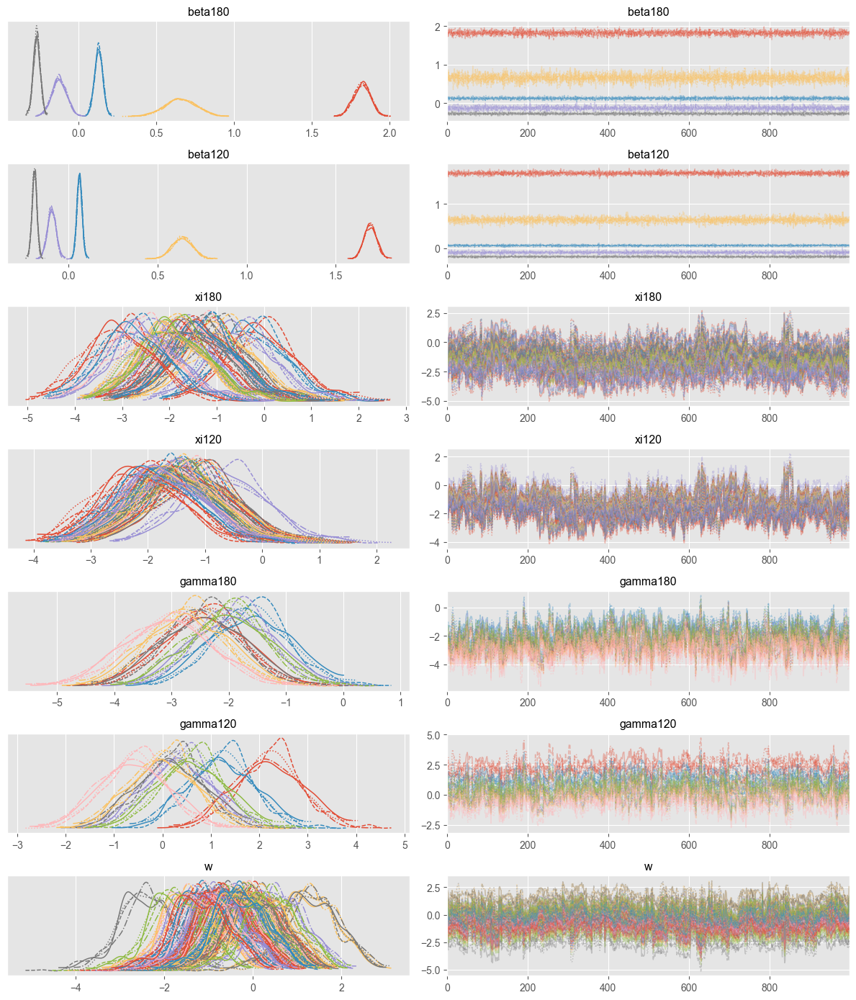

In [119]:
az.plot_trace(post_pred2.posterior_az, var_names = ['beta180', 'beta120', 'xi180', 'xi120', 'gamma180', 'gamma120', 'w'])
plt.tight_layout()
plt.savefig('SIS_plots/biv_chain_all_sensors_3.pdf', bbox_inches='tight')
plt.show()

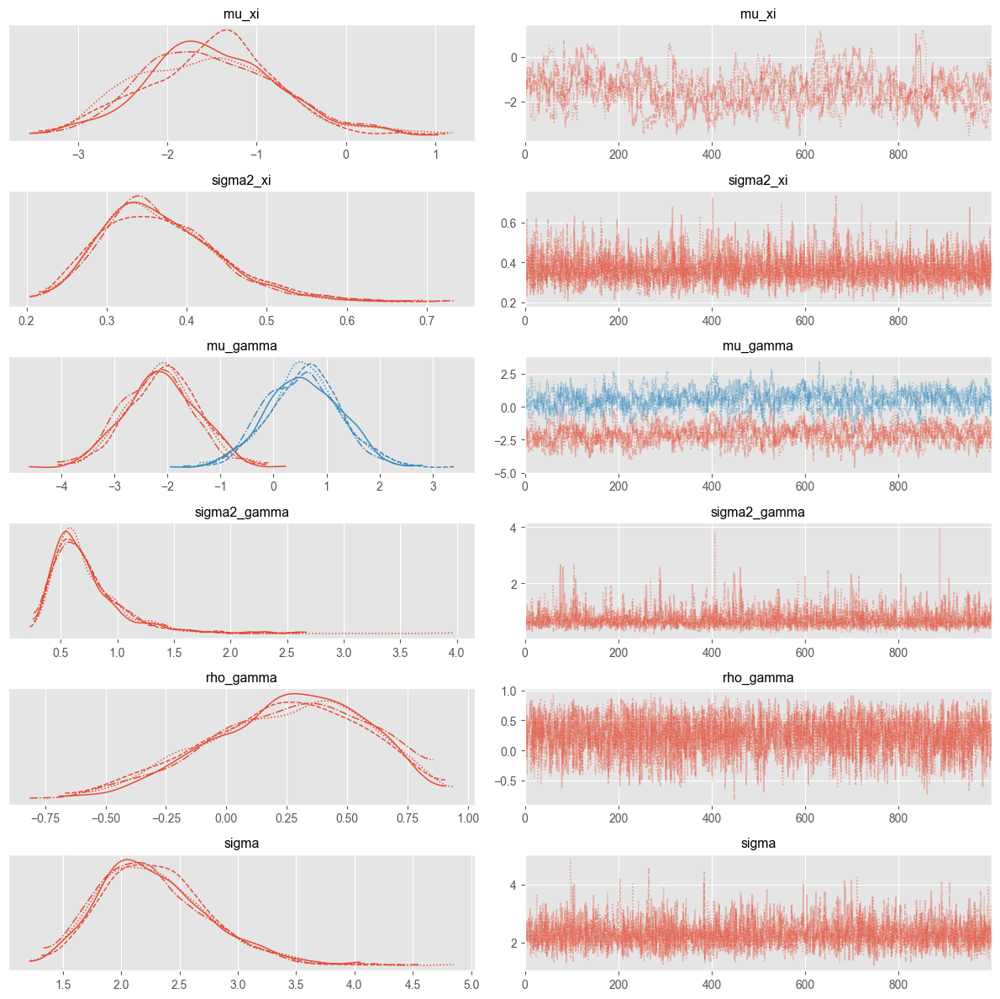

In [126]:
az.plot_trace(post_pred2.posterior_az, var_names = ['mu_xi', 'sigma2_xi', 'mu_gamma', 'sigma2_gamma', 'rho_gamma', 'sigma'])
plt.tight_layout()
plt.savefig('SIS_plots/biv_chain_all_sensors_4.pdf', bbox_inches='tight')
plt.show()

In [121]:
waic_out180 = az.waic(post_pred2.posterior_az, var_name='log_lik180')
loo_out180 = az.loo(post_pred2.posterior_az, var_name='log_lik180')
waic180 = waic_out180.elpd_waic
loo180 = loo_out180.elpd_loo
print(waic_out180)
print(loo_out180)

/usr/local/lib/python3.10/site-packages/arviz/stats/stats.py:1647: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(


Computed from 4000 posterior samples and 4124 observations log-likelihood matrix.

          Estimate       SE
elpd_waic -5161.12   112.78
p_waic      115.68        -

There has been a warning during the calculation. Please check the results.
Computed from 4000 posterior samples and 4124 observations log-likelihood matrix.

         Estimate       SE
elpd_loo -5161.56   112.81
p_loo      116.11        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.70]   (good)     4124  100.0%
   (0.70, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%



In [122]:
waic_out120 = az.waic(post_pred2.posterior_az, var_name='log_lik120')
loo_out120 = az.loo(post_pred2.posterior_az, var_name='log_lik120')
waic120 = waic_out120.elpd_waic
loo120 = loo_out120.elpd_loo
print(waic_out120)
print(loo_out120)

/usr/local/lib/python3.10/site-packages/arviz/stats/stats.py:1647: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(


Computed from 4000 posterior samples and 4124 observations log-likelihood matrix.

          Estimate       SE
elpd_waic -11494.87   173.64
p_waic      233.06        -

There has been a warning during the calculation. Please check the results.
Computed from 4000 posterior samples and 4124 observations log-likelihood matrix.

         Estimate       SE
elpd_loo -11495.16   173.64
p_loo      233.36        -
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.70]   (good)     4124  100.0%
   (0.70, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    0    0.0%



In [123]:
alpha = 0.05
(y_pred180, y_pred120), (metrics180, metrics120) = post_pred2.predict(CI=True,
                                                                 alpha = alpha,
                                                                 error_metrics = True)

In [124]:
y_obs, residuals, mse, mae, mad, rmse, mse_test, mae_test, mad_test, rmse_test, outliers_test, percentage_inside_CI_test, outliers, percentage_inside = metrics180.values()
print(f'Metrics for 180 Threshold\n')

print(f'The total number of outliers is: {len(outliers)}\n')
print(f'The total number of outliers in the test set is: {len(outliers_test)}\n')
print(f'The MSE is: {mse}\n')
print(f'The MAE is: {mae}\n')
print(f'The MAD is: {mad}\n')
print(f'The RMSE is: {rmse}\n')

print(f'The MSE in the test set is: {mse_test}\n')
print(f'The MAE in the test set is: {mae_test}\n')
print(f'The MAD in the test set is: {mad_test}\n')
print(f'The RMSE in the test set is: {rmse_test}\n')

print(f'The percentage of observations inside the CI is: {percentage_inside}\n')
print(f'The percentage of observations inside the CI of the test is: {percentage_inside_CI_test}\n')

Metrics for 180 Threshold

The total number of outliers is: 324

The total number of outliers in the test set is: 99

The MSE is: 3.4228908504498388

The MAE is: 0.947462230521134

The MAD is: 0.0

The RMSE is: 1.8501056322409914

The MSE in the test set is: 3.3730899830220715

The MAE in the test set is: 0.9442558007923033

The MAD in the test set is: 0.0

The RMSE in the test set is: 1.8365973927407366

The percentage of observations inside the CI is: 0.945000848752334

The percentage of observations inside the CI of the test is: 0.9439728353140917



In [125]:
y_obs, residuals, mse, mae, mad, rmse, mse_test, mae_test, mad_test, rmse_test, outliers_test, percentage_inside_CI_test, outliers, percentage_inside = metrics120.values()
print(f'Metrics for 120 Threshold\n')

print(f'The total number of outliers is: {len(outliers)}\n')
print(f'The total number of outliers in the test set is: {len(outliers_test)}\n')
print(f'The MSE is: {mse}\n')
print(f'The MAE is: {mae}\n')
print(f'The MAD is: {mad}\n')
print(f'The RMSE is: {rmse}\n')

print(f'The MSE in the test set is: {mse_test}\n')
print(f'The MAE in the test set is: {mae_test}\n')
print(f'The MAD in the test set is: {mad_test}\n')
print(f'The RMSE in the test set is: {rmse_test}\n')

print(f'The percentage of observations inside the CI is: {percentage_inside}\n')
print(f'The percentage of observations inside the CI of the test is: {percentage_inside_CI_test}\n')

Metrics for 120 Threshold

The total number of outliers is: 946

The total number of outliers in the test set is: 307

The MSE is: 14.015447292480054

The MAE is: 2.6063486674588354

The MAD is: 2.0

The RMSE is: 3.7437210489671977

The MSE in the test set is: 15.156196943972835

The MAE in the test set is: 2.6932654216185625

The MAD in the test set is: 2.0

The RMSE in the test set is: 3.89309606148793

The percentage of observations inside the CI is: 0.8394160583941606

The percentage of observations inside the CI of the test is: 0.8262591963780419



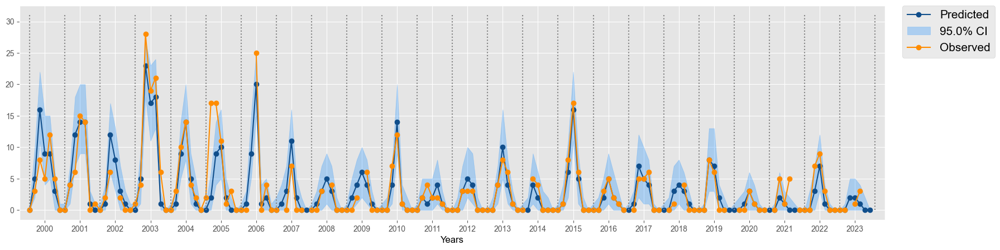

In [22]:
station_num_to_plot = 1 # Change this to plot a different station, -1 to plot manually
if station_num_to_plot != -1:
    xx = np.arange(24*7*(station_num_to_plot-1), 24*7*station_num_to_plot)
else:
    xx = np.arange(1000, 1200) # Change this for the range of the manual choice
plt.figure(figsize=(20, 5))
plt.plot(xx, y_pred180.loc[xx, 'pred180'], label='Predicted', linestyle='-', marker='o', color='#104E8B')
plt.fill_between(xx, y_pred180.loc[xx, f'{alpha/2}'], y_pred180.loc[xx, f'{(1-alpha/2)}'], alpha=0.3, label=f'{(1-alpha)*100}% CI', color='#1E90FF')
plt.plot(xx, Y180_data[xx], label='Observed', linestyle='-', marker='o', color='#FF8C00')
plt.xticks(xx[np.arange(3,len(xx),7)], np.arange(2000,2024), fontsize=10)
plt.yticks(fontsize=10)
plt.xlim(xx[0]-2, xx[-1]+3)
plt.xlabel('Years', fontsize='12', color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.vlines(xx[np.arange(0,len(xx),7)], ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.vlines(xx[-1]+1, ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.savefig('SIS_plots/biv_180_all_sensors_1.pdf', bbox_inches='tight')
plt.show()

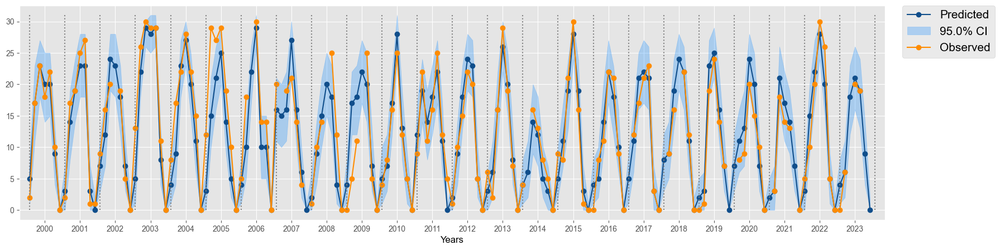

In [23]:
station_num_to_plot = 1 # Change this to plot a different station, -1 to plot manually
if station_num_to_plot != -1:
    xx = np.arange(24*7*(station_num_to_plot-1), 24*7*station_num_to_plot)
else:
    xx = np.arange(1000, 1200) # Change this for the range of the manual choice
plt.figure(figsize=(20, 5))
plt.plot(xx, y_pred120.loc[xx, 'pred120'], label='Predicted', linestyle='-', marker='o', color='#104E8B')
plt.fill_between(xx, y_pred120.loc[xx, f'{alpha/2}'], y_pred120.loc[xx, f'{(1-alpha/2)}'], alpha=0.3, label=f'{(1-alpha)*100}% CI', color='#1E90FF')
plt.plot(xx, Y120_data[xx], label='Observed', linestyle='-', marker='o', color='#FF8C00')
plt.xticks(xx[np.arange(3,len(xx),7)], np.arange(2000,2024), fontsize=10)
plt.yticks(fontsize=10)
plt.xlim(xx[0]-2, xx[-1]+3)
plt.xlabel('Years', fontsize='12', color='black')
plt.legend(fontsize=15, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0.)
plt.vlines(xx[np.arange(0,len(xx),7)], ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.vlines(xx[-1]+1, ymin=0, ymax=31, colors='gray', linestyles='dotted')
plt.savefig('SIS_plots/biv_120_all_sensors_1.pdf', bbox_inches='tight')
plt.show()